In [40]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tf_util.systems import system_from_str
from train_dsn import train_dsn
import seaborn as sns
import pandas as pd

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [41]:
system_D = 2;
system_str = 'linear_%dD' % system_D;

behavior_str = 'oscillation';

system_class = system_from_str(system_str);
system = system_class(behavior_str);
print(system.name)

linear_2D


In [42]:
# create test parameter grid

start = -100.0;
stop = 100.0;
res = 50;
vals = np.arange(start, stop, res);
num_pts = vals.shape[0];

total_pts = num_pts**4;
params = np.zeros((total_pts,4));
T_a_valid = np.zeros((total_pts, 6));
ind = 0;
for i in range(num_pts):
    a1 = vals[i];
    for j in range(num_pts):
        a2 = vals[j];
        for k in range(num_pts):
            a3 = vals[k];
            for l in range(num_pts):
                a4 = vals[l];
                params[ind,:] = np.array([a1, a2, a3, a4]);
                if ((a1 + a4)**2 >= 4*(a1*a4 + a2*a3)):
                    lambda_1_real = 0.5*((a1+a4) + np.sqrt((a1 + a4)**2 - 4*(a1*a4 + a2*a3)));
                    lambda_2_real = 0.5*((a1+a4) - np.sqrt((a1 + a4)**2 - 4*(a1*a4 + a2*a3)));
                    lambda_1_imag = 0.0;
                else:
                    if ((a1 + a4) == 0):
                        lambda_1_real = 0.0;
                        lambda_2_real = 0.0;
                        lambda_1_imag = np.sqrt(a1*a4 + a2*a3);
                    else:
                        lambda_1_real = (a1+a4)/2.0;
                        lambda_2_real = (a1+a4)/2.0;
                        lambda_1_imag = np.sqrt(4*(a1*a4 + a2*a3) - (a1 + a4)**2)/2.0;
                T_a_valid[ind,:] = np.array([lambda_1_real, np.square(lambda_1_real), \
                                             lambda_2_real, np.square(lambda_2_real), \
                                             lambda_1_imag, np.square(lambda_1_imag)]);
                if (np.count_nonzero(np.isnan(T_a_valid[ind,:])) > 0):
                    print('found nans');
                    print(a1,a2,a3,a4);
                    print(T_a_valid[ind,:])
                ind += 1;


print(np.count_nonzero(np.isnan(T_a_valid)));
print(np.count_nonzero(np.isinf(T_a_valid)));

0
0


In [43]:
num_params = system.D;
K = 1;
M = total_pts;
phi = tf.placeholder(dtype=tf.float64, shape=(K, M, num_params, 1));

T_a = system.analytic_suff_stats(phi);

_phi = np.expand_dims(np.expand_dims(params, 0), 3);

phi (1, 256, 4, 1)


In [44]:
with tf.Session() as sess:
    _T_a = sess.run(T_a, {phi:_phi});

print(np.count_nonzero(np.isnan(_T_a)), 'nans');
print(np.count_nonzero(np.isinf(_T_a)), 'infs');

error = np.sum(np.square(_T_a - T_a_valid));

print('error:', error);

0 nans
0 infs
error: 236908146045200.0


In [45]:
# behavioral constraints
mu = np.array([0.0, 0.0, 2*np.pi*10.0]);
Sigma = np.array([.001, .001, 0.1]);

behavior = {'mu':mu, 'Sigma':Sigma};


c_init 100.0
results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
0 <tf_util.flows.PlanarFlowLayer object at 0x17b55dac8>
1 <tf_util.flows.PlanarFlowLayer object at 0x17b55df60>
2 <tf_util.flows.PlanarFlowLayer object at 0x17b55dd30>
3 <tf_util.flows.PlanarFlowLayer object at 0x17b55d198>
4 <tf_util.flows.PlanarFlowLayer object at 0x17b55d320>
5 <tf_util.flows.PlanarFlowLayer object at 0x17b55d5f8>
6 <tf_util.flows.PlanarFlowLayer object at 0x17b55d898>
7 <tf_util.flows.PlanarFlowLayer object at 0x17b55d550>
8 <tf_util.flows.PlanarFlowLayer object at 0x17b55db00>
9 <tf_util.flows.PlanarFlowLayer object at 0x17b55d438>
Tensor("Const_20:0", shape=(4, 1), dtype=float64)
Tensor("Const_21:0", shape=(1, 1), dtype=float64)
Tensor("Const_22:0", shape=(4, 1), dtype=float64)
Tensor("Const_23:0", shape=(1, 1), dtype=float64)
Tensor("Const_24:0", shape=(4, 1), dtype=float64)
Tensor("Const_25:0", shape=(1, 1), dtype=float64)
Tensor("Const_26:0", shape=(4, 1), dtype=float64)
Tensor("Const_27

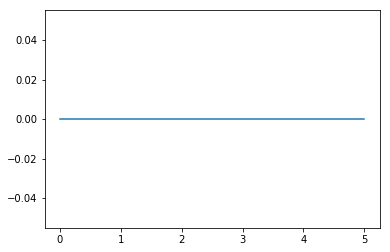

<Figure size 432x288 with 0 Axes>

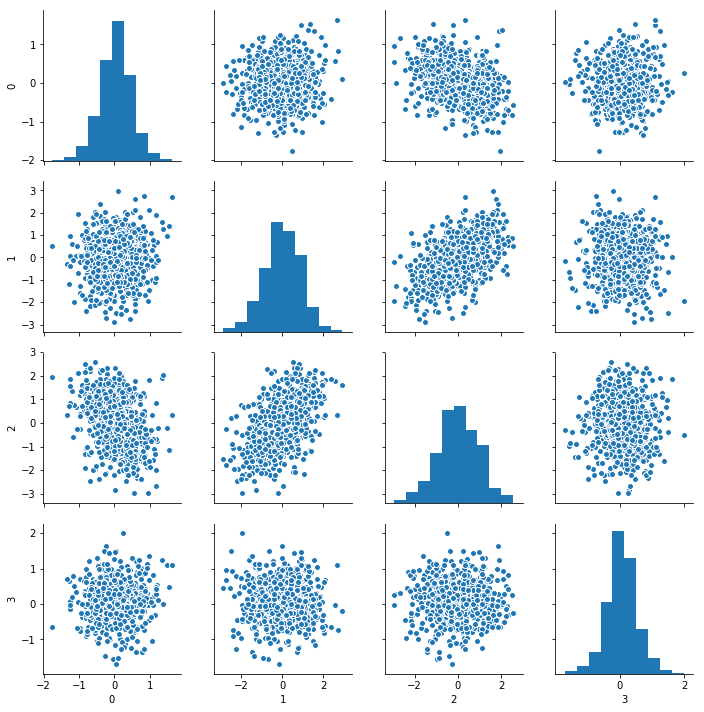

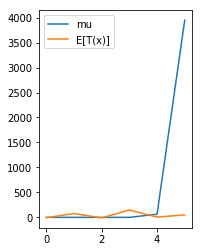

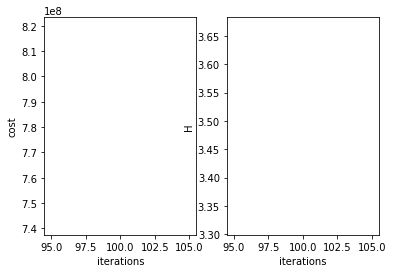

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 200 
H 3.8496077636453245
cost 629327668.0755616


<Figure size 432x288 with 0 Axes>

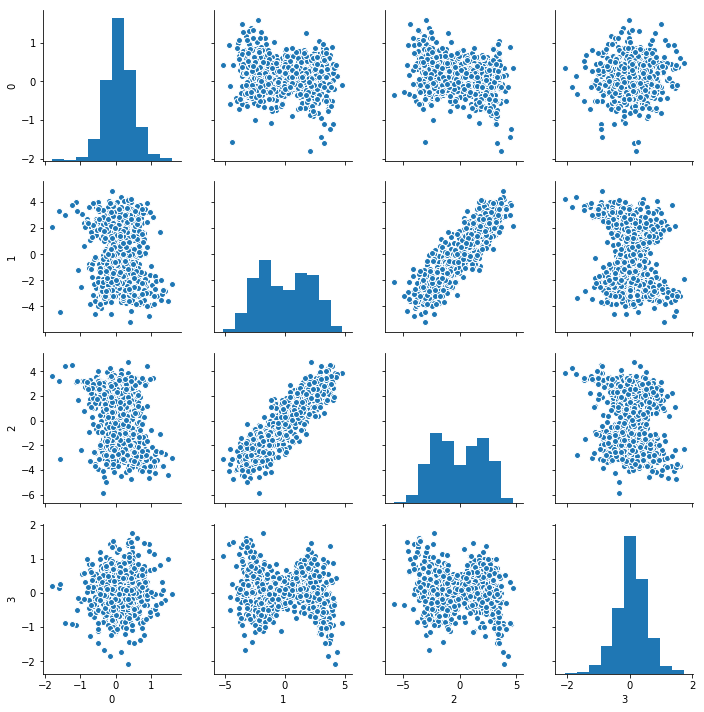

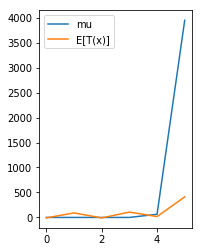

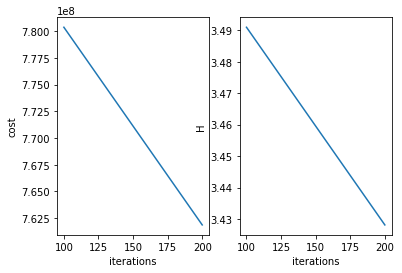

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 300 
H 4.58737087067691
cost 239943318.01248872


<Figure size 432x288 with 0 Axes>

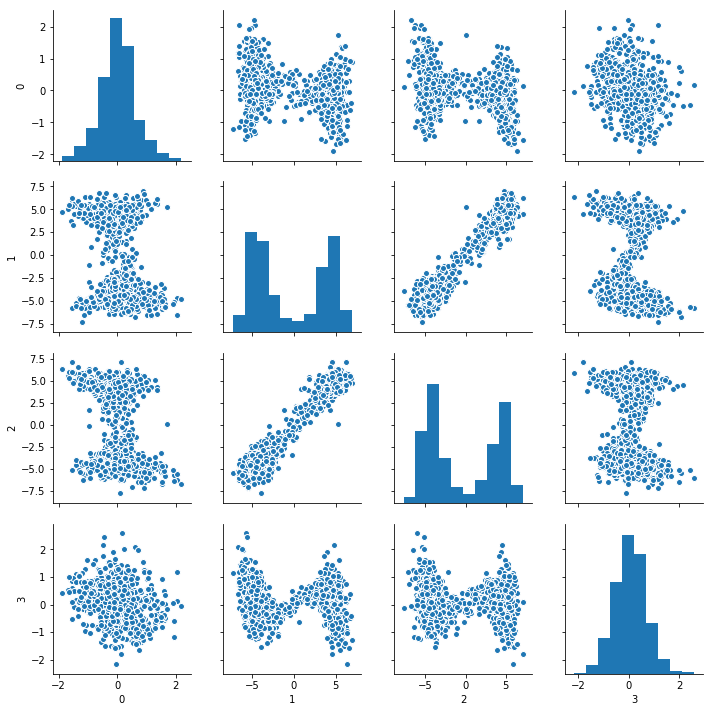

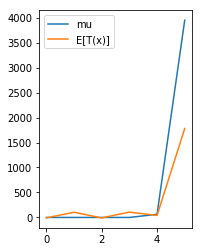

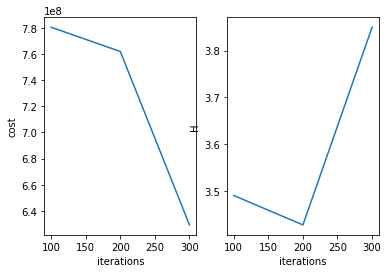

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 400 
H 4.936119240524735
cost 25790305.259250417


<Figure size 432x288 with 0 Axes>

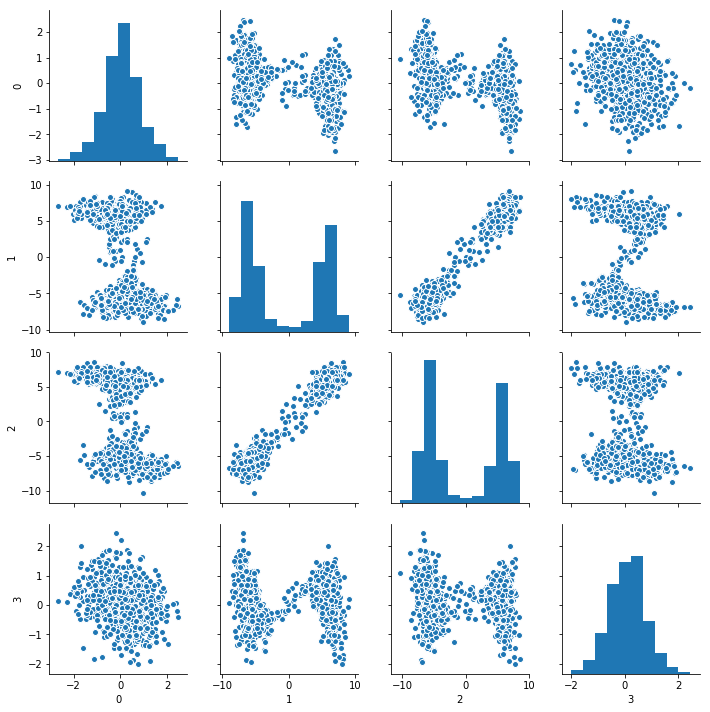

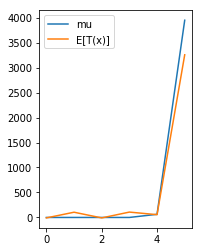

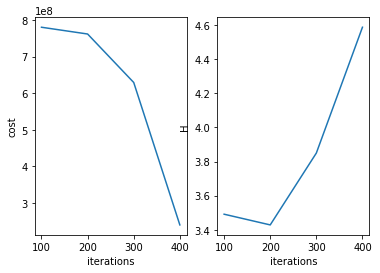

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 500 
H 5.013415081411894
cost 1496648.7090649514


<Figure size 432x288 with 0 Axes>

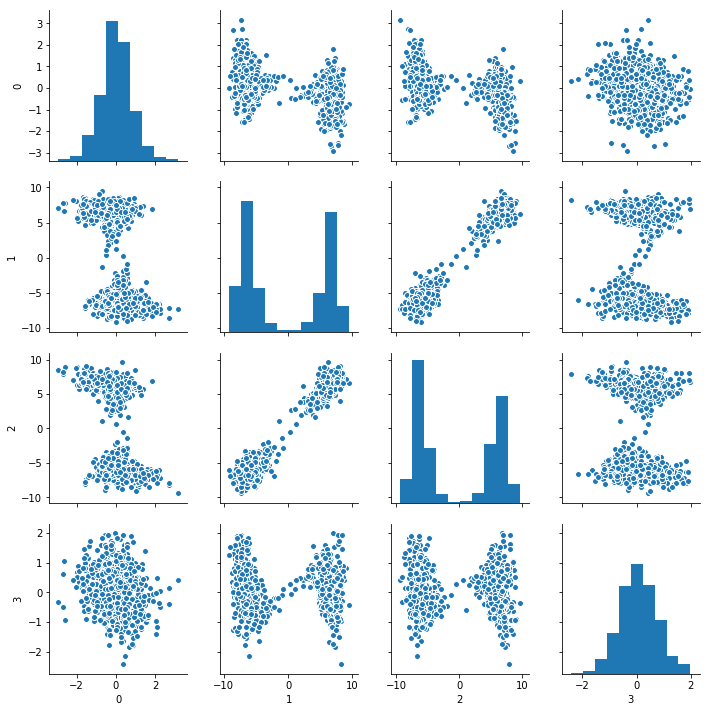

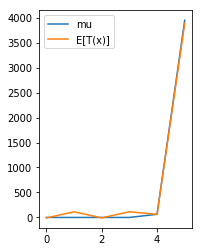

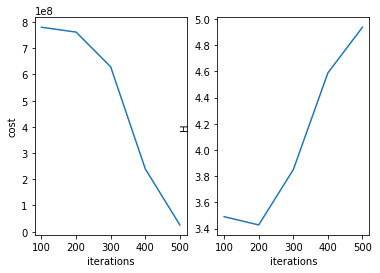

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 600 
H 4.987049796216764
cost 1346939.8550683176


<Figure size 432x288 with 0 Axes>

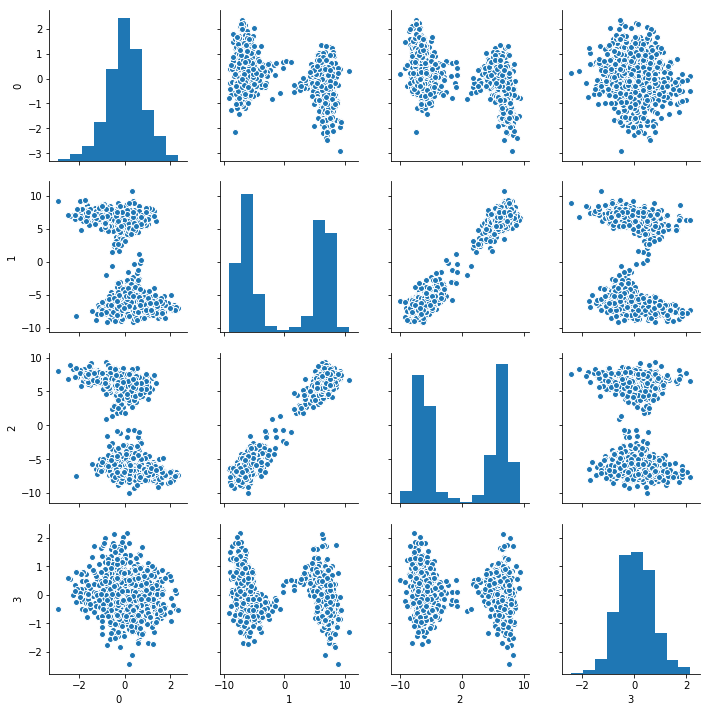

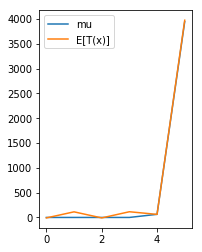

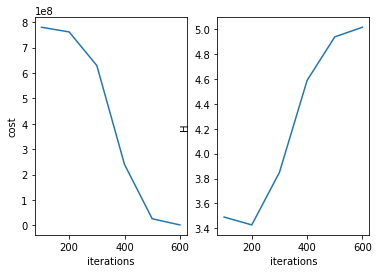

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 700 
H 4.914165294212427
cost 1342552.2058079184


<Figure size 432x288 with 0 Axes>

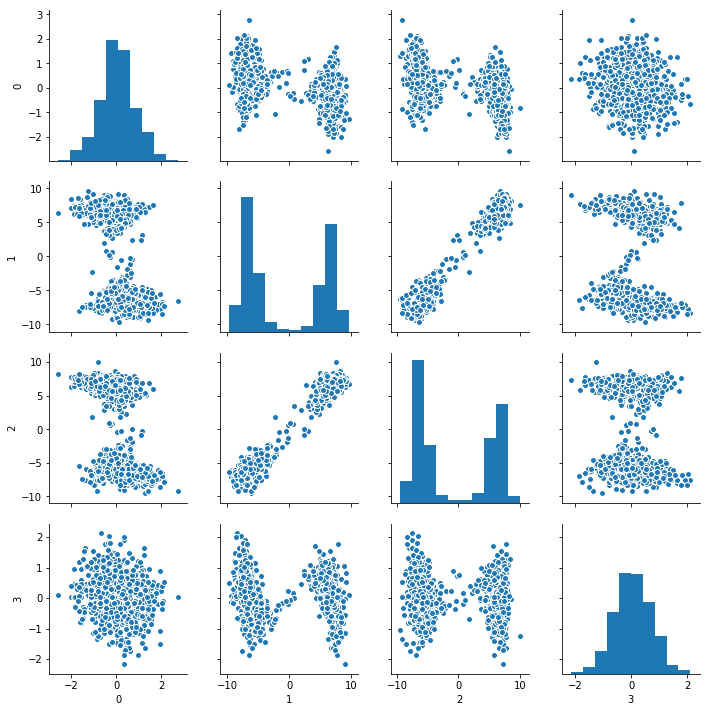

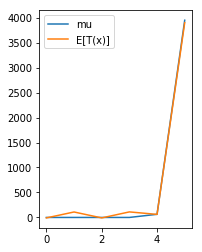

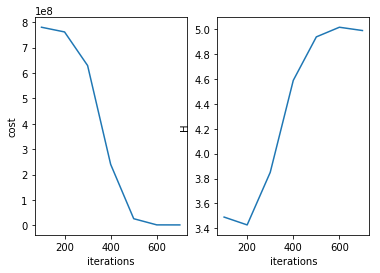

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 800 
H 5.011188968597277
cost 1113260.7561442624


<Figure size 432x288 with 0 Axes>

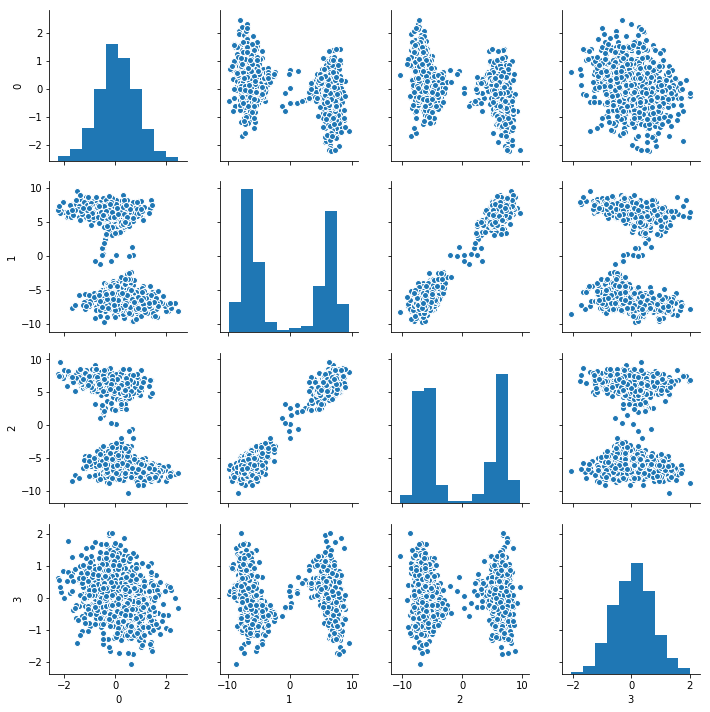

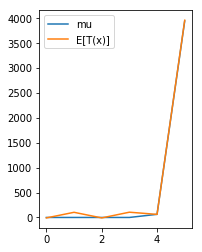

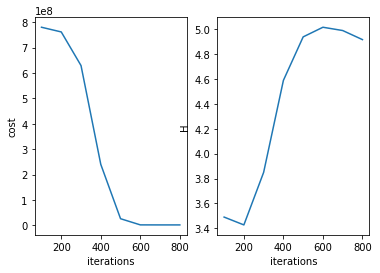

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 900 
H 5.0865161234412435
cost 1177766.6224590885


<Figure size 432x288 with 0 Axes>

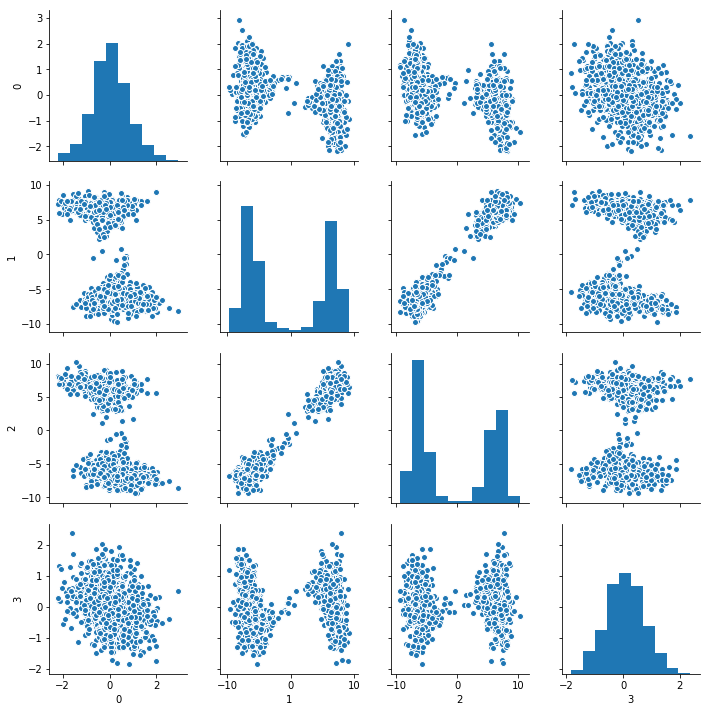

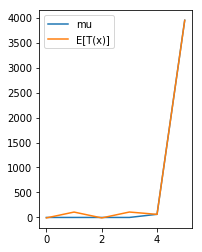

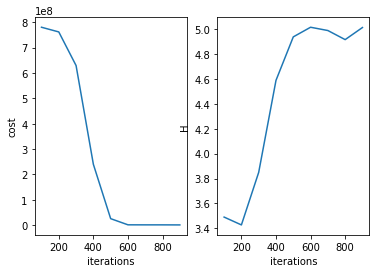

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1000 
H 4.969790158647258
cost 1291337.9665846664


<Figure size 432x288 with 0 Axes>

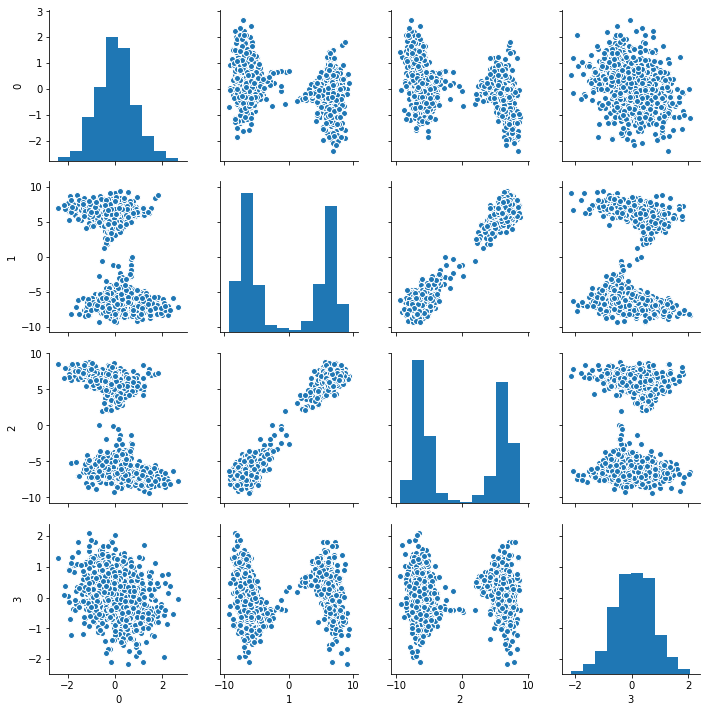

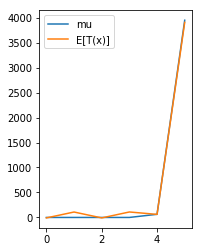

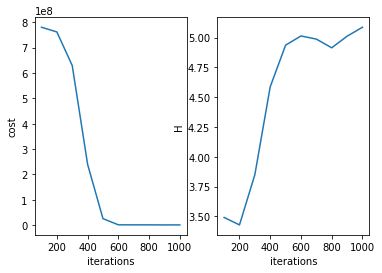

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 2
resetting optimizer
aug lag it 1
lambda [   -591.86412599    6633.38630401   -1447.51008884   24064.22128501
   -6182.09428706 -394195.51848159]
c 1000.0
saving model at iter 0
Doubling memory allocation for parameter logging.
******************************************
it = 1100 
H 5.062956655341448
cost -9397761.870930972


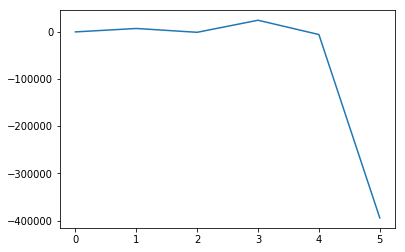

<Figure size 432x288 with 0 Axes>

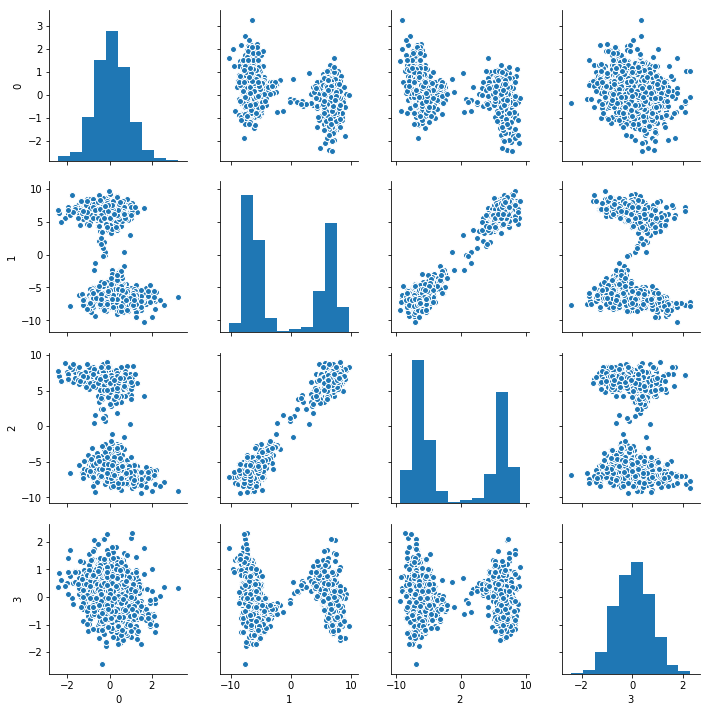

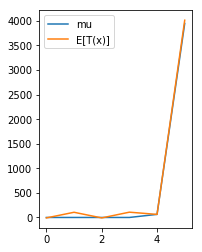

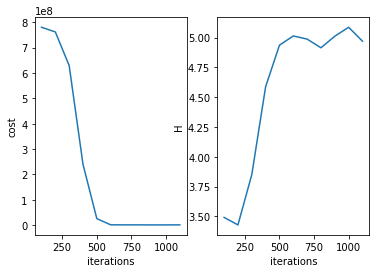

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1200 
H 4.955506497768471
cost 10161904.463482173


<Figure size 432x288 with 0 Axes>

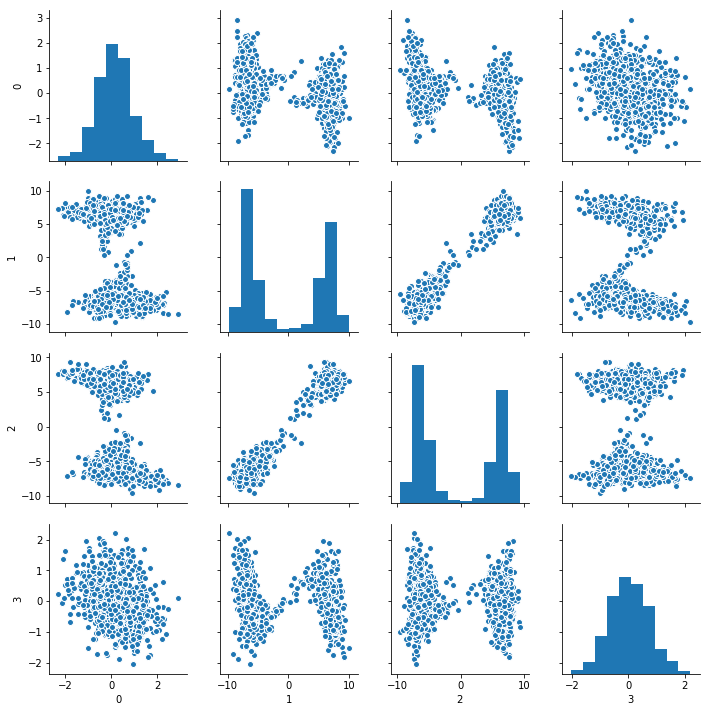

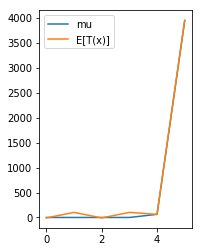

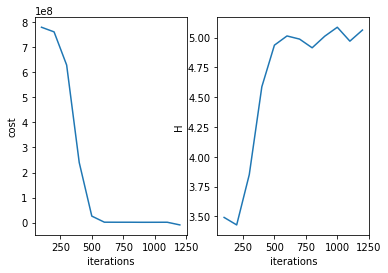

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1300 
H 4.937312577348743
cost 24452410.706424765


<Figure size 432x288 with 0 Axes>

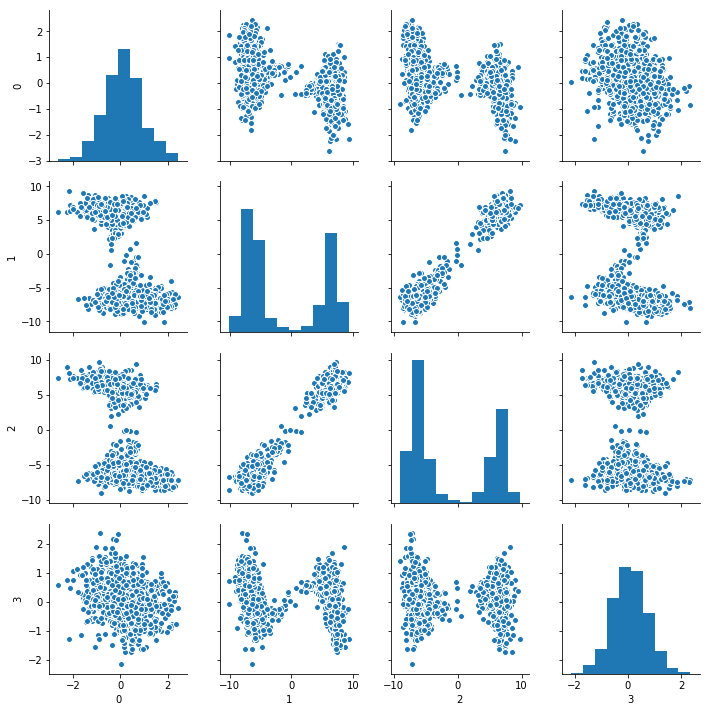

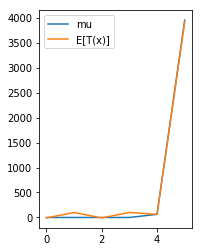

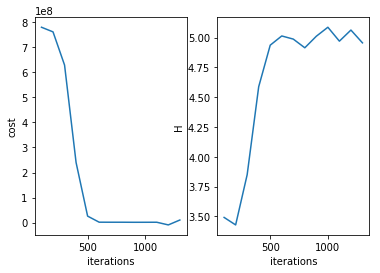

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1400 
H 4.994586994455047
cost 16900338.297387917


<Figure size 432x288 with 0 Axes>

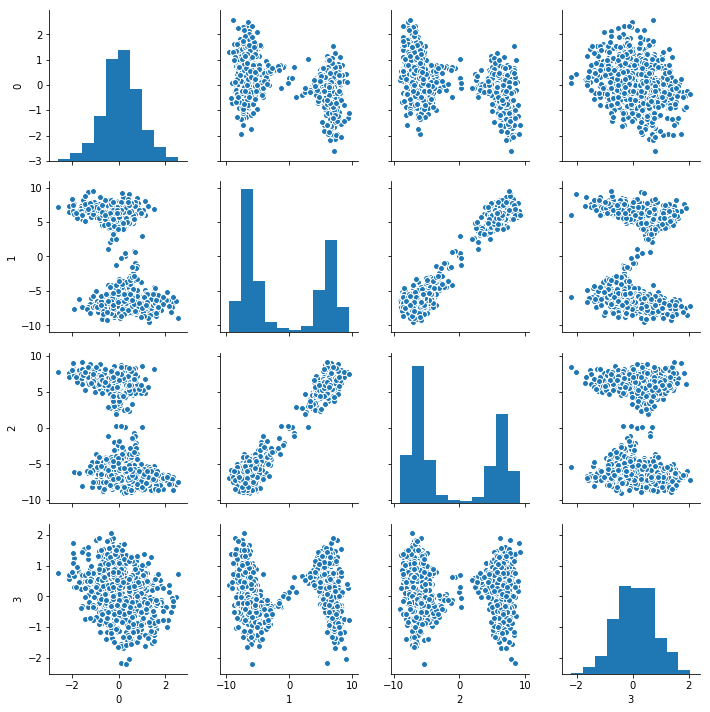

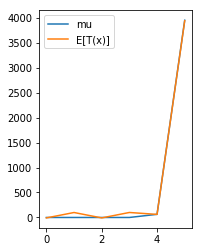

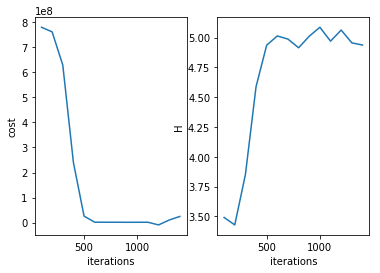

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1500 
H 4.987451941091523
cost 16642560.56427457


<Figure size 432x288 with 0 Axes>

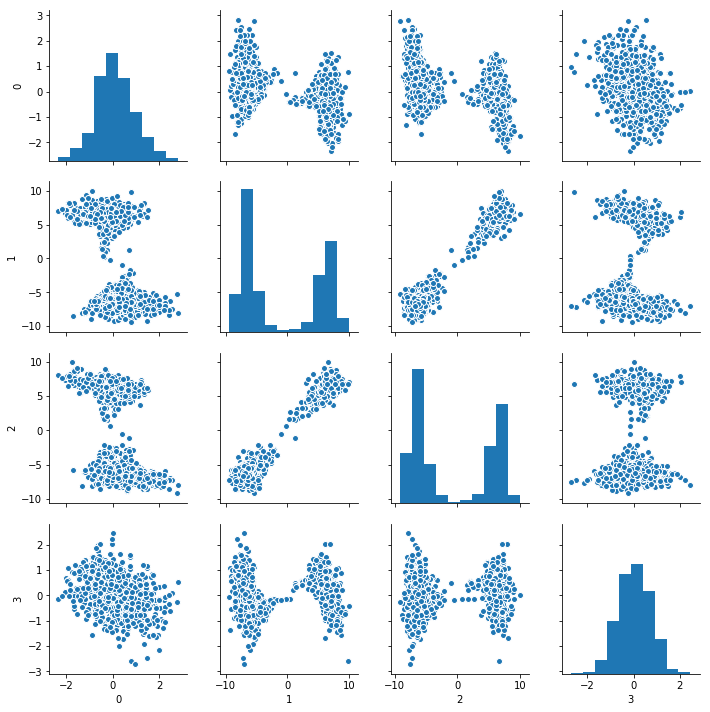

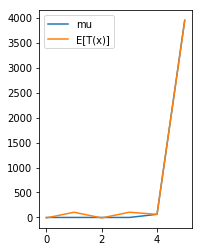

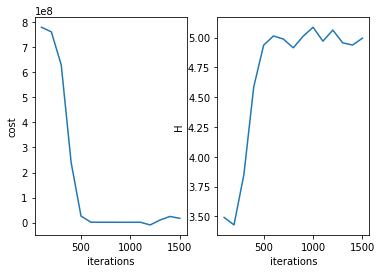

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1600 
H 4.908914341098555
cost 3676658.9140026746


<Figure size 432x288 with 0 Axes>

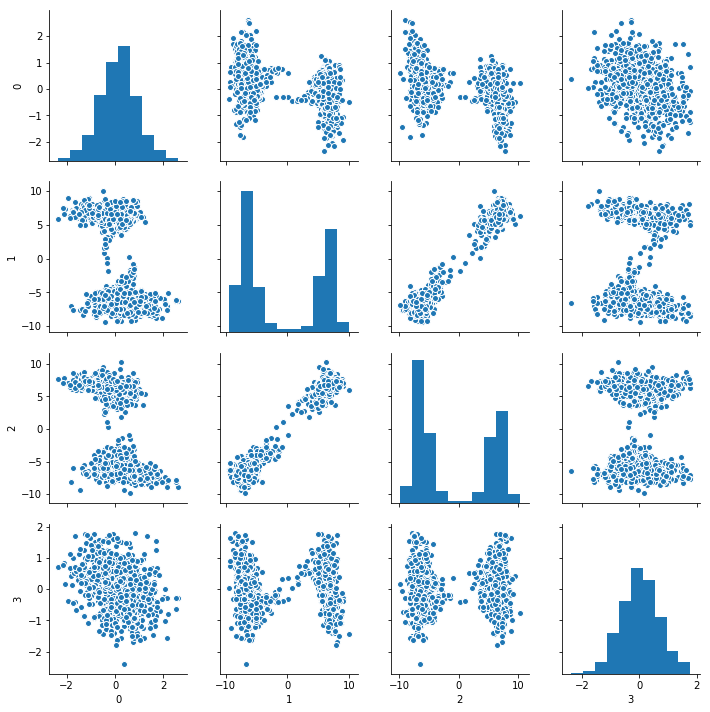

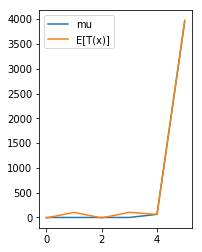

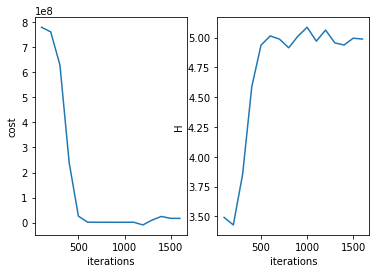

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1700 
H 4.883310525978911
cost 31418420.775517415


<Figure size 432x288 with 0 Axes>

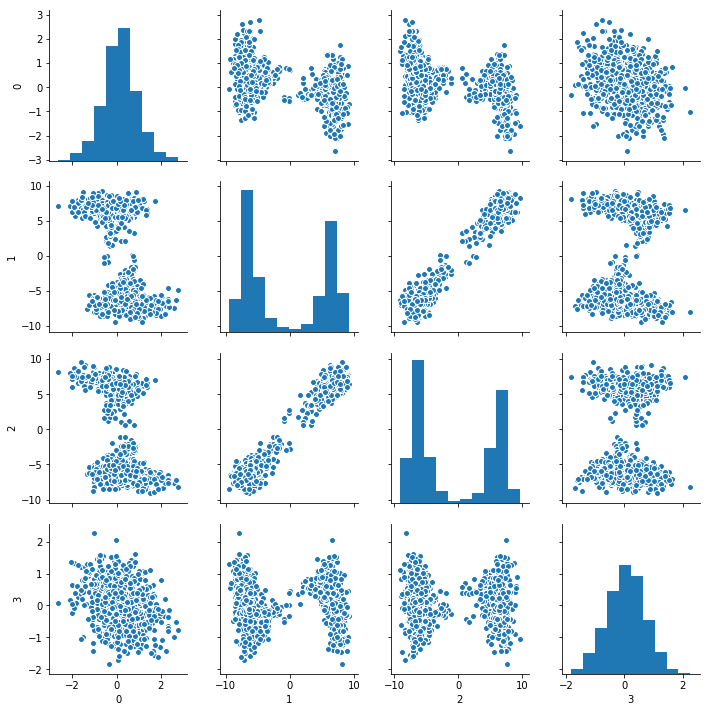

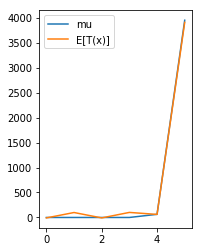

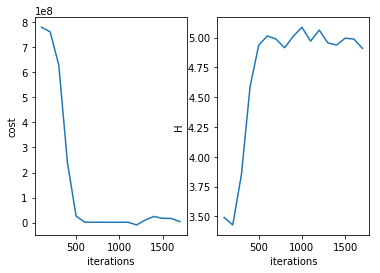

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1800 
H 4.974914181523218
cost 12140970.273031397


<Figure size 432x288 with 0 Axes>

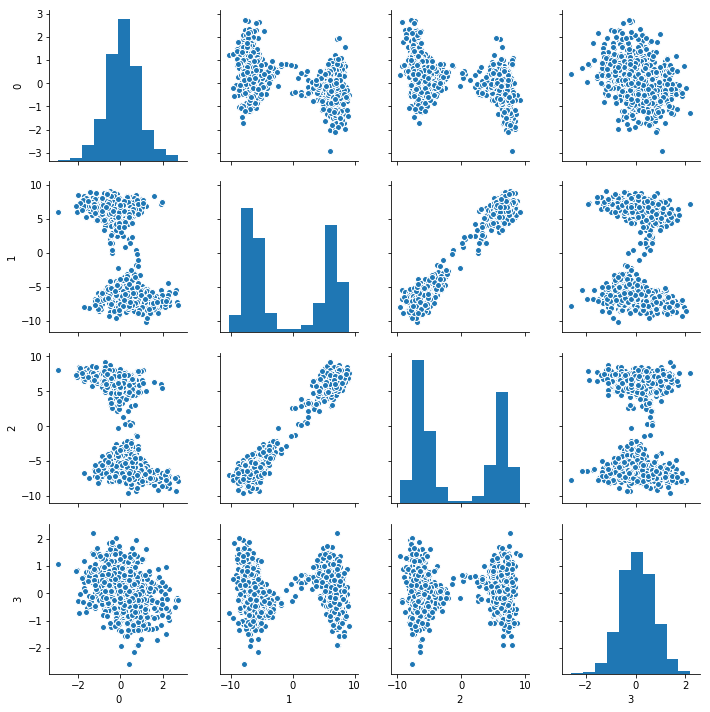

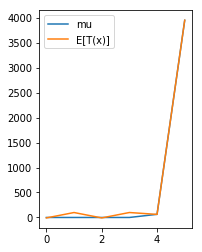

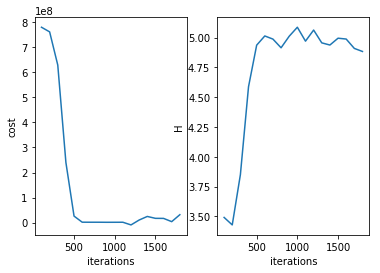

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 1900 
H 4.891643526000858
cost -10595222.219351776


<Figure size 432x288 with 0 Axes>

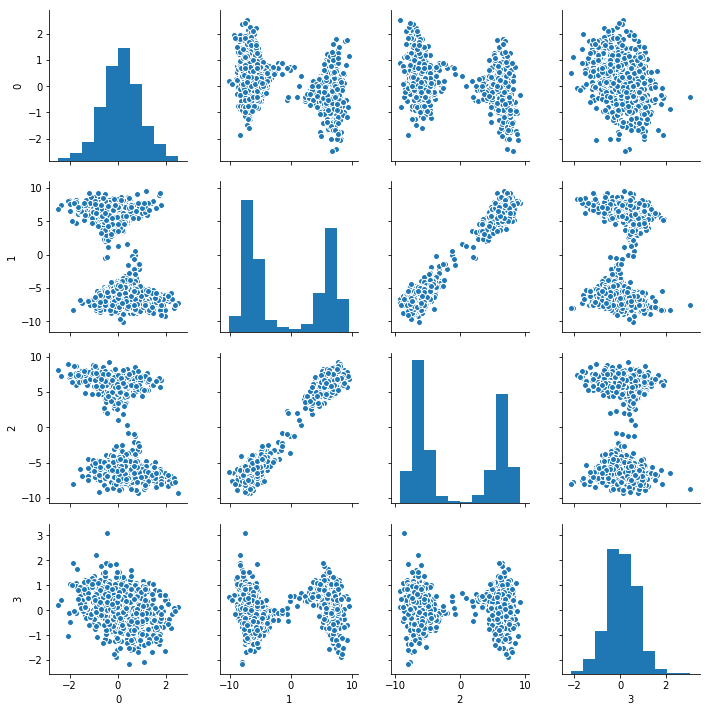

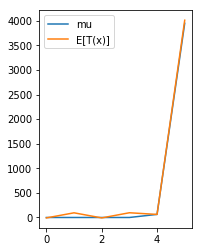

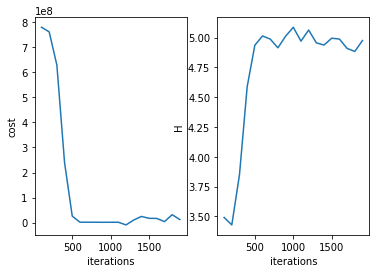

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2000 
H 4.839312296104055
cost 11316567.152257025


<Figure size 432x288 with 0 Axes>

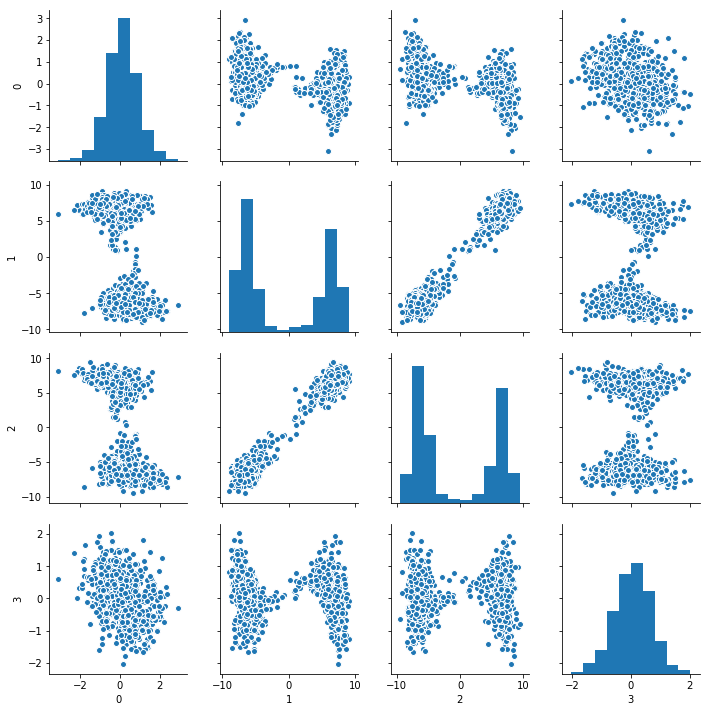

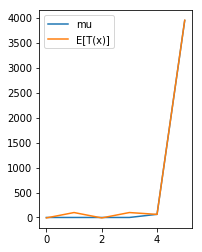

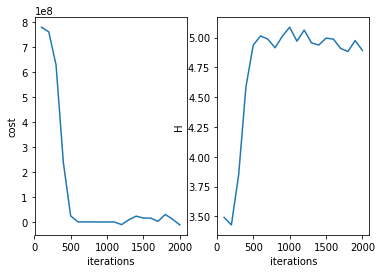

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 3
resetting optimizer
aug lag it 2
lambda [   -6510.50538592    72967.2493441    -15922.61097721   264706.43413507
   -68003.03715763 -4336150.70329744]
c 10000.0
saving model at iter 0
Doubling memory allocation for parameter logging.
******************************************
it = 2100 
H 4.8620209320575425
cost -101902264.93435633


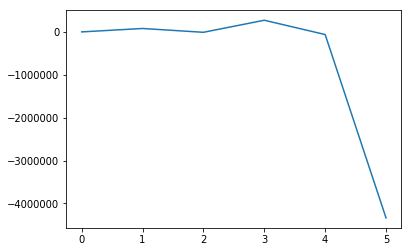

<Figure size 432x288 with 0 Axes>

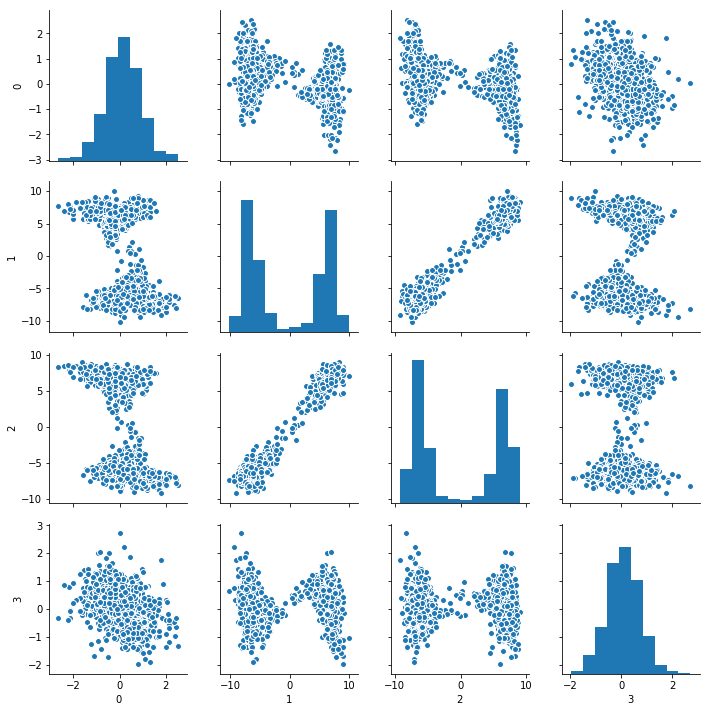

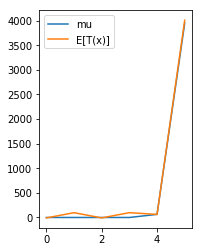

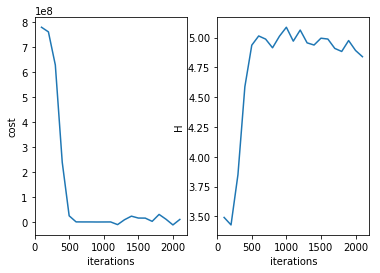

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2200 
H 4.898256691939018
cost 411212838.2156864


<Figure size 432x288 with 0 Axes>

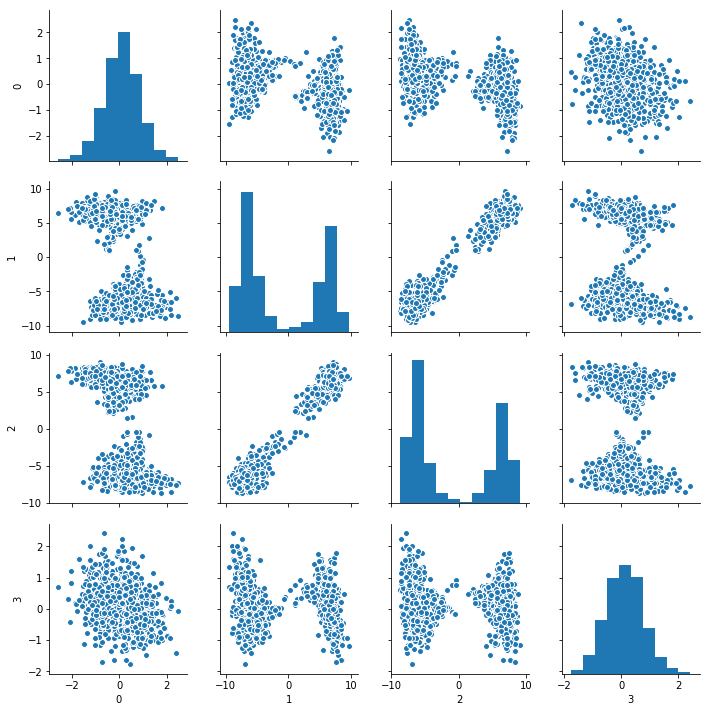

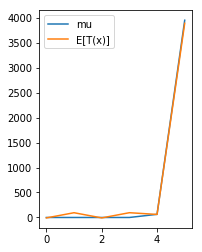

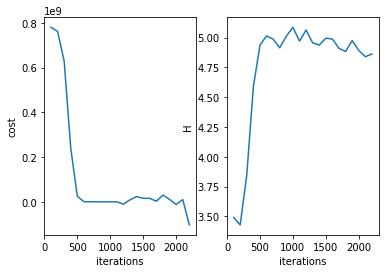

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2300 
H 4.738439957449324
cost 495523486.86139256


<Figure size 432x288 with 0 Axes>

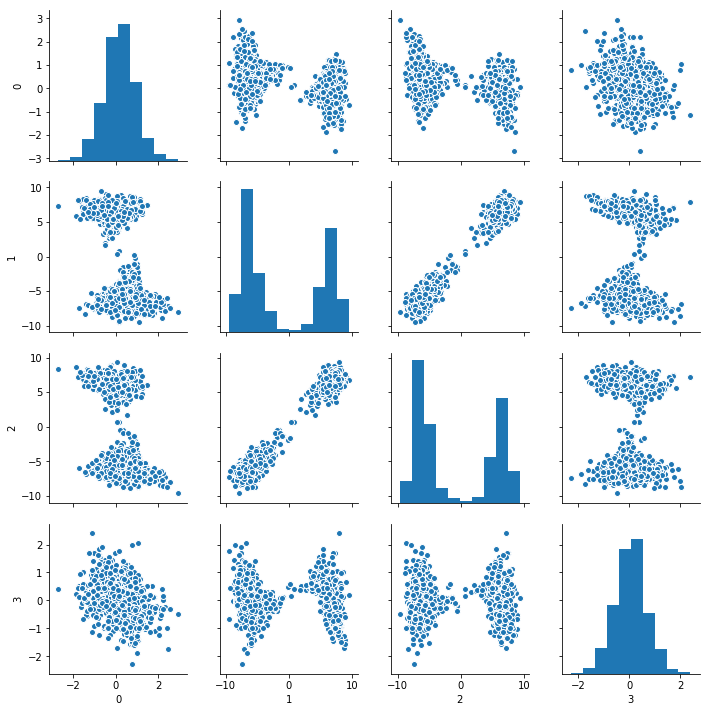

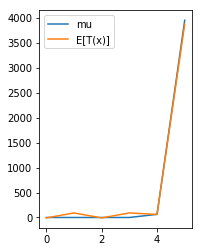

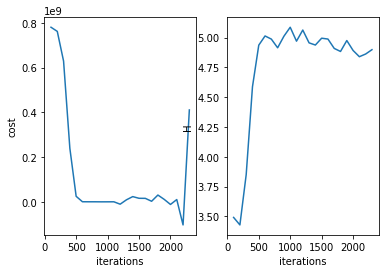

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2400 
H 4.894898371163487
cost -57166078.095286325


<Figure size 432x288 with 0 Axes>

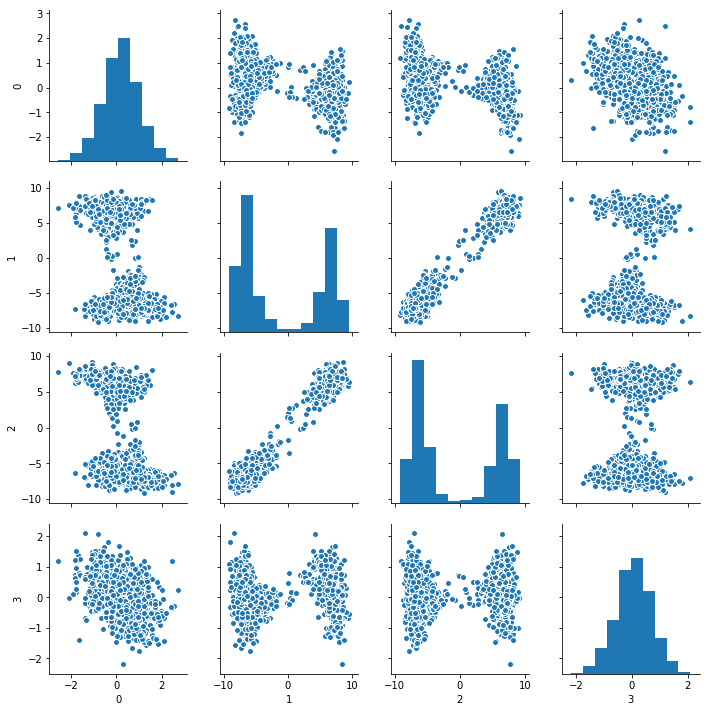

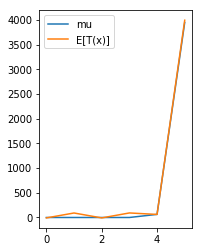

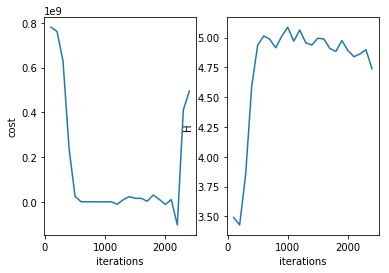

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2500 
H 4.8235958622668935
cost -174526081.9031273


<Figure size 432x288 with 0 Axes>

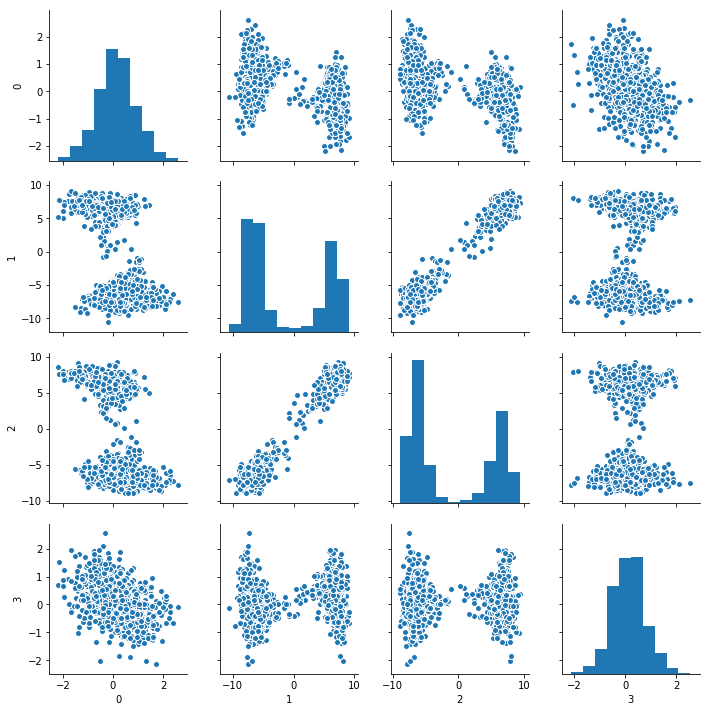

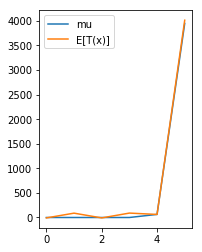

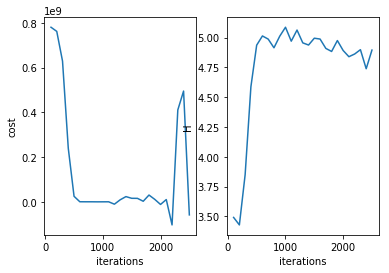

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2600 
H 4.6724560497998375
cost -30335800.69809018


<Figure size 432x288 with 0 Axes>

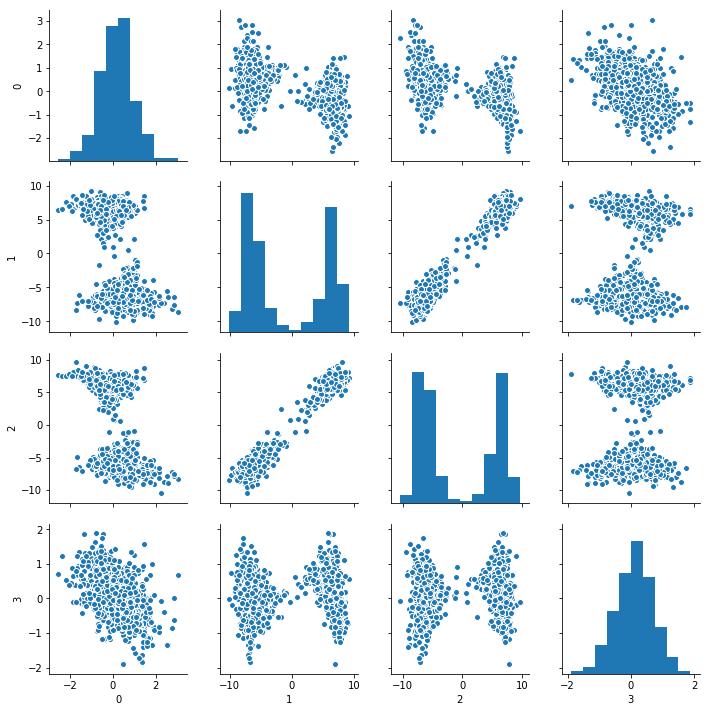

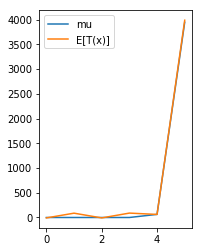

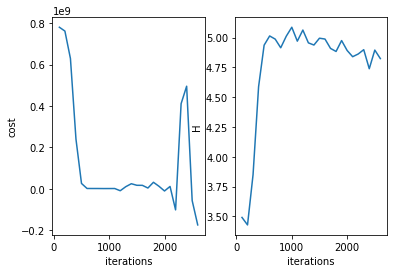

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2700 
H 4.779691197248281
cost -64636813.08732067


<Figure size 432x288 with 0 Axes>

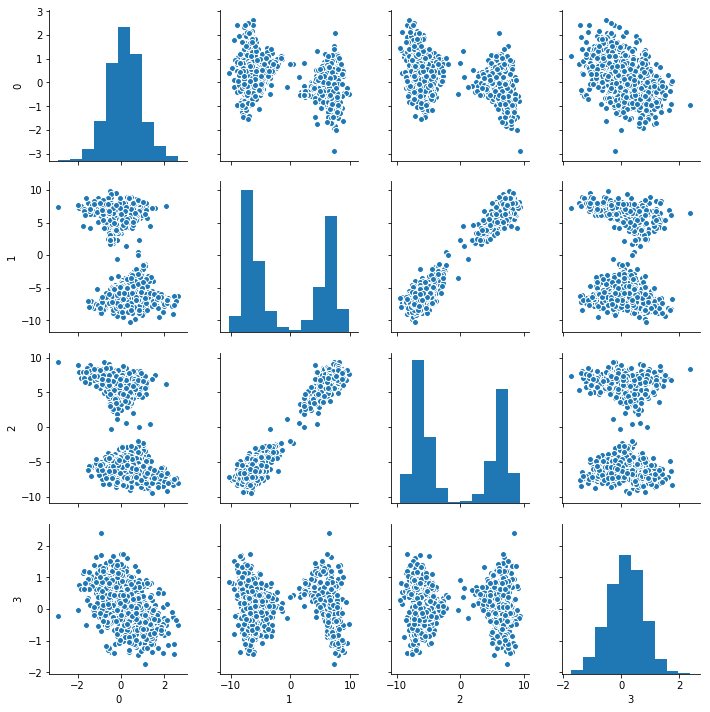

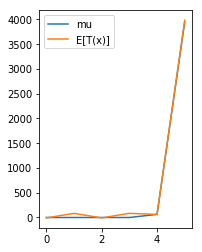

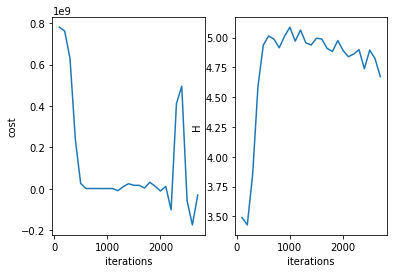

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2800 
H 4.718863818500707
cost 265830753.6805131


<Figure size 432x288 with 0 Axes>

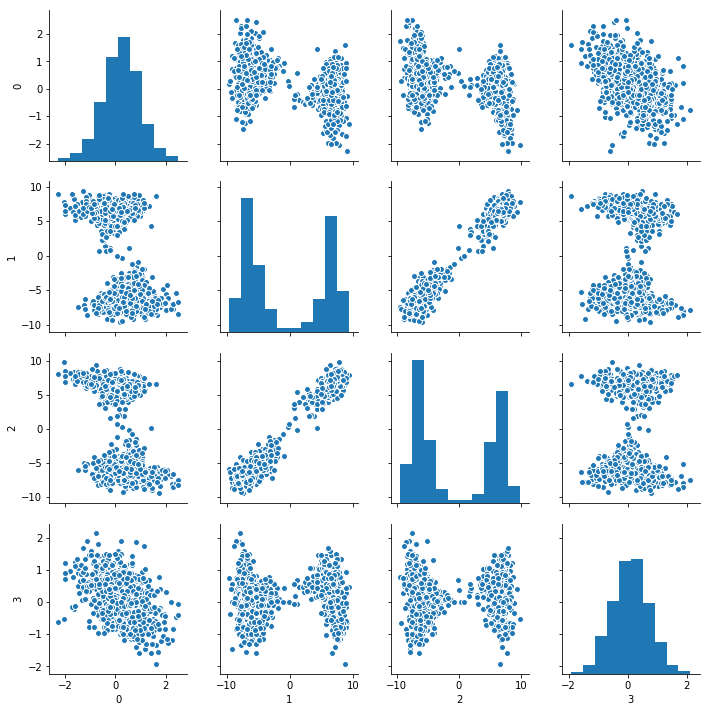

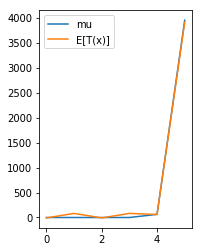

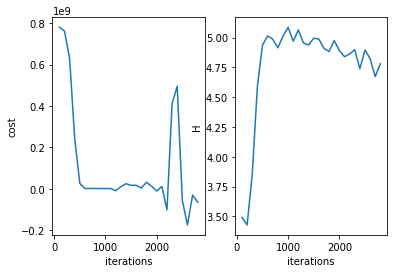

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 2900 
H 4.609626011374257
cost 144024983.1054508


<Figure size 432x288 with 0 Axes>

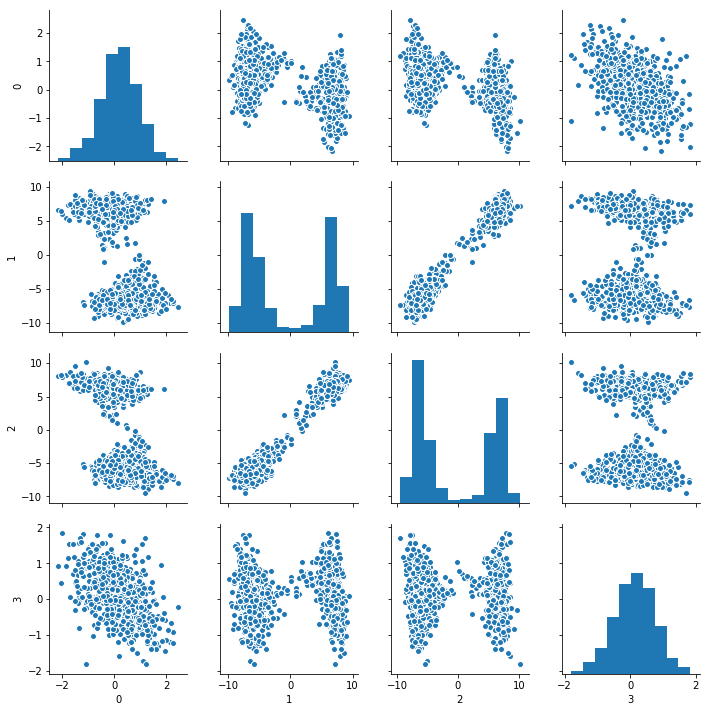

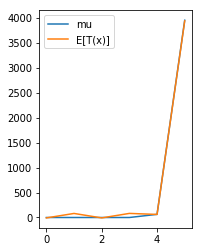

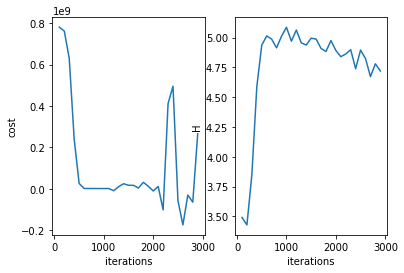

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3000 
H 4.636101959808915
cost -10330199.287957259


<Figure size 432x288 with 0 Axes>

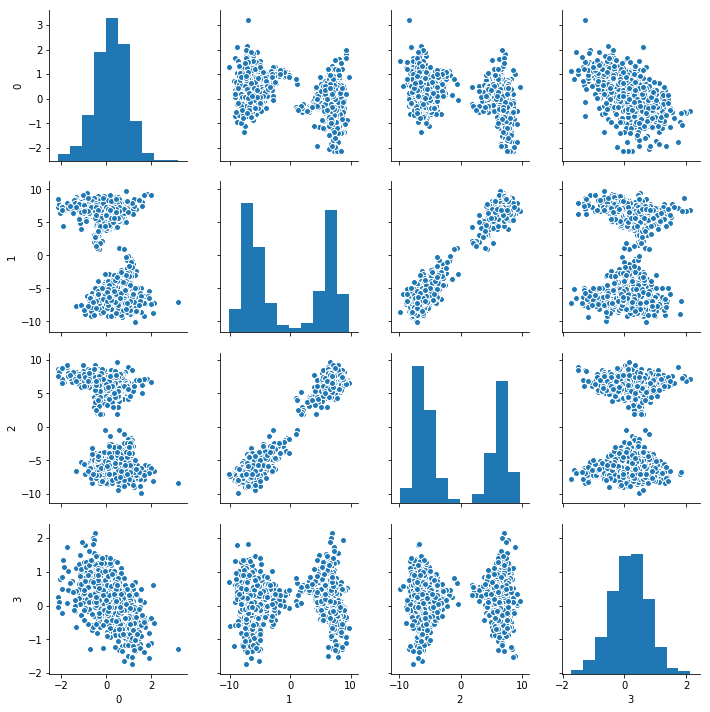

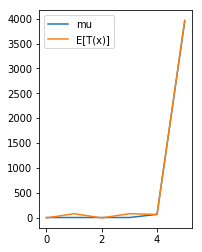

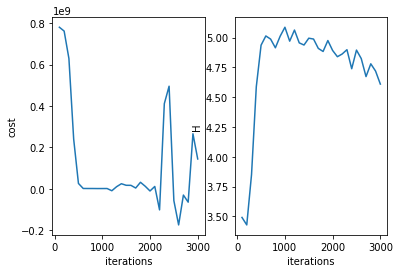

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 4
resetting optimizer
aug lag it 3
lambda [   -65696.91798524    736305.87974496   -160673.61986089
   2671128.5626357    -686212.46586335 -43755702.55145599]
c 100000.0
saving model at iter 0
******************************************
it = 3100 
H 4.649777283669795
cost 4696443718.196903


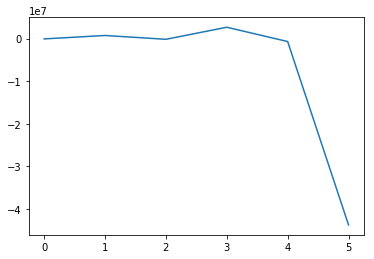

<Figure size 432x288 with 0 Axes>

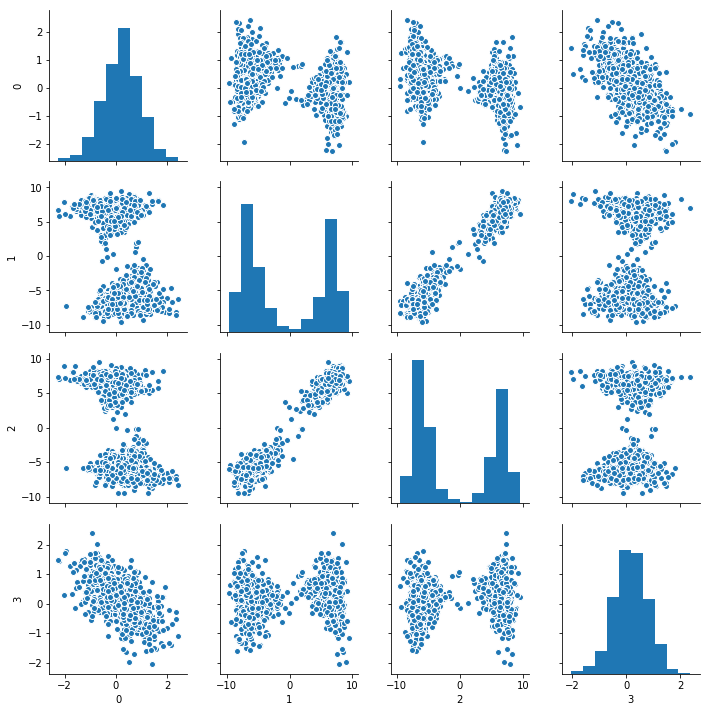

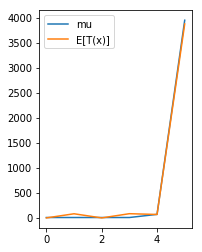

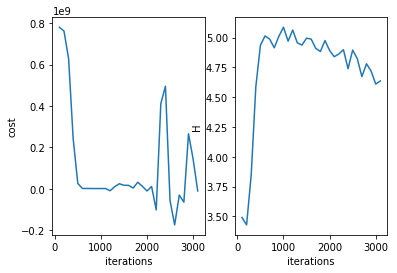

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3200 
H 4.654245969037381
cost -462566355.73272


<Figure size 432x288 with 0 Axes>

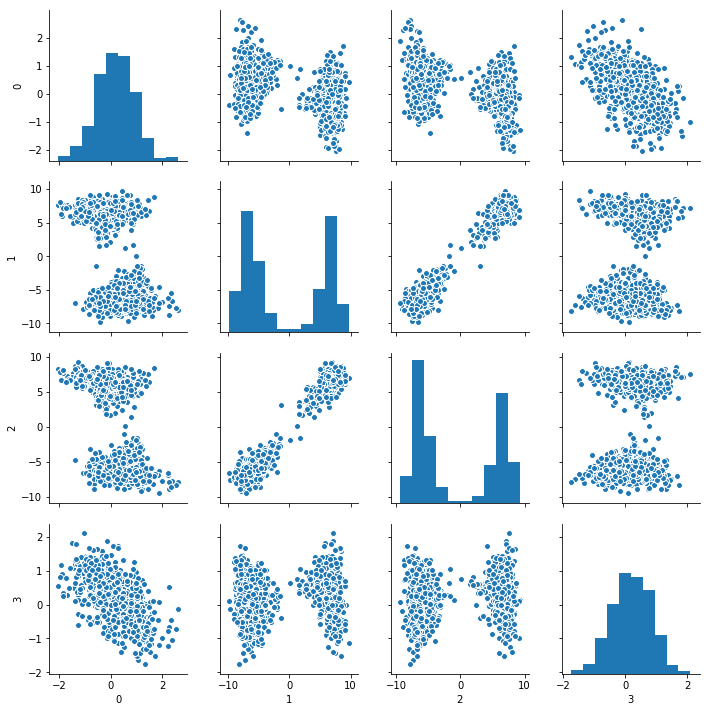

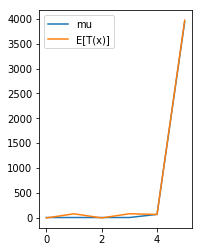

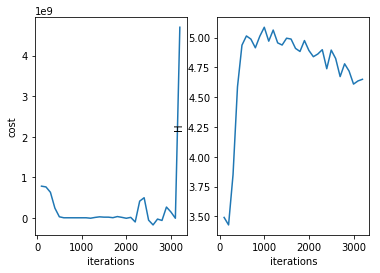

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3300 
H 4.664330217725978
cost 4367555448.6161


<Figure size 432x288 with 0 Axes>

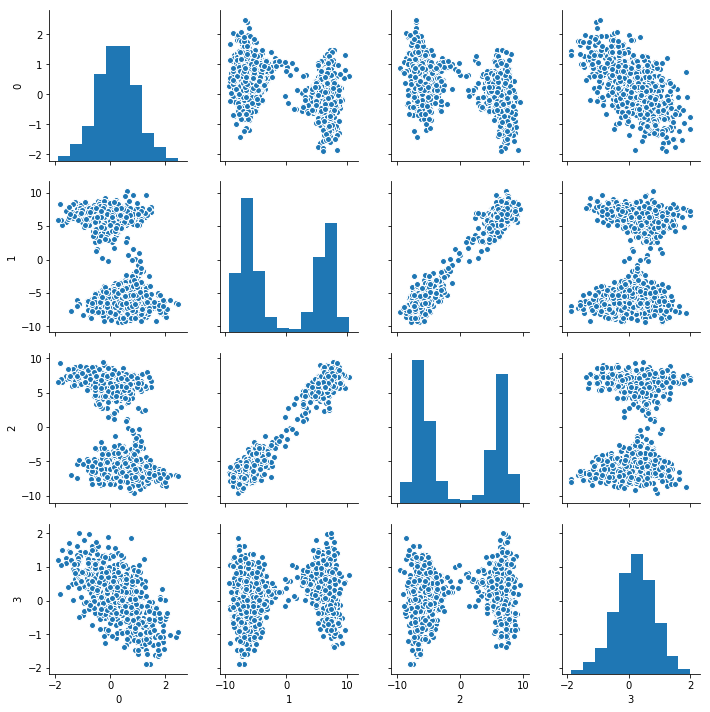

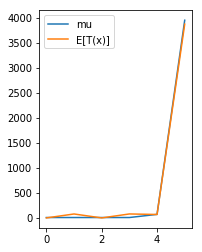

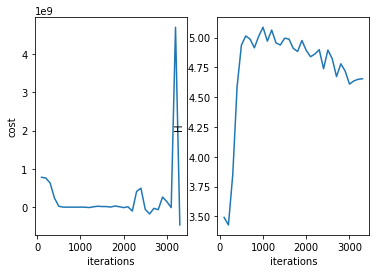

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3400 
H 4.623639358185499
cost -1509212197.512271


<Figure size 432x288 with 0 Axes>

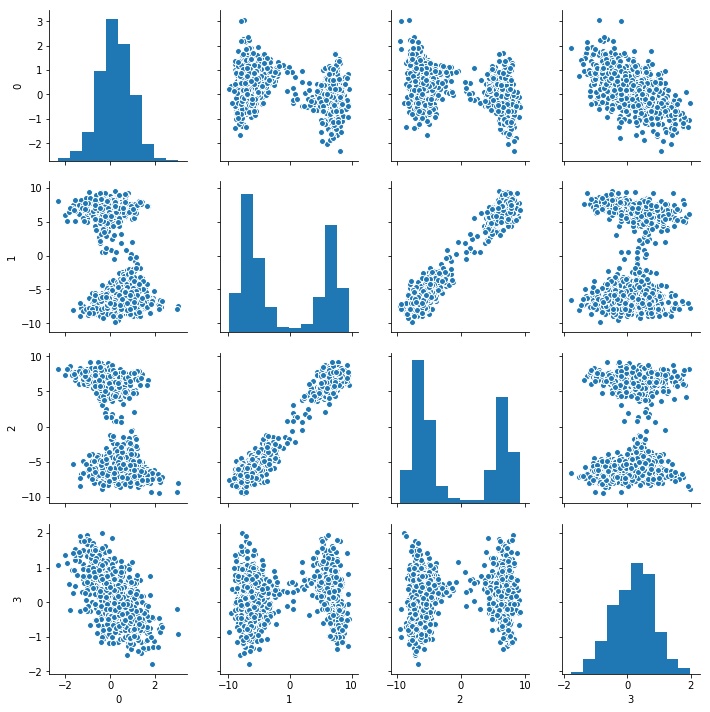

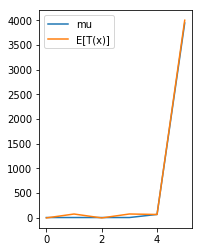

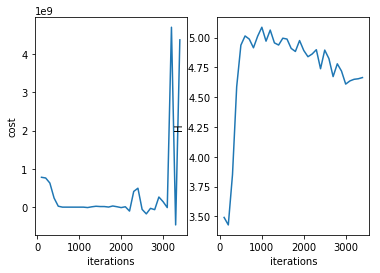

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3500 
H 4.616223258269836
cost -1831766144.7404013


<Figure size 432x288 with 0 Axes>

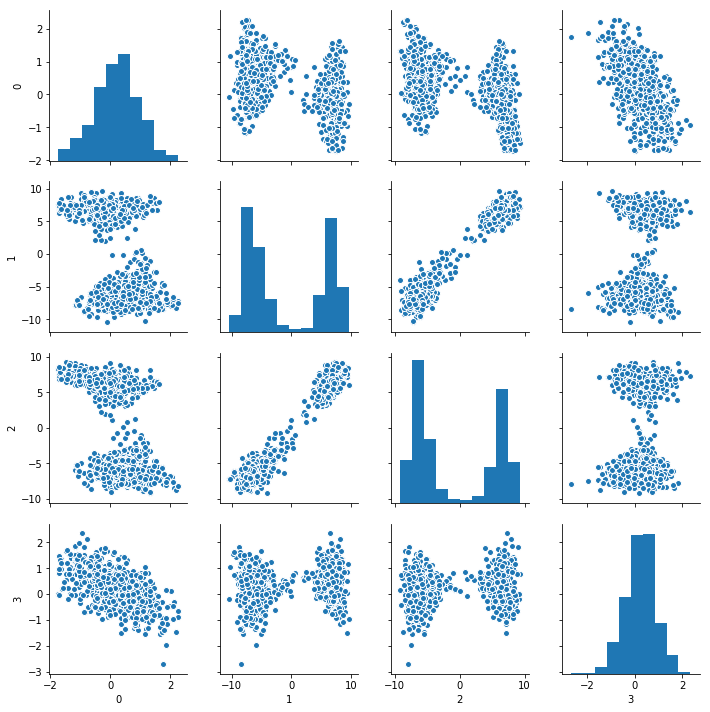

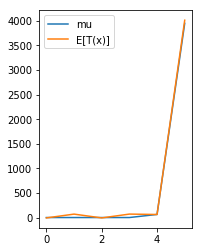

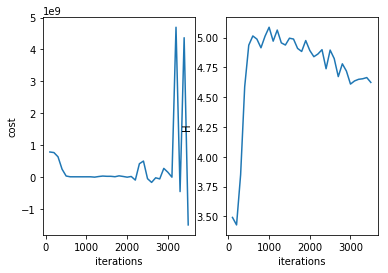

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3600 
H 4.554676256438548
cost 1803370590.41894


<Figure size 432x288 with 0 Axes>

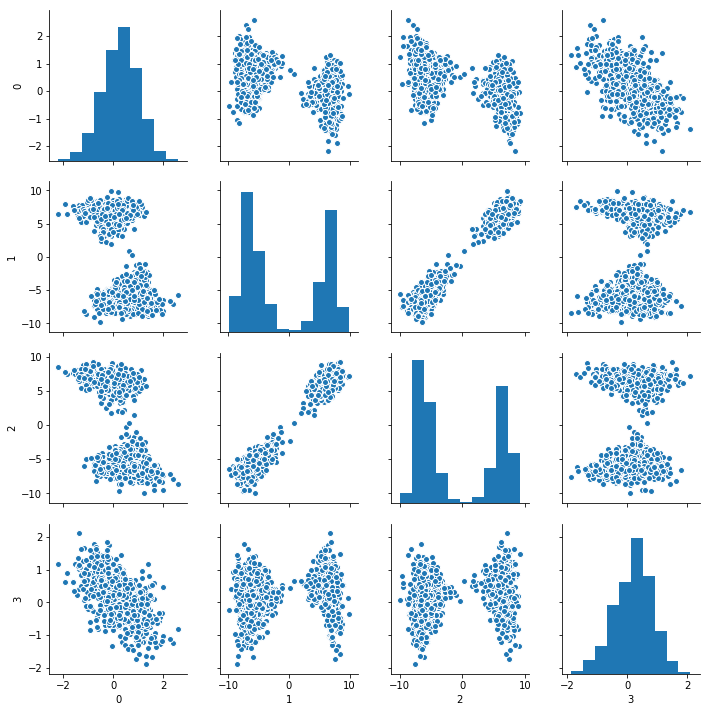

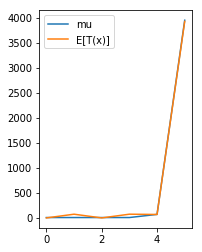

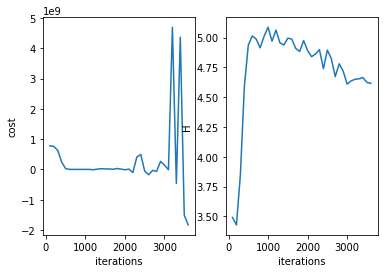

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3700 
H 4.604708998881421
cost 1036861041.5237323


<Figure size 432x288 with 0 Axes>

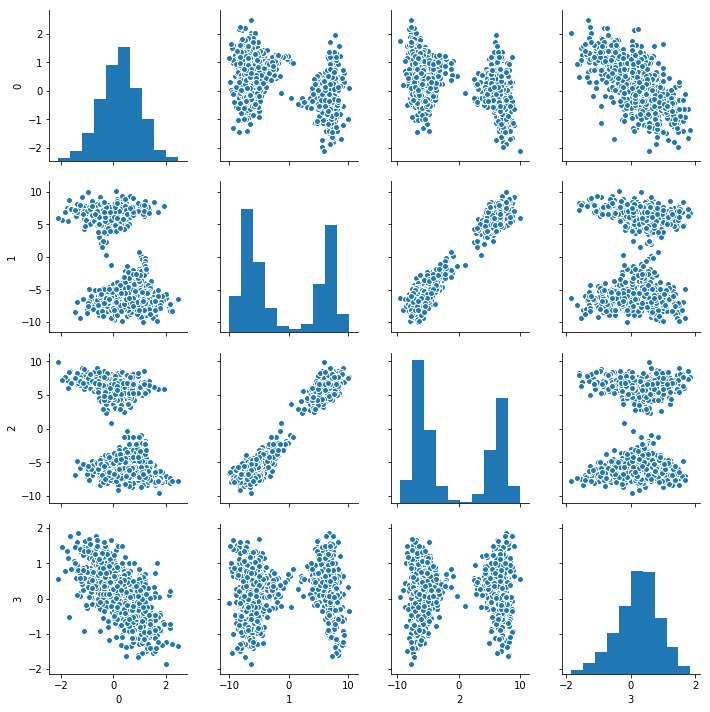

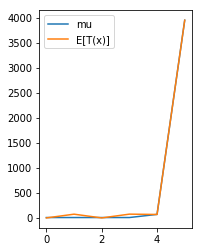

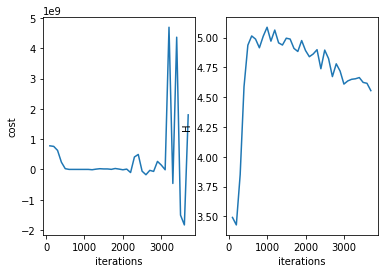

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3800 
H 4.499658599583047
cost 873229345.7162354


<Figure size 432x288 with 0 Axes>

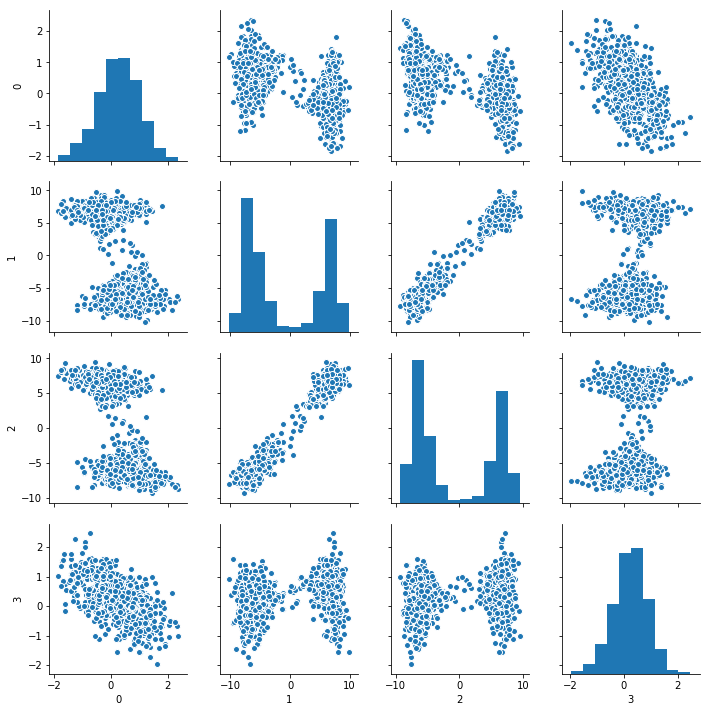

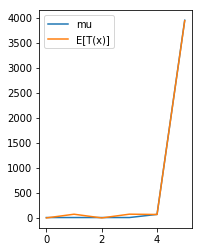

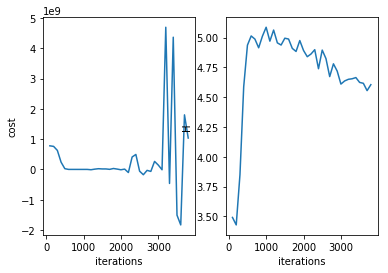

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 3900 
H 4.45187803360365
cost 1816245140.8105218


<Figure size 432x288 with 0 Axes>

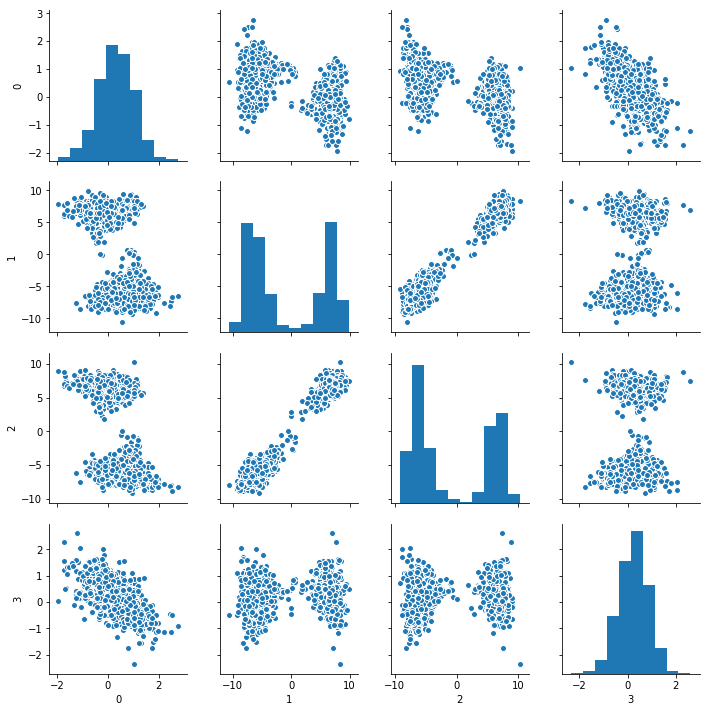

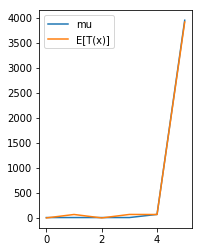

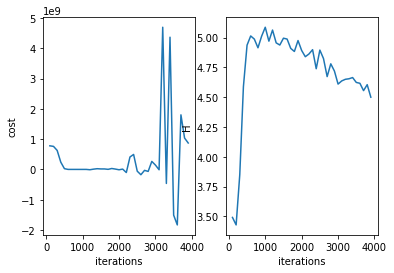

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4000 
H 4.56969438331095
cost 1738210175.9971697


<Figure size 432x288 with 0 Axes>

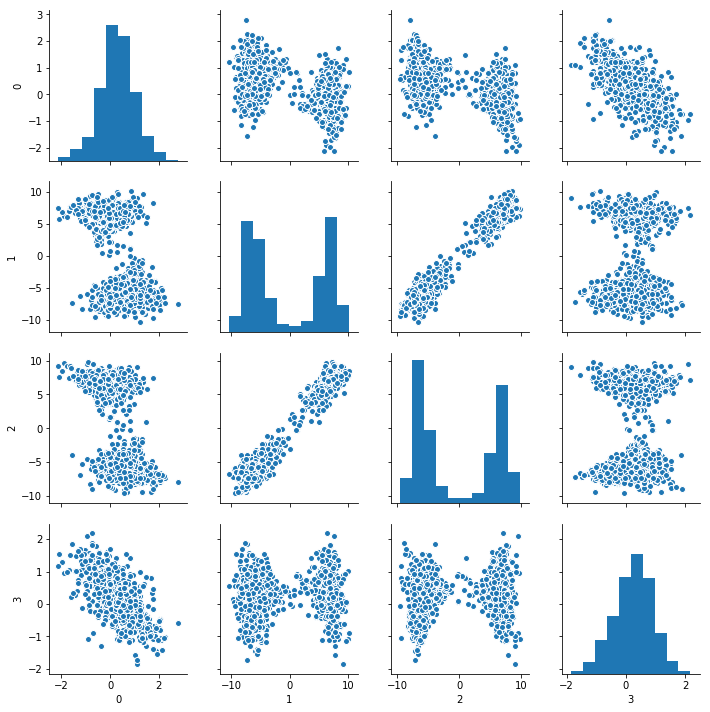

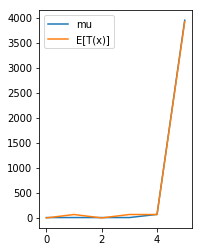

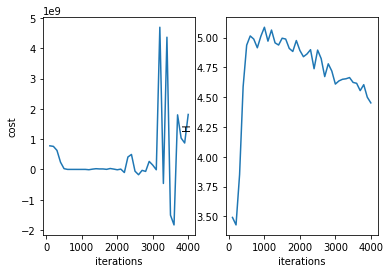

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 5
resetting optimizer
aug lag it 4
lambda [-6.57561044e+05  7.36969218e+06 -1.60818371e+06  2.67353498e+07
 -6.86830675e+06 -4.37951221e+08]
c 1000000.0
saving model at iter 0
Doubling memory allocation for parameter logging.
******************************************
it = 4100 
H 4.459586195531481
cost -9126184344.552227


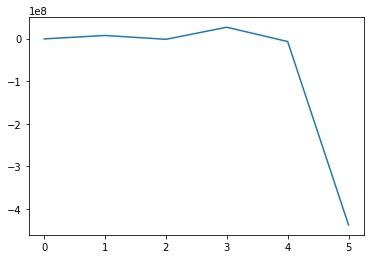

<Figure size 432x288 with 0 Axes>

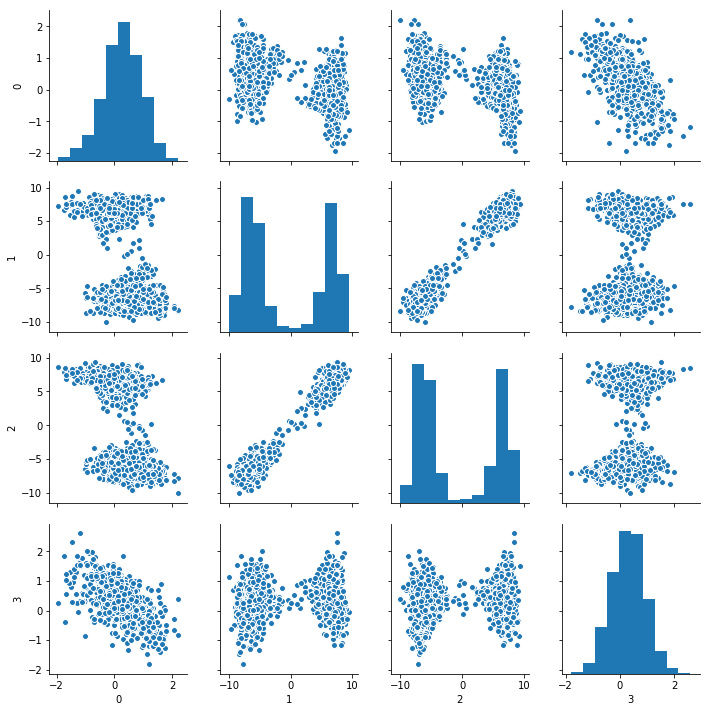

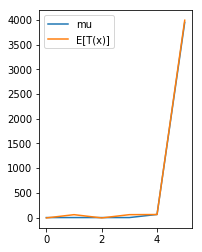

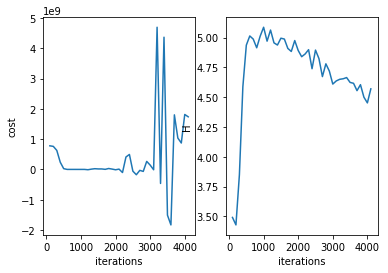

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4200 
H 4.532723135002266
cost 14724941678.349201


<Figure size 432x288 with 0 Axes>

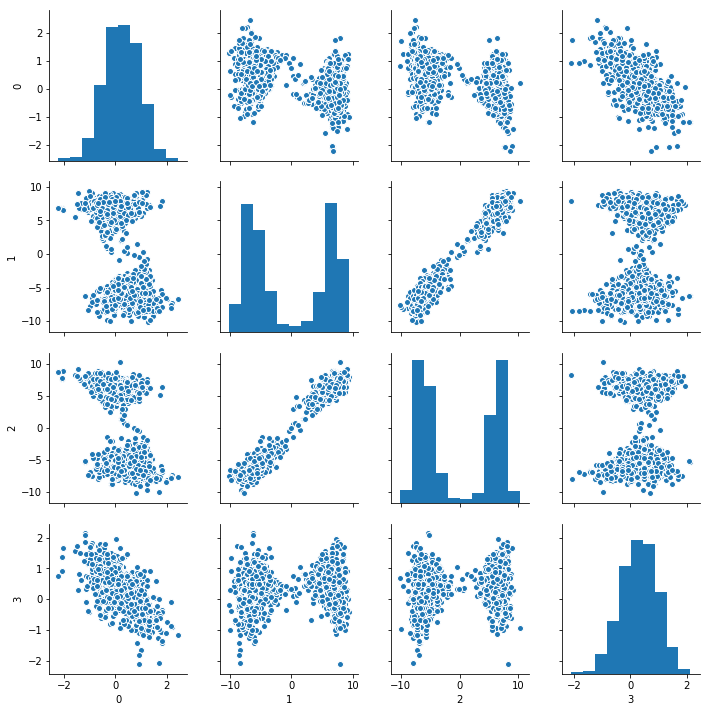

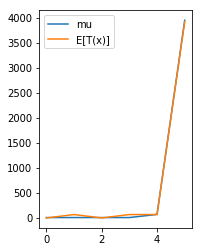

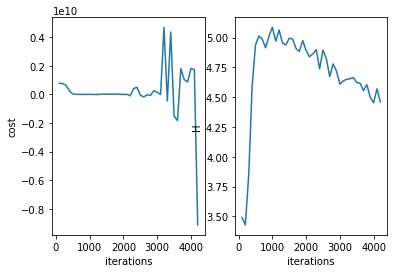

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4300 
H 4.480194440901076
cost 4764323262.598436


<Figure size 432x288 with 0 Axes>

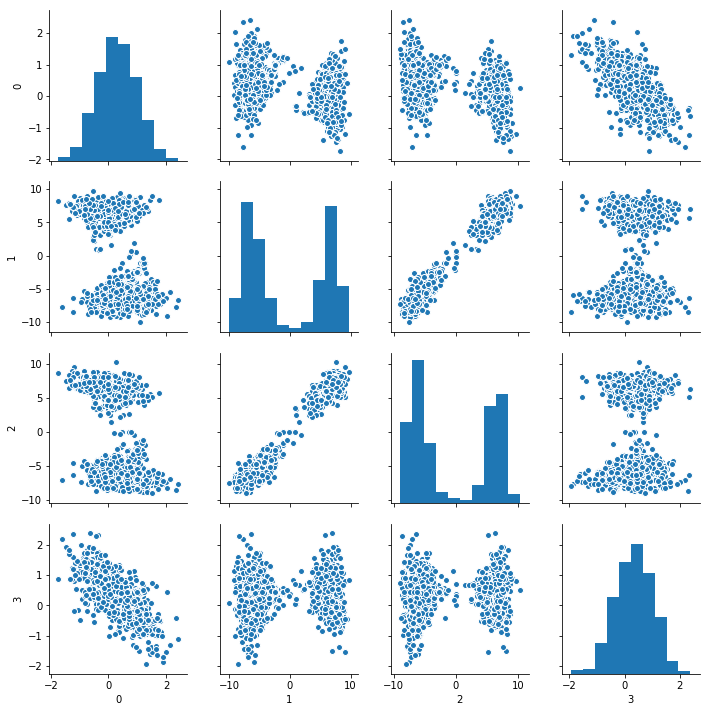

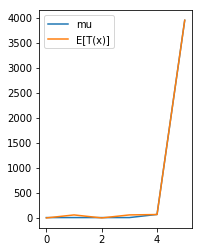

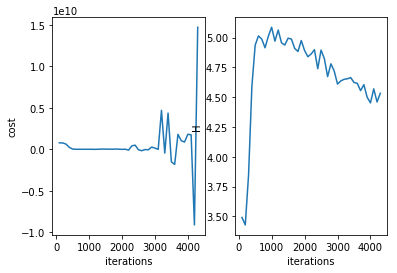

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4400 
H 4.4675916707810135
cost 39062507979.415436


<Figure size 432x288 with 0 Axes>

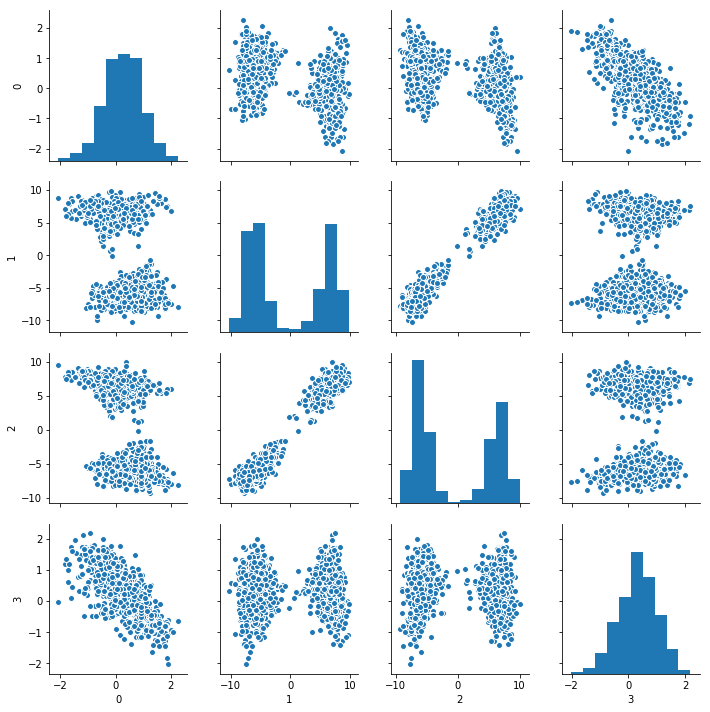

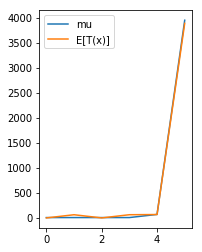

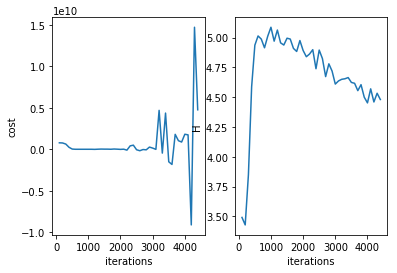

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4500 
H 4.473086869741619
cost 30532512050.72914


<Figure size 432x288 with 0 Axes>

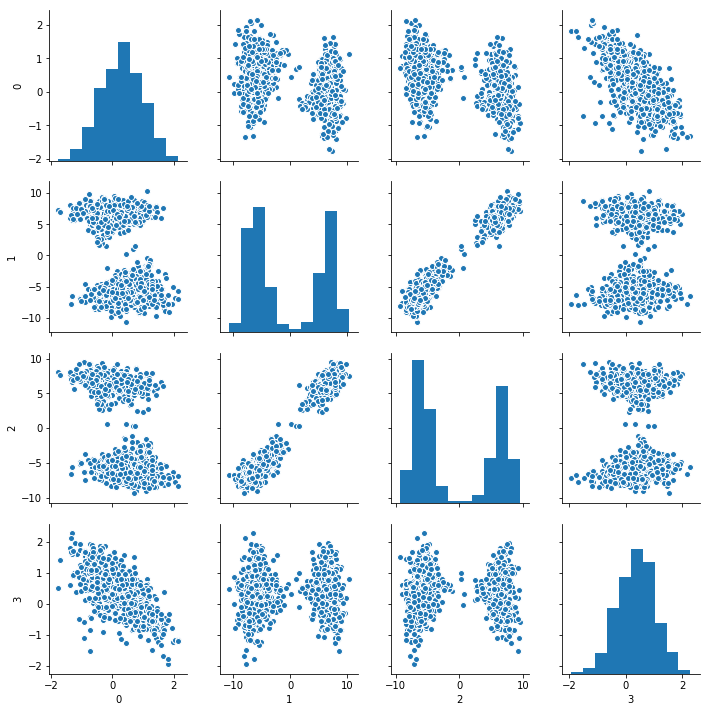

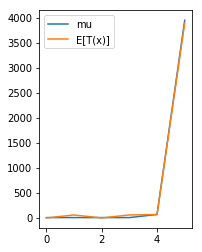

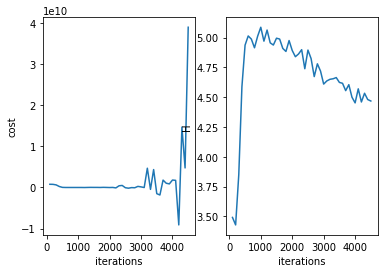

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4600 
H 4.327070893808814
cost 44392590467.34766


<Figure size 432x288 with 0 Axes>

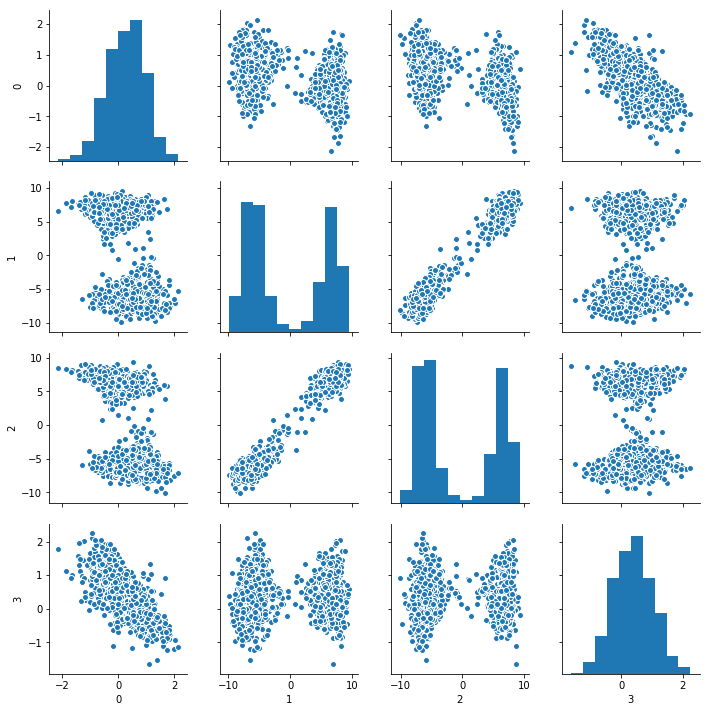

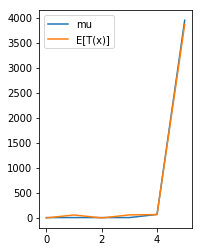

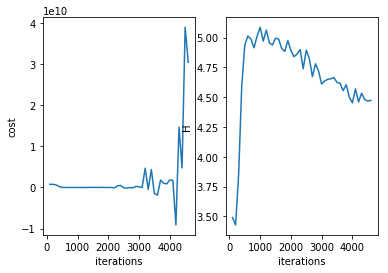

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4700 
H 4.369678838560157
cost 32521909137.97937


<Figure size 432x288 with 0 Axes>

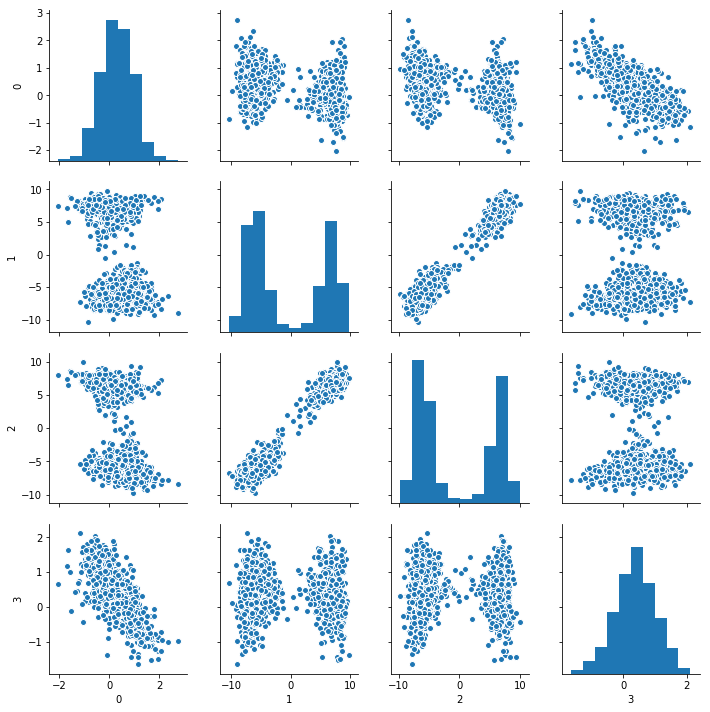

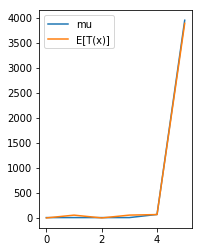

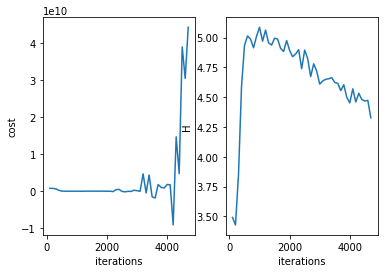

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4800 
H 4.6407412406653
cost -354071019.65089464


<Figure size 432x288 with 0 Axes>

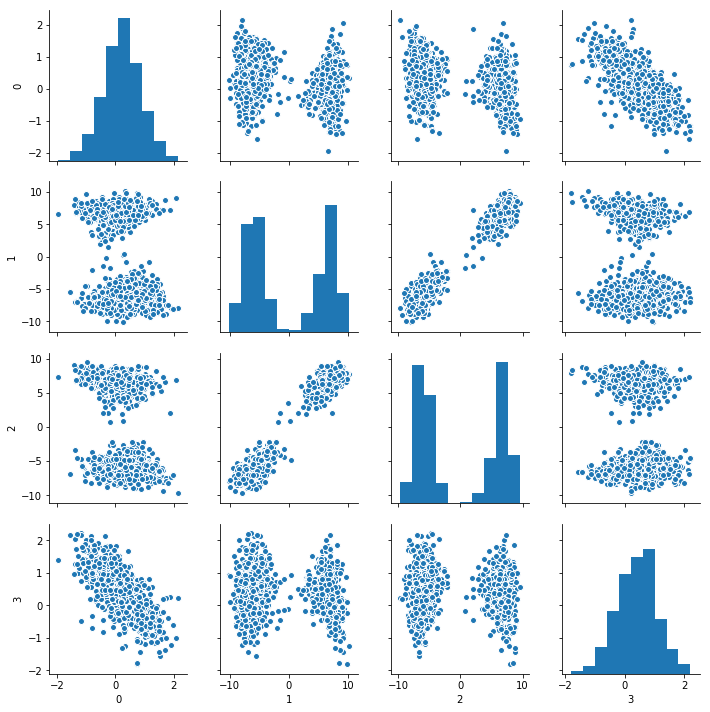

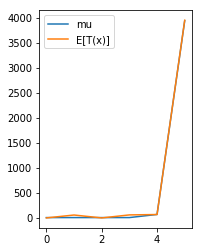

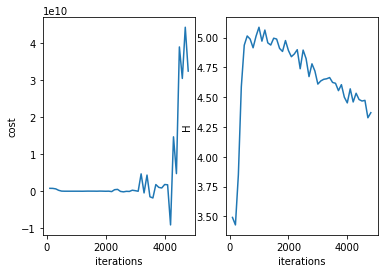

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 4900 
H 4.477118340137864
cost 18698532088.79181


<Figure size 432x288 with 0 Axes>

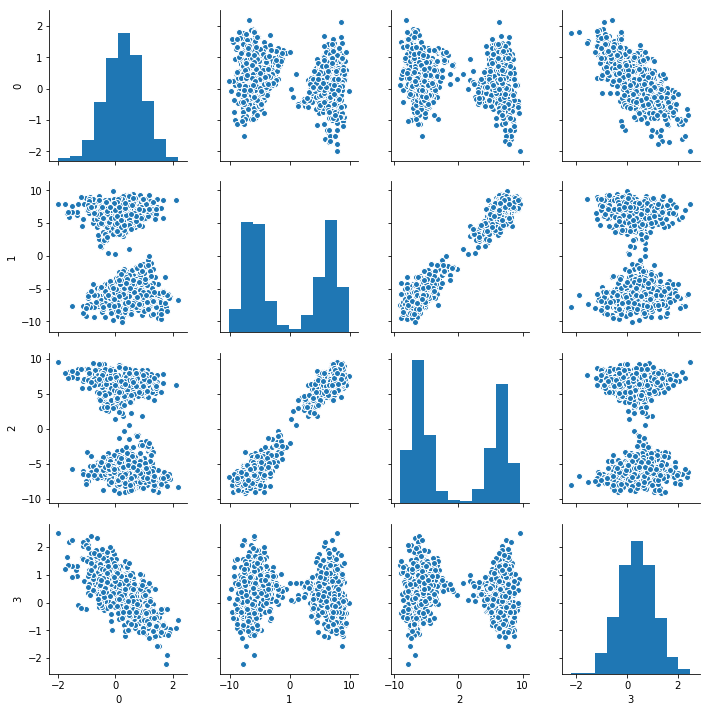

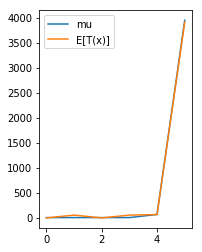

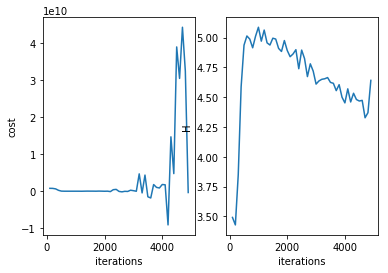

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5000 
H 4.489087371656224
cost 51966753338.84447


<Figure size 432x288 with 0 Axes>

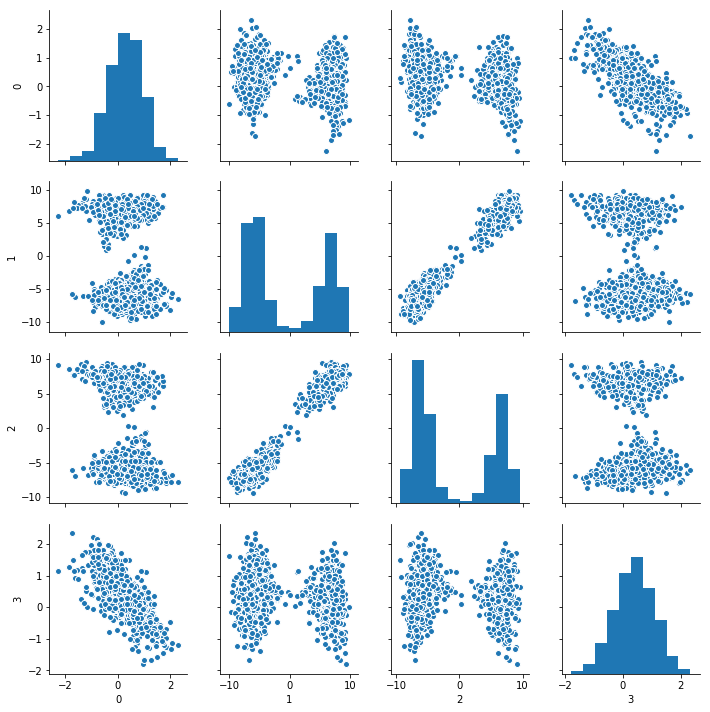

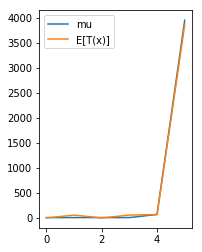

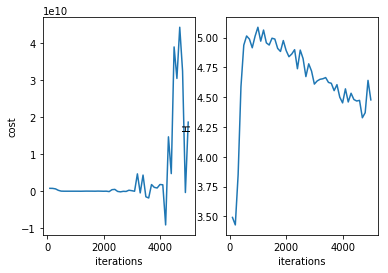

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 6
resetting optimizer
aug lag it 5
lambda [-6.57620230e+06  7.37035552e+07 -1.60832846e+07  2.67377563e+08
 -6.86892496e+07 -4.37990641e+09]
c 10000000.0
saving model at iter 0
******************************************
it = 5100 
H 4.461921734122458
cost 116943575635.06293


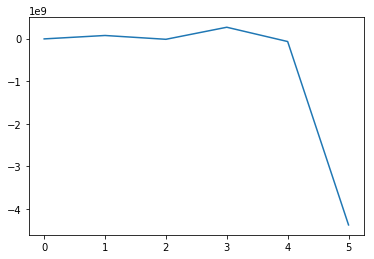

<Figure size 432x288 with 0 Axes>

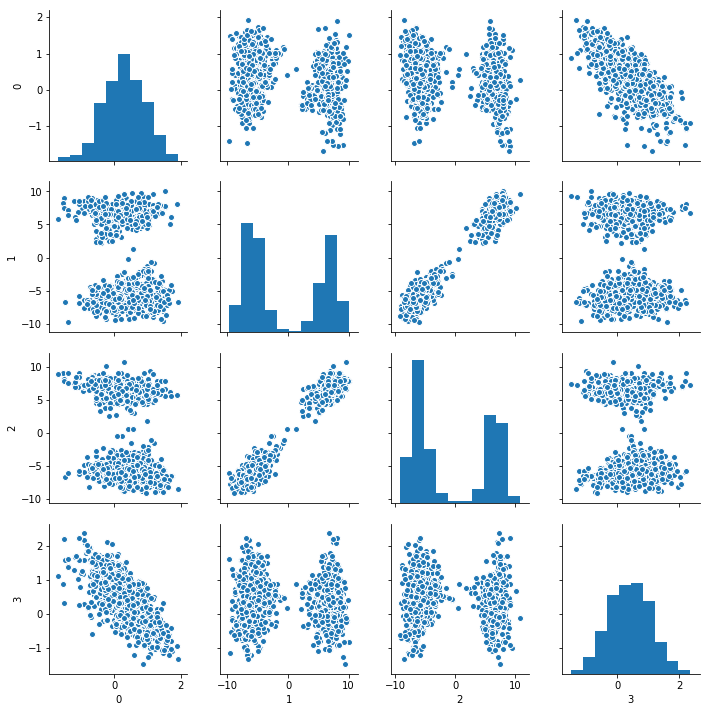

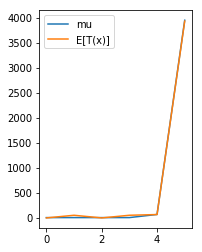

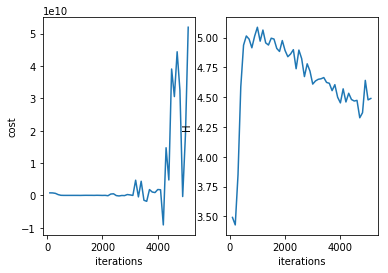

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5200 
H 4.3827280679715255
cost -12044009169.500244


<Figure size 432x288 with 0 Axes>

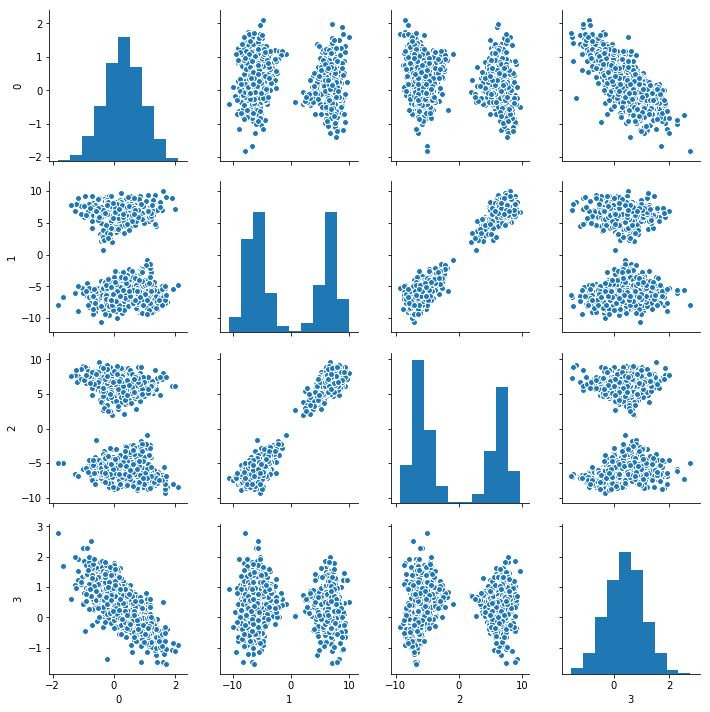

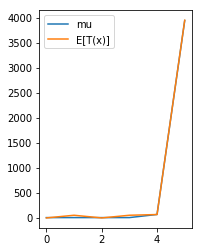

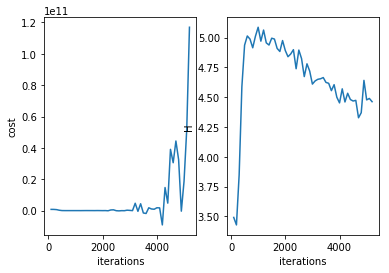

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5300 
H 4.445298503441876
cost 58392471183.78397


<Figure size 432x288 with 0 Axes>

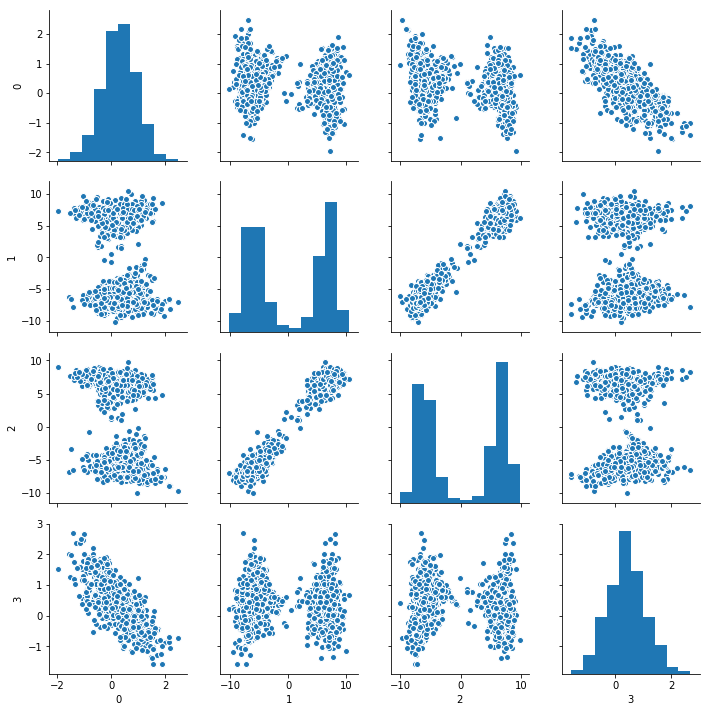

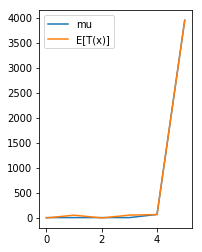

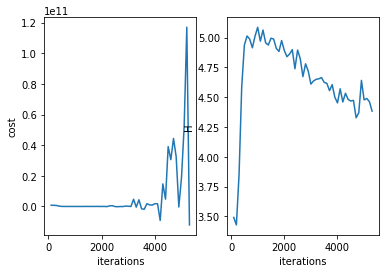

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5400 
H 4.453226040421728
cost -74300351134.06244


<Figure size 432x288 with 0 Axes>

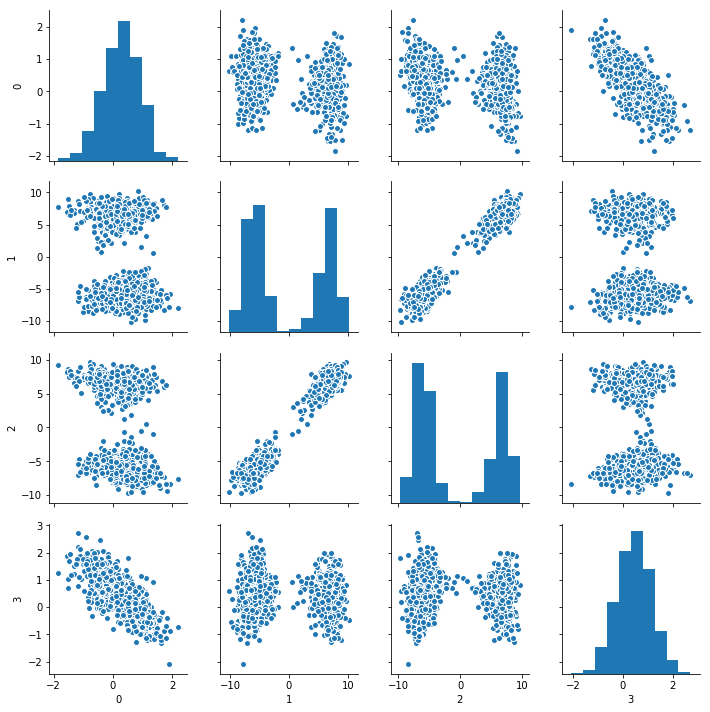

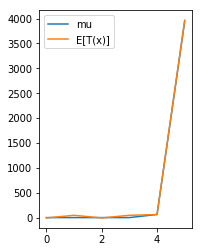

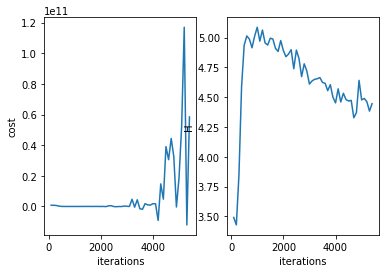

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5500 
H 4.537179184324626
cost -100633463761.12935


<Figure size 432x288 with 0 Axes>

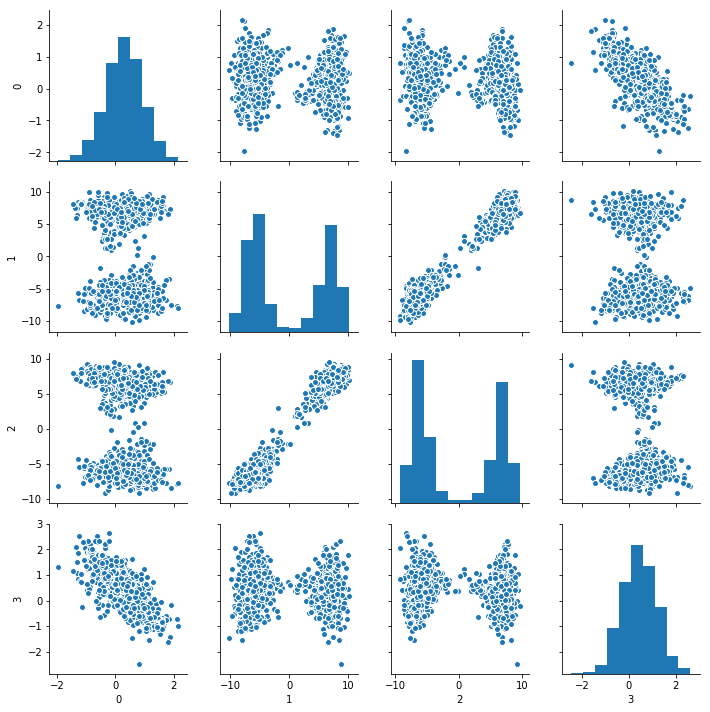

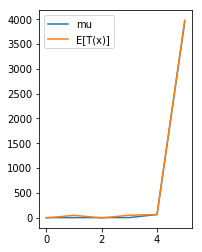

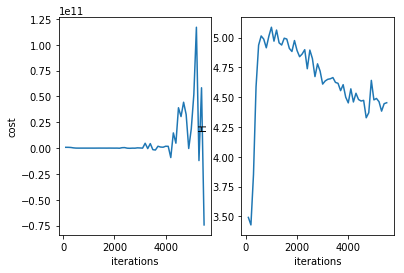

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5600 
H 4.427864315601246
cost 254131531230.77655


<Figure size 432x288 with 0 Axes>

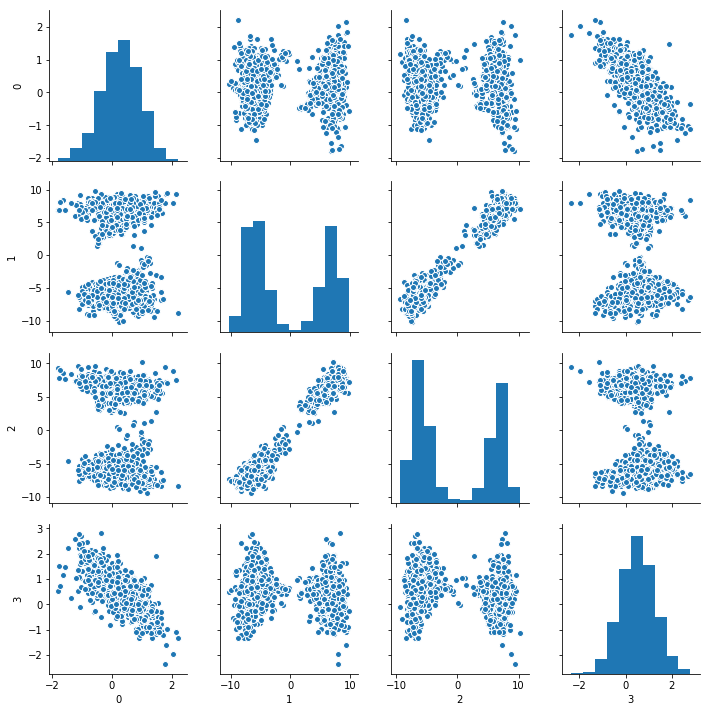

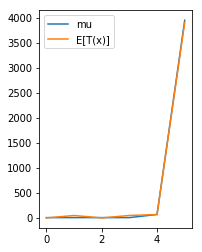

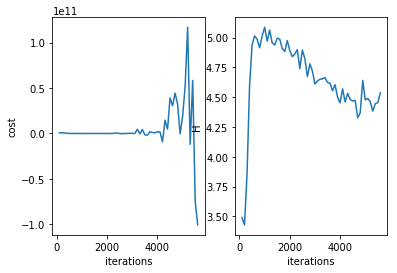

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5700 
H 4.430172268110627
cost 345866038914.5099


<Figure size 432x288 with 0 Axes>

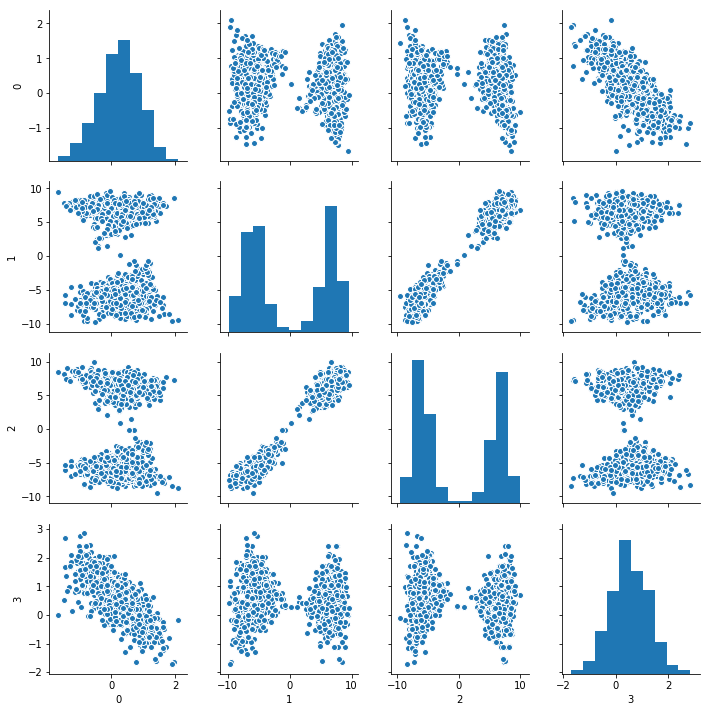

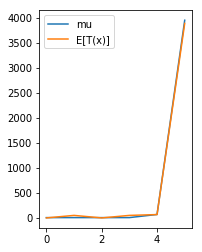

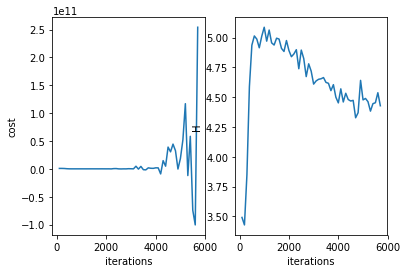

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5800 
H 4.49712192347021
cost 137757789869.41992


<Figure size 432x288 with 0 Axes>

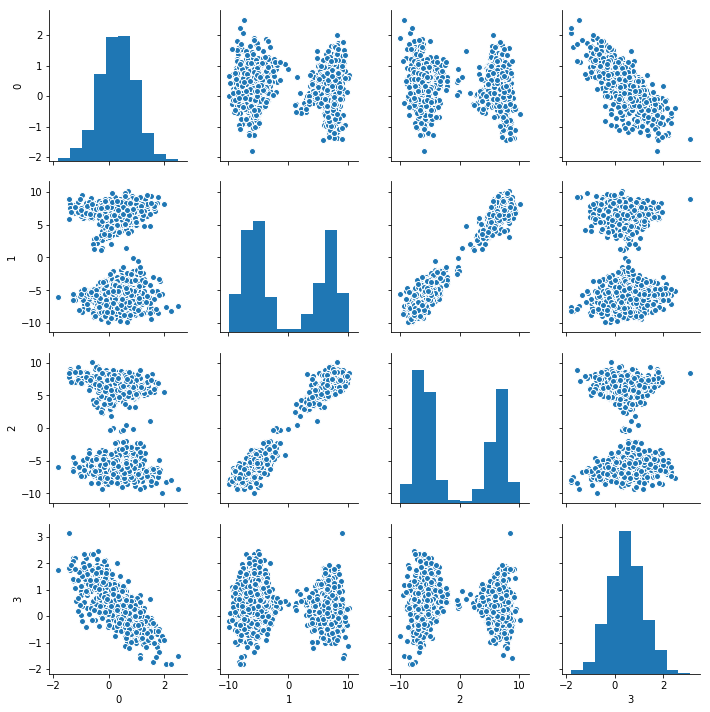

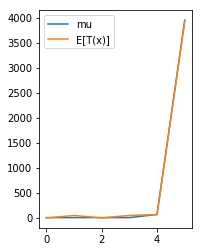

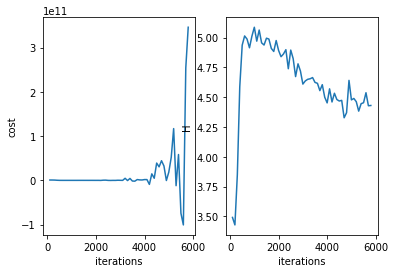

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 5900 
H 4.44297321800618
cost -63401759072.196815


<Figure size 432x288 with 0 Axes>

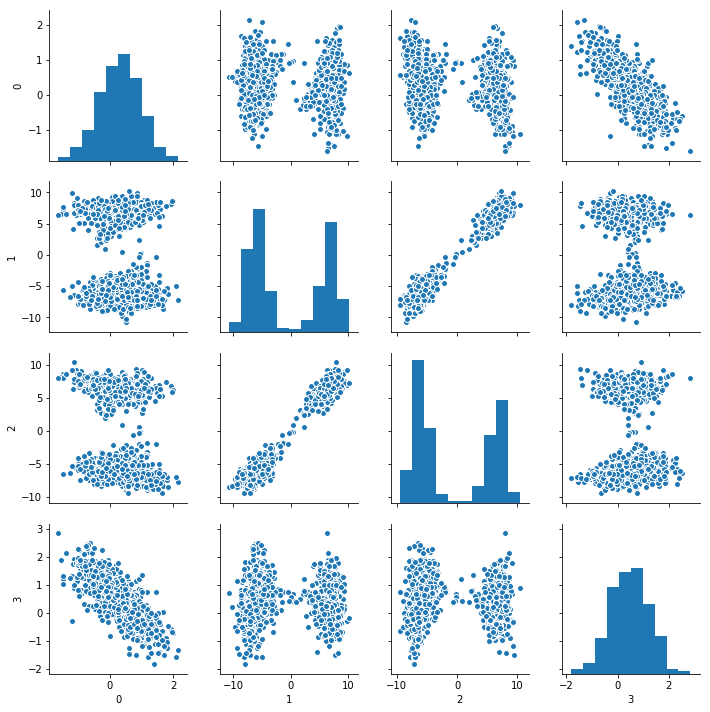

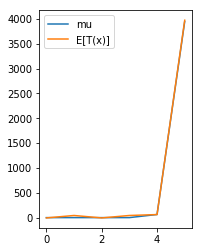

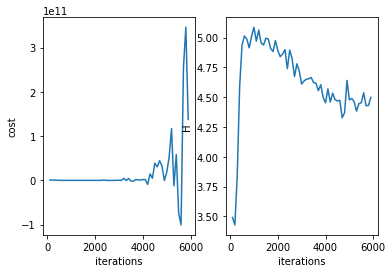

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6000 
H 4.555333943459281
cost -302060406324.9866


<Figure size 432x288 with 0 Axes>

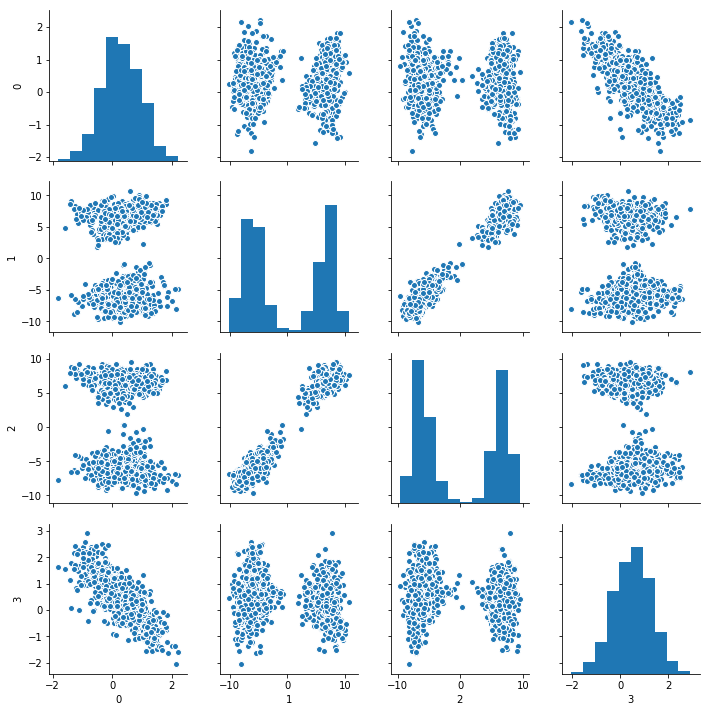

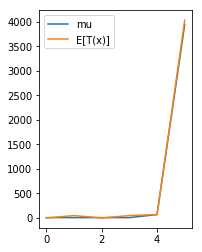

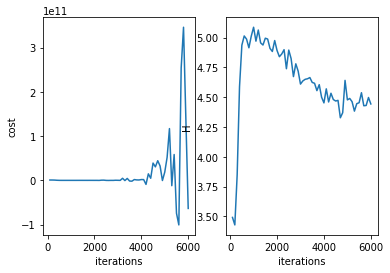

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 7
resetting optimizer
aug lag it 6
lambda [-6.57626149e+07  7.37042186e+08 -1.60834293e+08  2.67379969e+09
 -6.86898678e+08 -4.37994583e+10]
c 100000000.0
saving model at iter 0
******************************************
it = 6100 
H 4.427826973001099
cost -1588481040496.1797


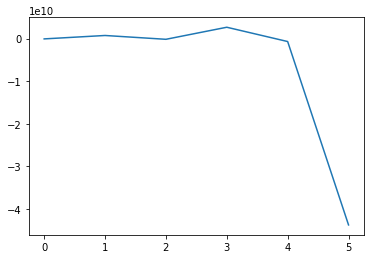

<Figure size 432x288 with 0 Axes>

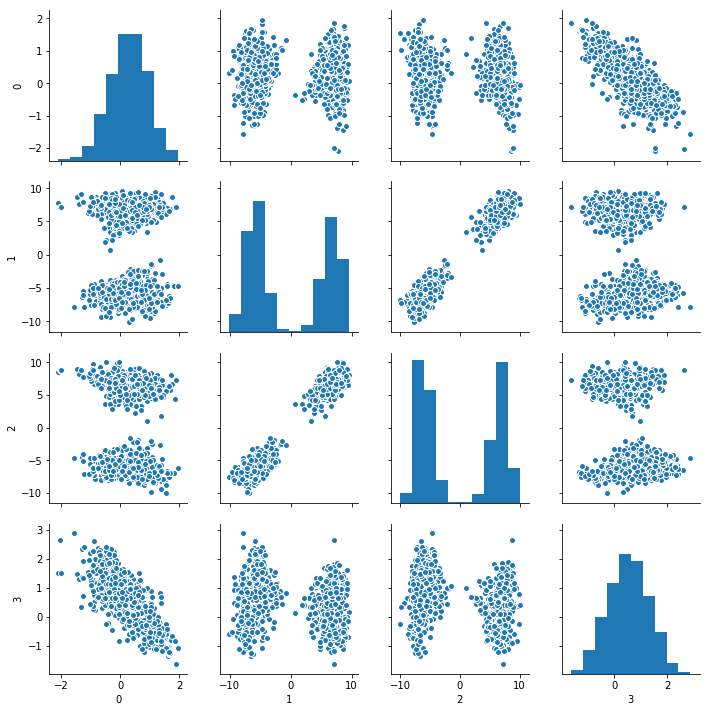

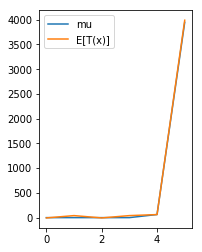

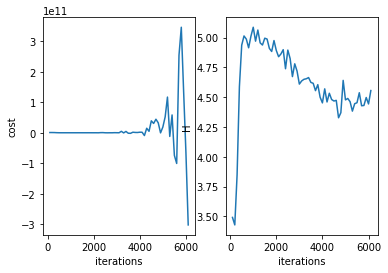

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6200 
H 4.5182967731858215
cost 1379413159798.0884


<Figure size 432x288 with 0 Axes>

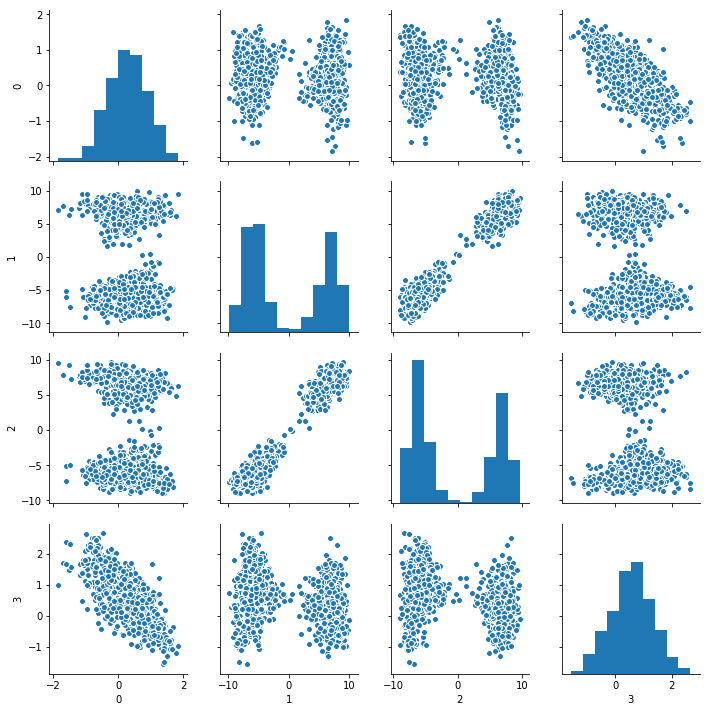

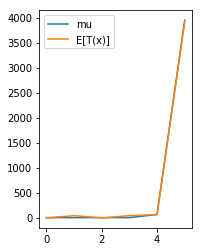

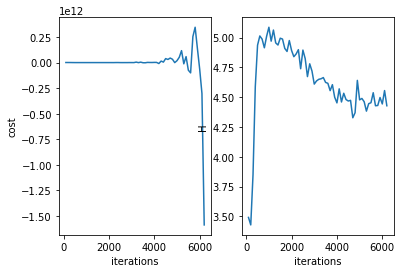

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6300 
H 4.463617287725903
cost 1665854223510.4204


<Figure size 432x288 with 0 Axes>

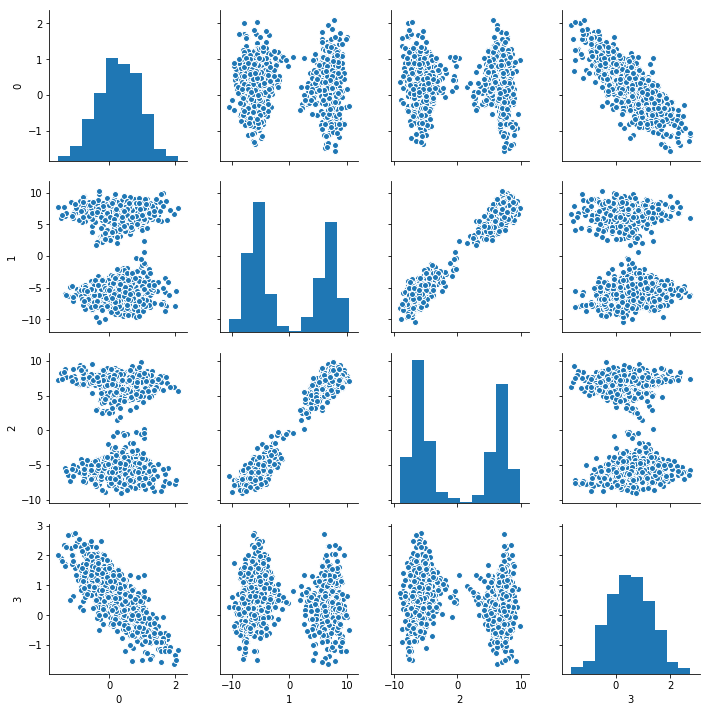

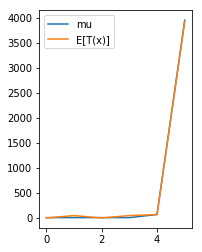

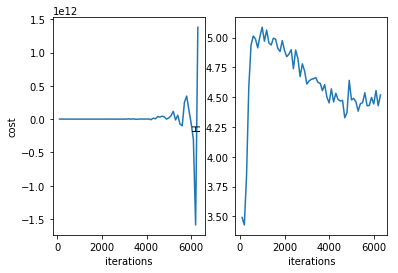

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6400 
H 4.509988085146672
cost -638021612587.4126


<Figure size 432x288 with 0 Axes>

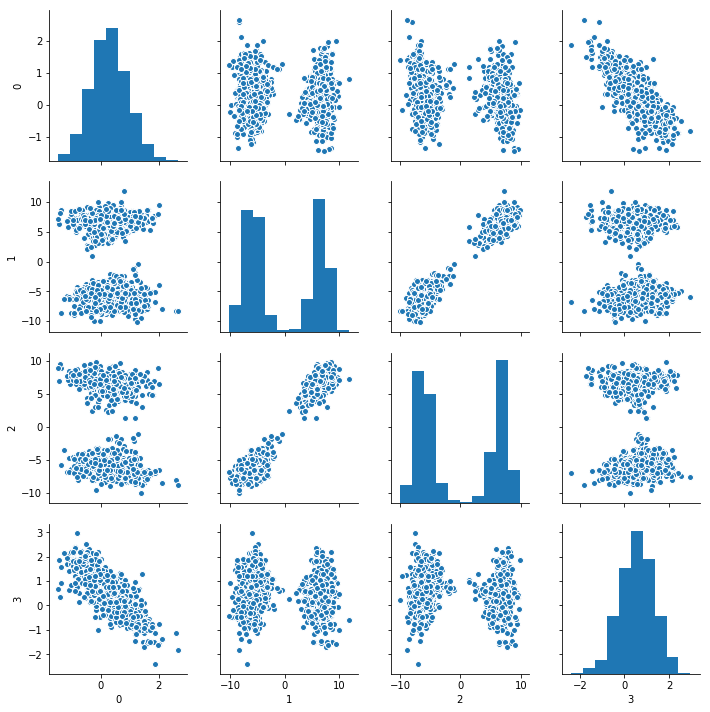

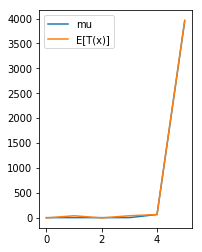

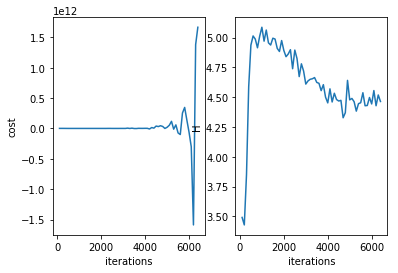

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6500 
H 4.460228995227473
cost -2873770655951.4263


<Figure size 432x288 with 0 Axes>

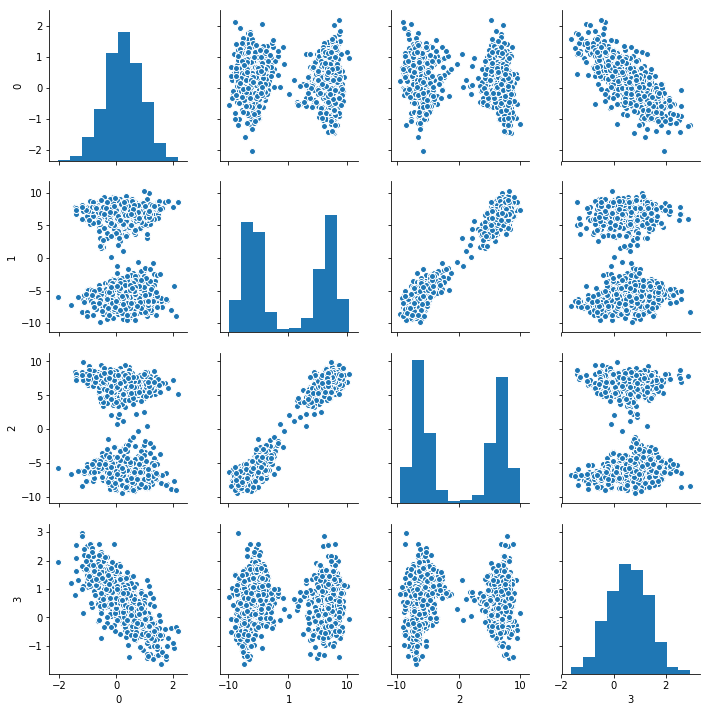

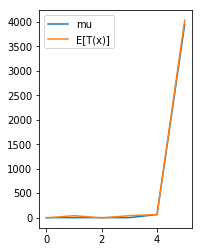

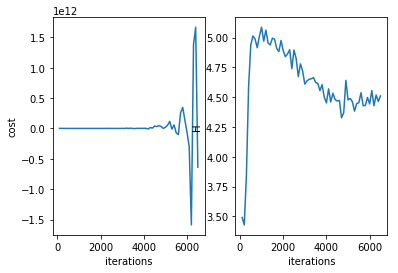

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6600 
H 4.497915329573897
cost 737275548400.3076


<Figure size 432x288 with 0 Axes>

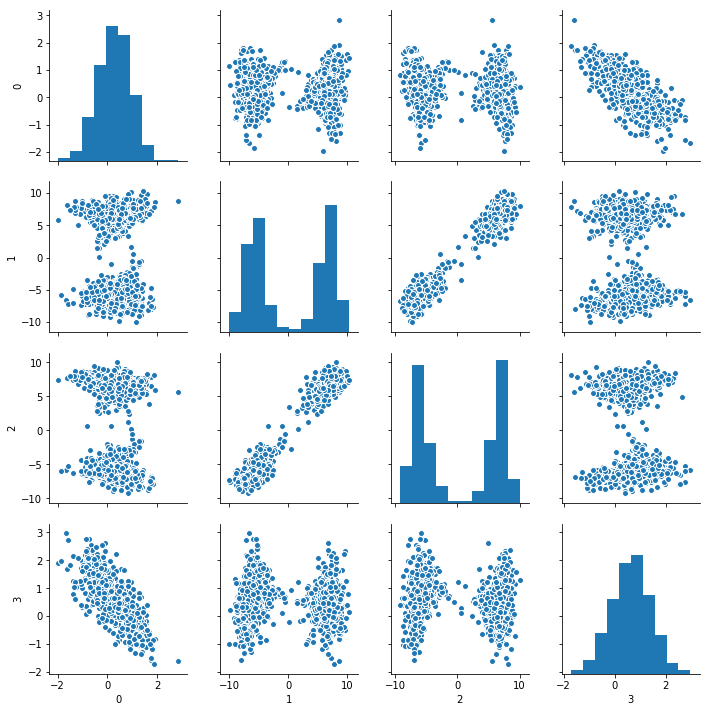

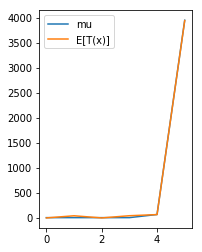

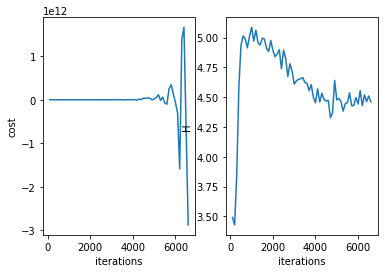

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6700 
H 4.37965773761795
cost 1226431900543.1116


<Figure size 432x288 with 0 Axes>

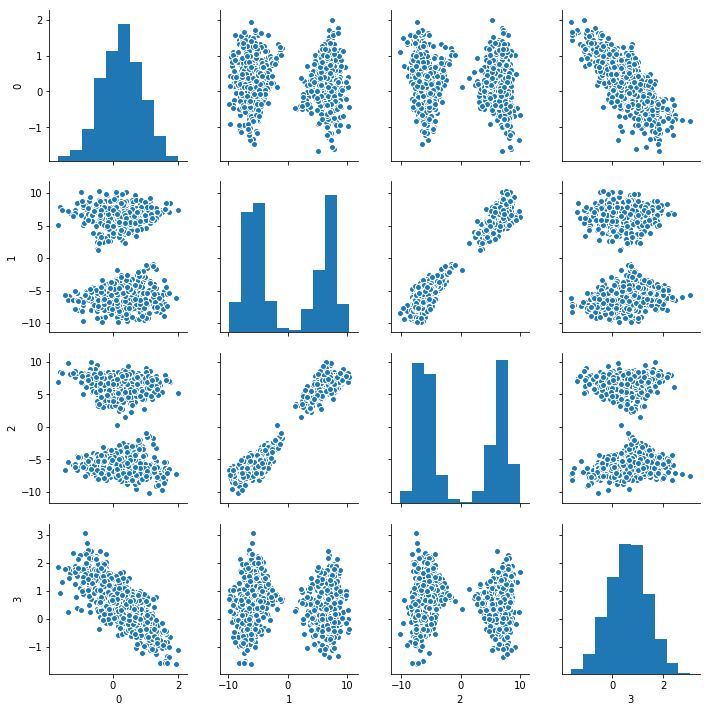

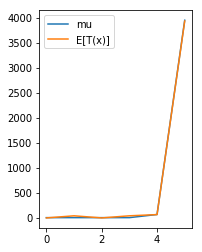

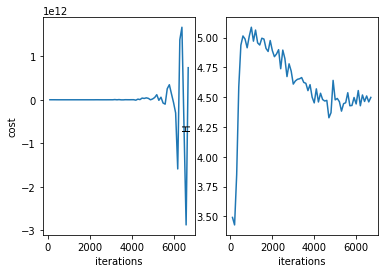

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6800 
H 4.471345798504337
cost -4037561305630.3135


<Figure size 432x288 with 0 Axes>

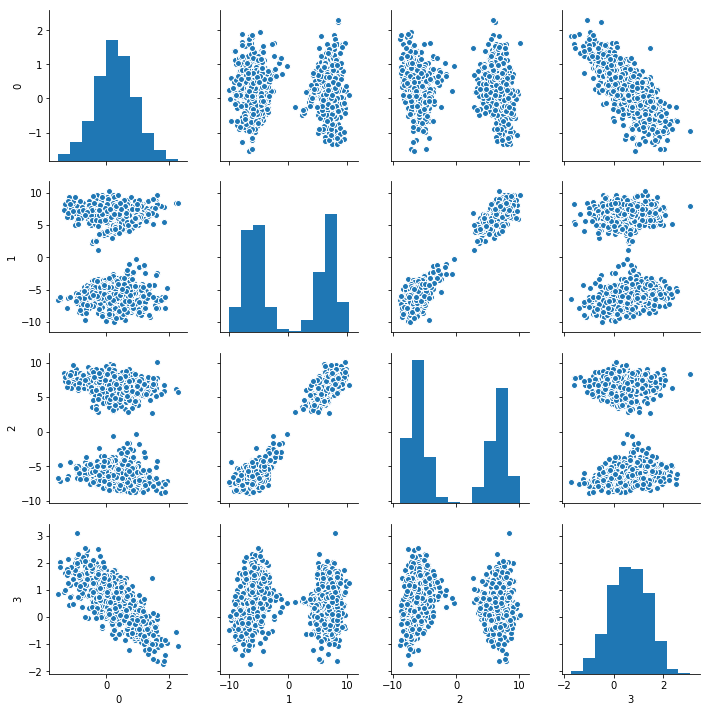

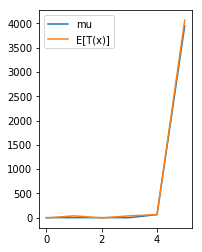

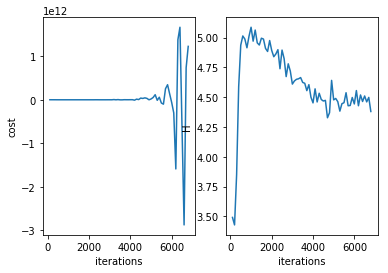

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 6900 
H 4.391888868277451
cost 728509412201.6351


<Figure size 432x288 with 0 Axes>

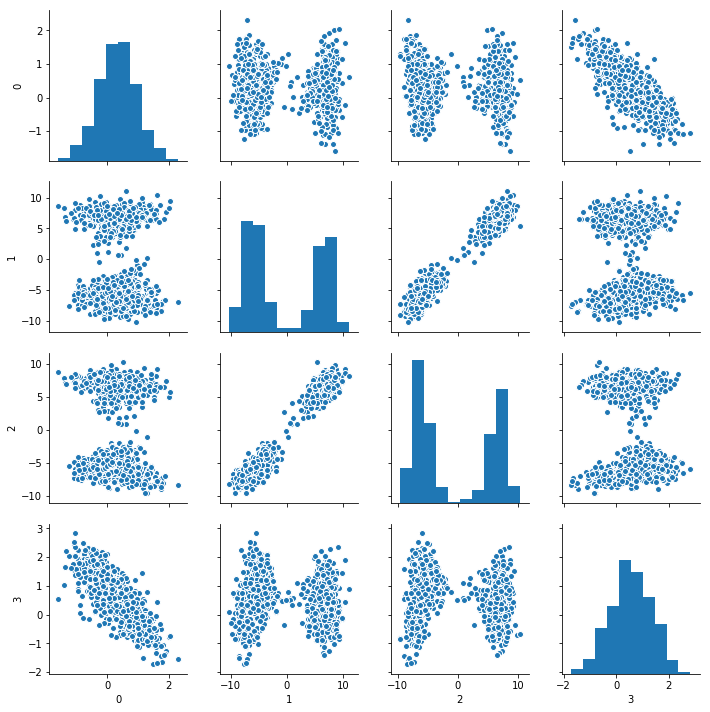

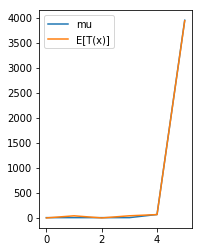

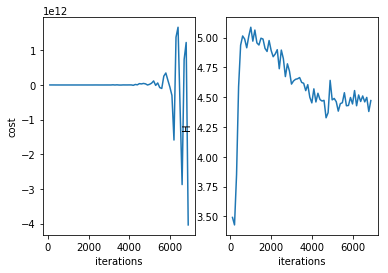

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7000 
H 4.42898857660773
cost -1845738690528.0862


<Figure size 432x288 with 0 Axes>

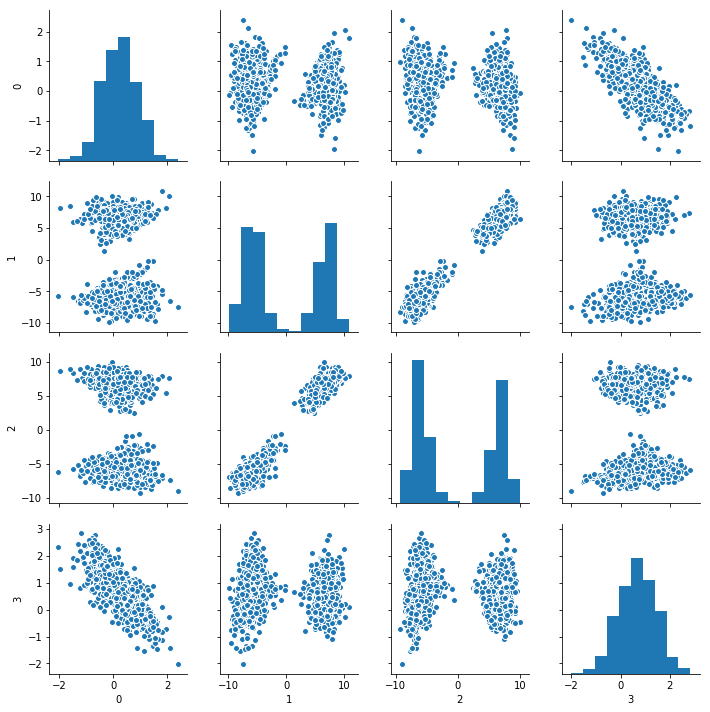

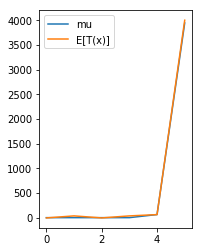

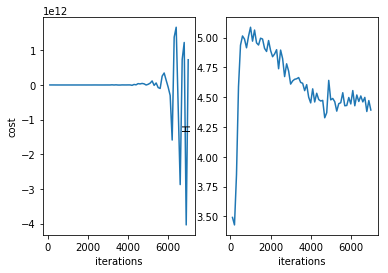

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 8
resetting optimizer
aug lag it 7
lambda [-6.57626741e+08  7.37042849e+09 -1.60834438e+09  2.67380210e+10
 -6.86899297e+09 -4.37994977e+11]
c 1000000000.0
saving model at iter 0
******************************************
it = 7100 
H 4.4866278475749315
cost 10898467213645.252


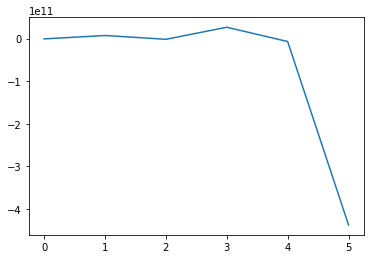

<Figure size 432x288 with 0 Axes>

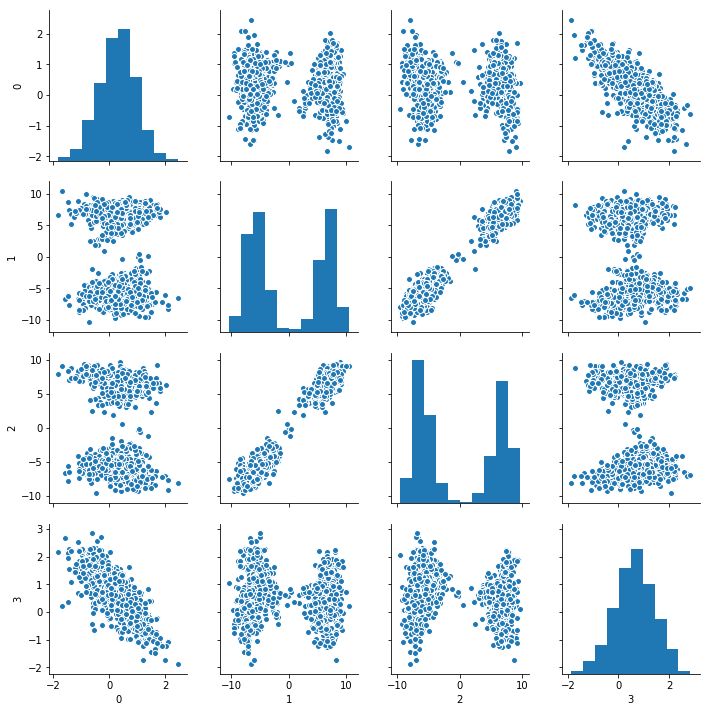

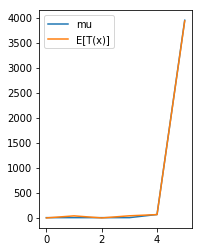

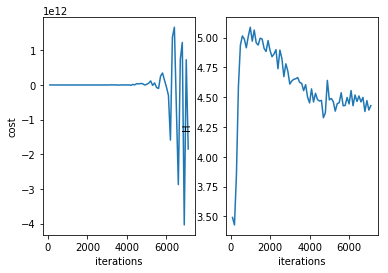

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7200 
H 4.437801892265319
cost -5268985655060.18


<Figure size 432x288 with 0 Axes>

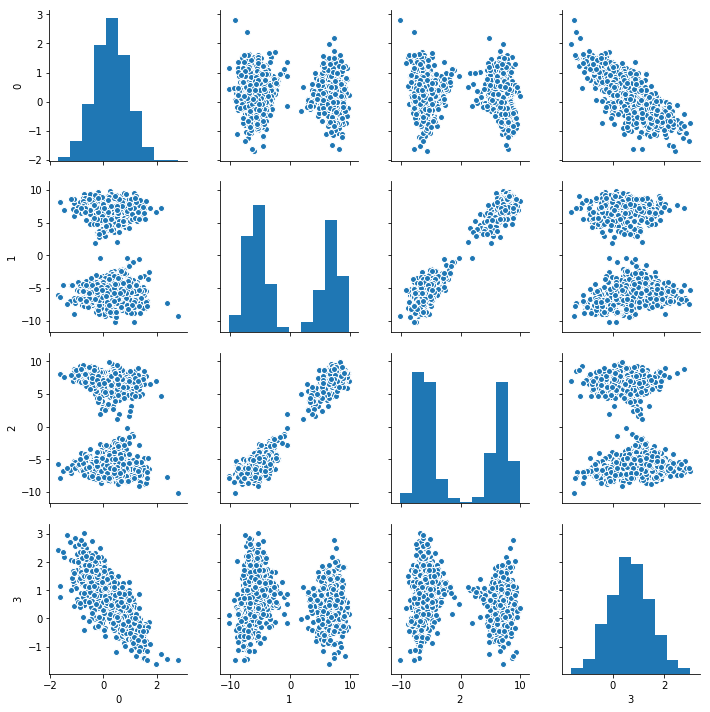

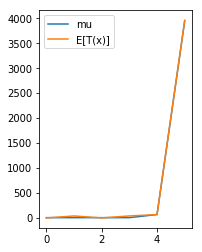

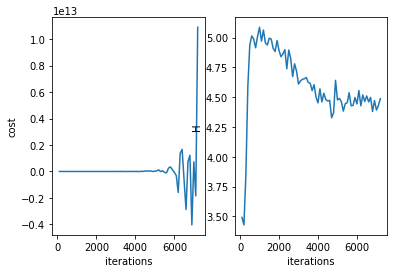

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7300 
H 4.468690101320203
cost -14317786572144.219


<Figure size 432x288 with 0 Axes>

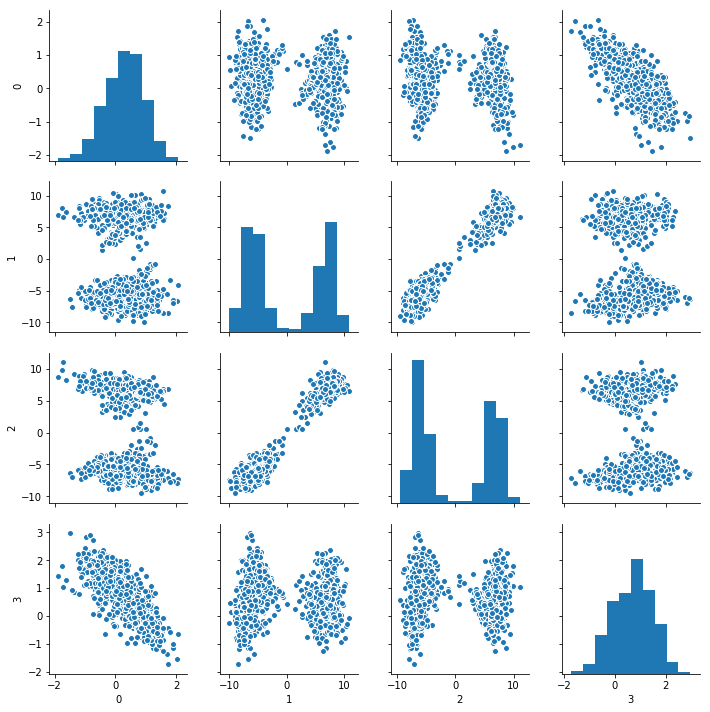

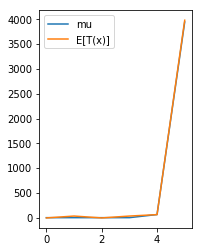

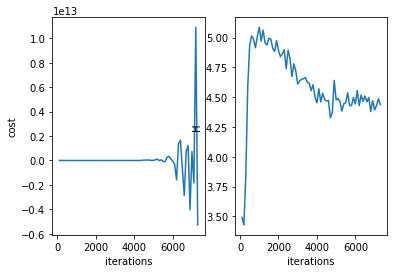

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7400 
H 4.566742281051275
cost -27580348016799.008


<Figure size 432x288 with 0 Axes>

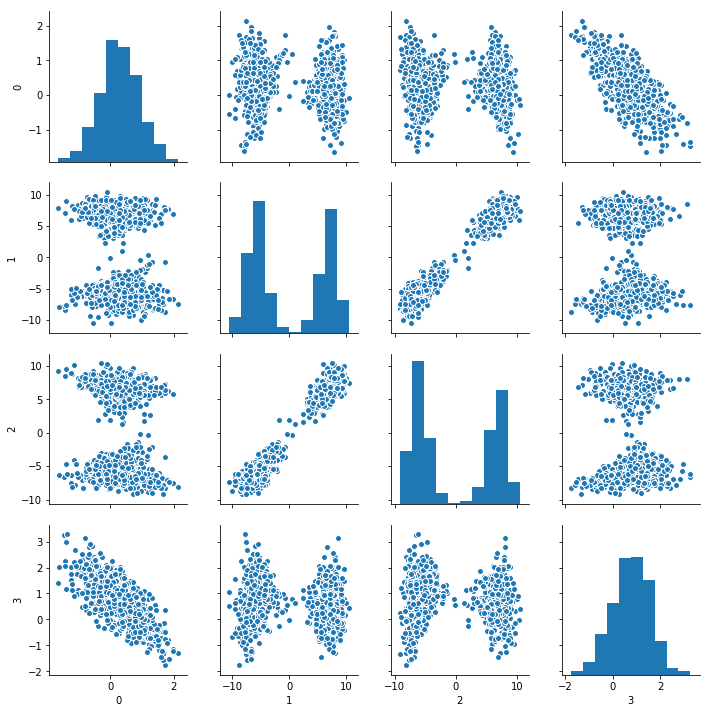

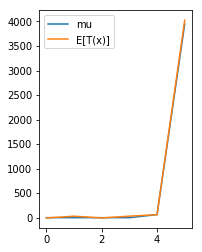

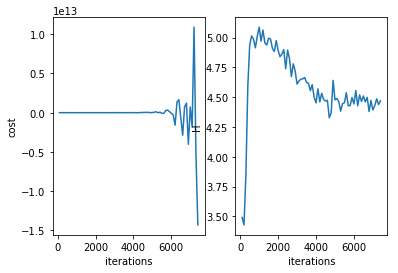

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7500 
H 4.466963484513104
cost -14840247528804.436


<Figure size 432x288 with 0 Axes>

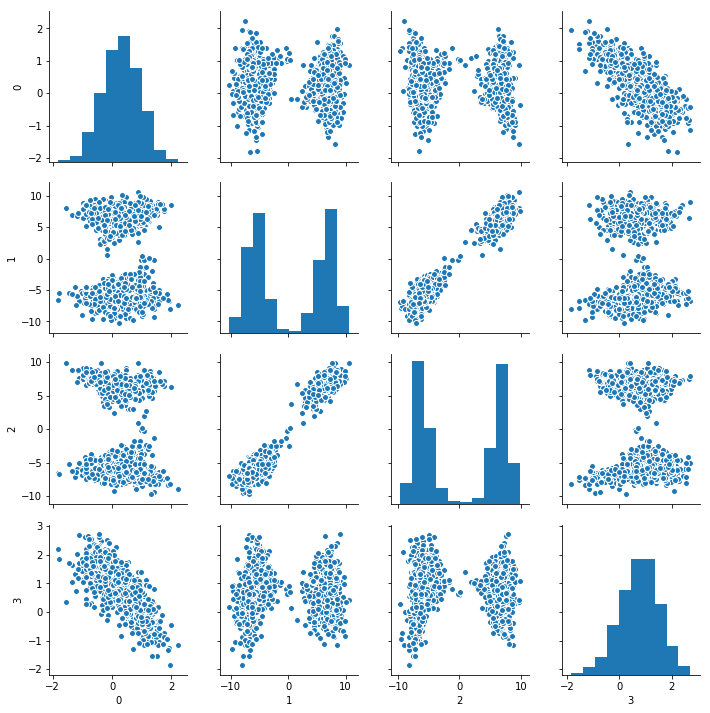

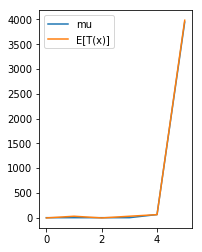

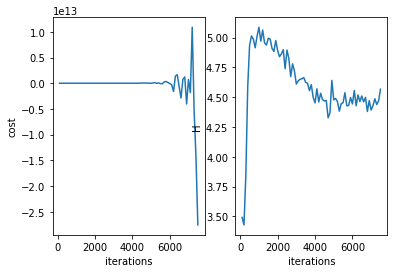

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7600 
H 4.443381396000656
cost 23592027792794.13


<Figure size 432x288 with 0 Axes>

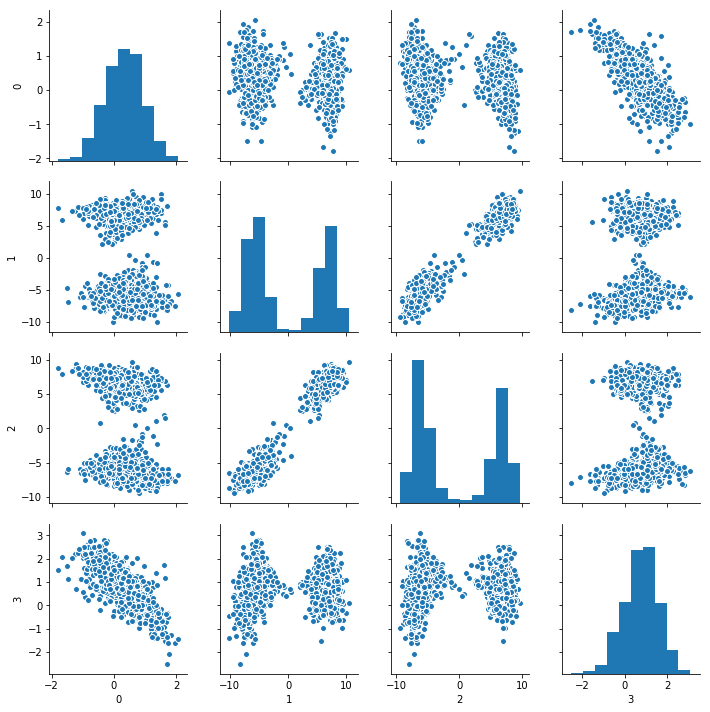

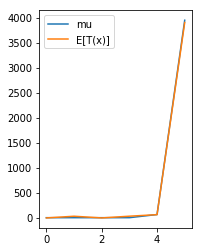

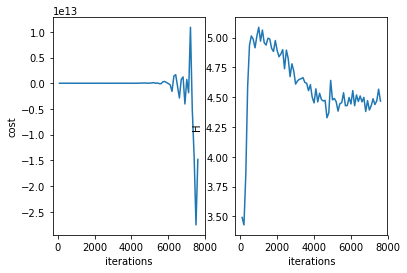

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7700 
H 4.406053721668422
cost -15133196455094.605


<Figure size 432x288 with 0 Axes>

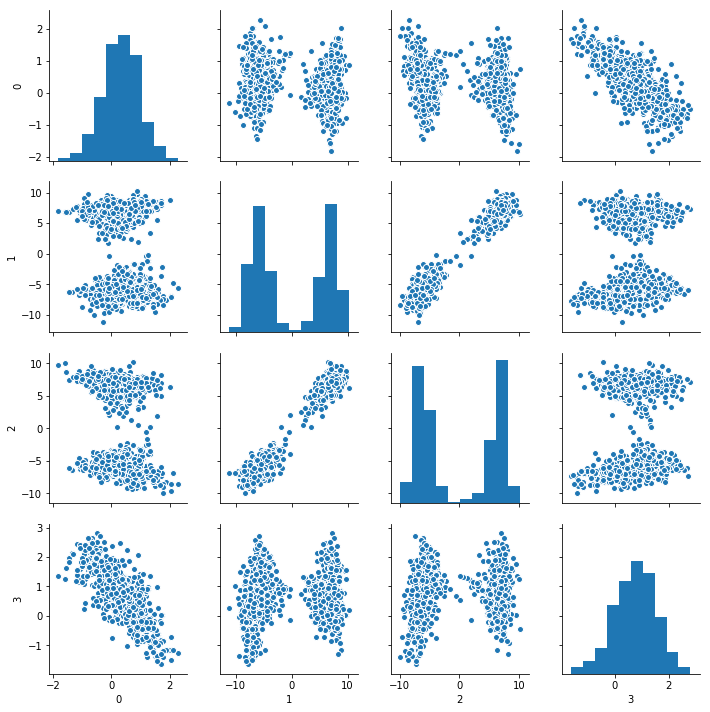

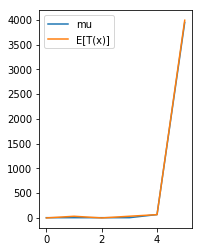

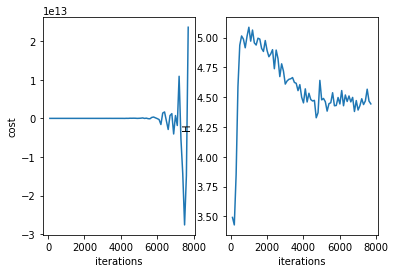

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7800 
H 4.431512899253927
cost -7184673952308.47


<Figure size 432x288 with 0 Axes>

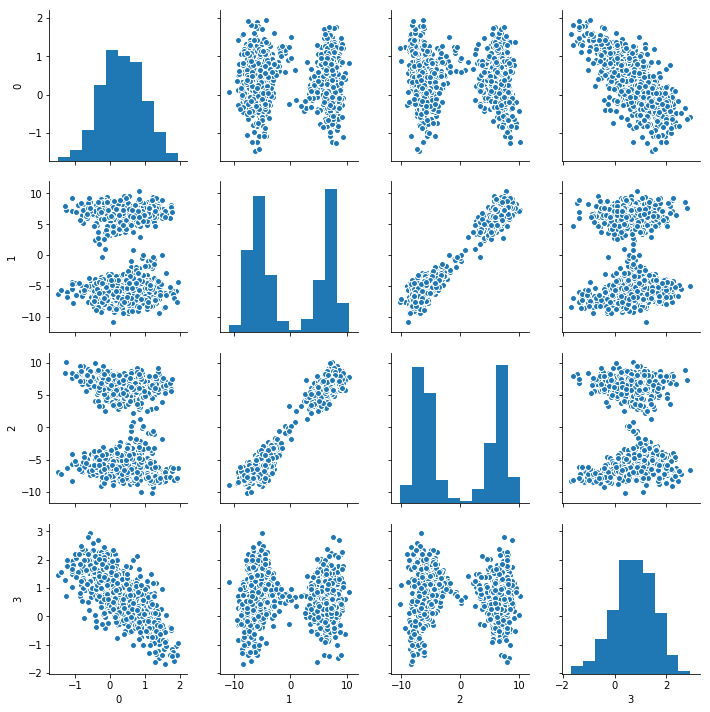

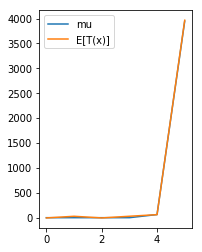

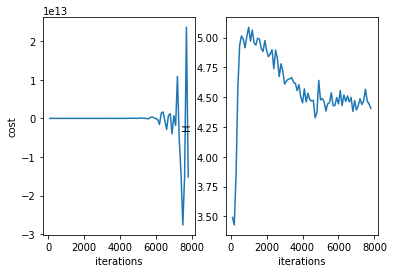

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 7900 
H 4.3829744374484605
cost -11750677151686.715


<Figure size 432x288 with 0 Axes>

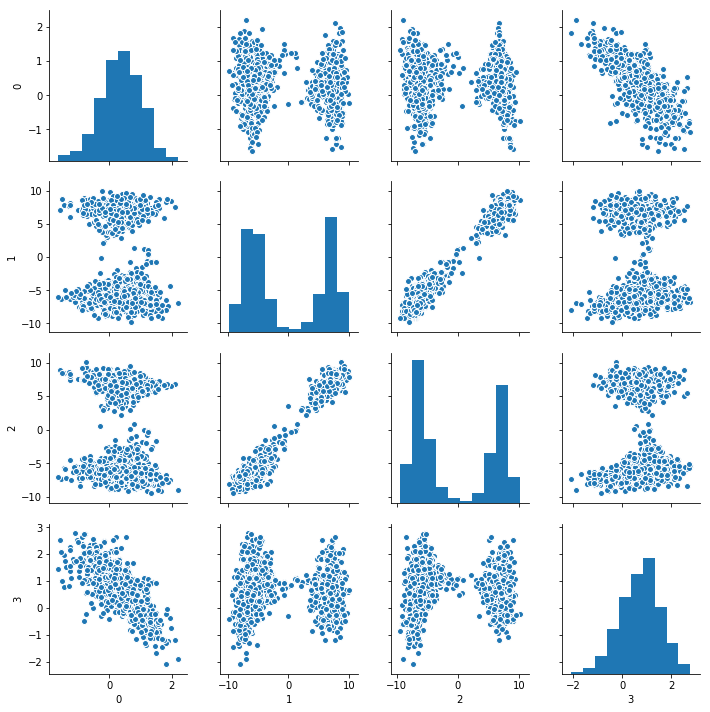

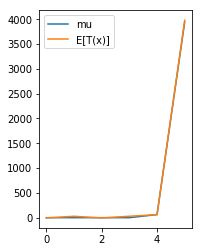

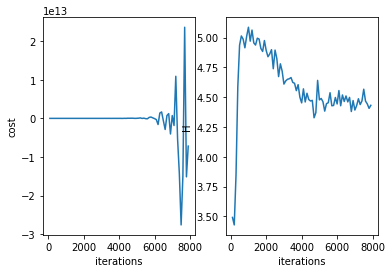

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8000 
H 4.388540809075401
cost 43363841778718.27


<Figure size 432x288 with 0 Axes>

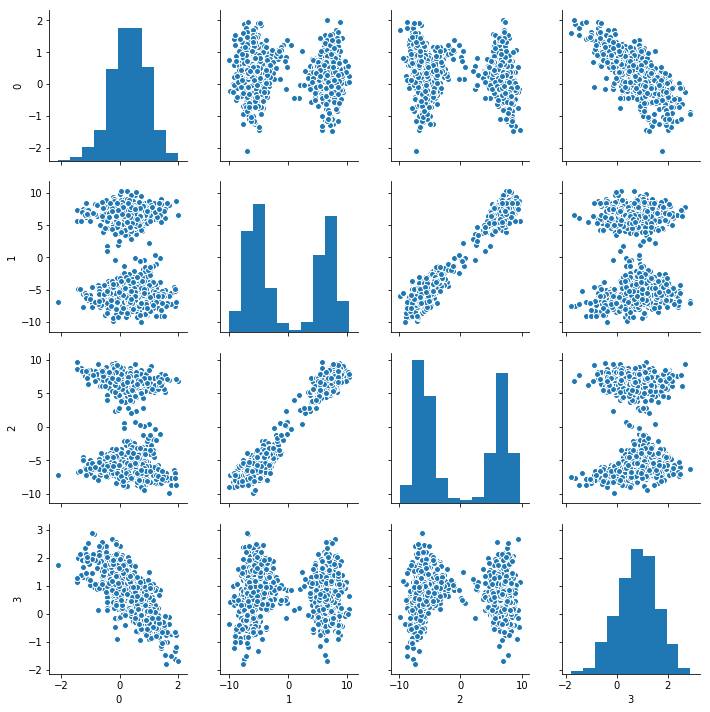

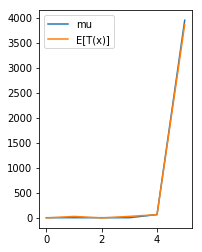

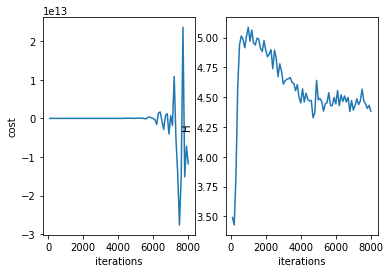

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 9
resetting optimizer
aug lag it 8
lambda [-6.57626800e+09  7.37042915e+10 -1.60834453e+10  2.67380234e+11
 -6.86899358e+10 -4.37995016e+12]
c 10000000000.0
saving model at iter 0
Doubling memory allocation for parameter logging.
******************************************
it = 8100 
H 4.377895753251552
cost 479861724484019.0


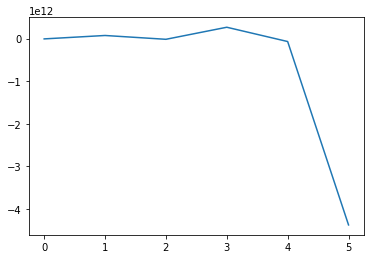

<Figure size 432x288 with 0 Axes>

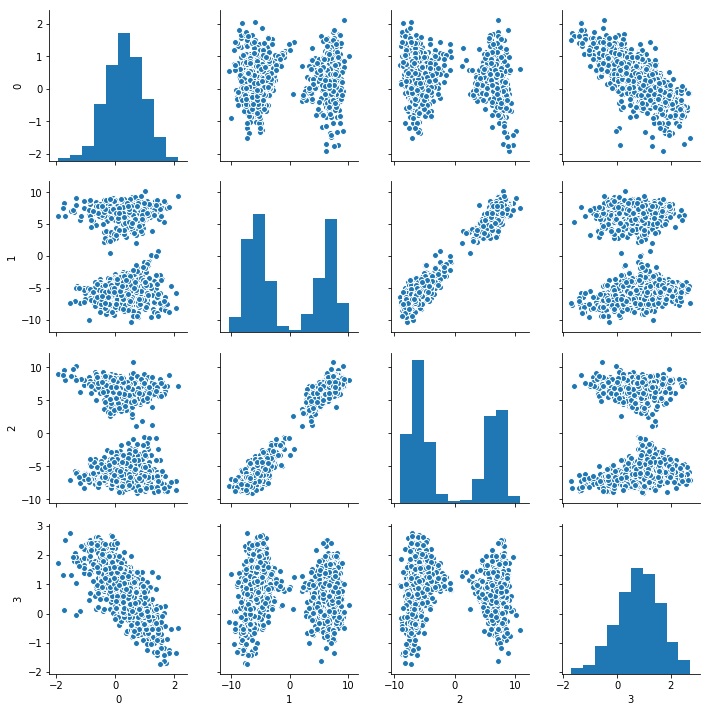

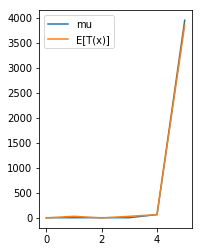

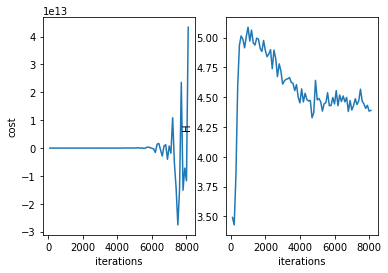

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8200 
H 4.435076528109898
cost -17093410888309.344


<Figure size 432x288 with 0 Axes>

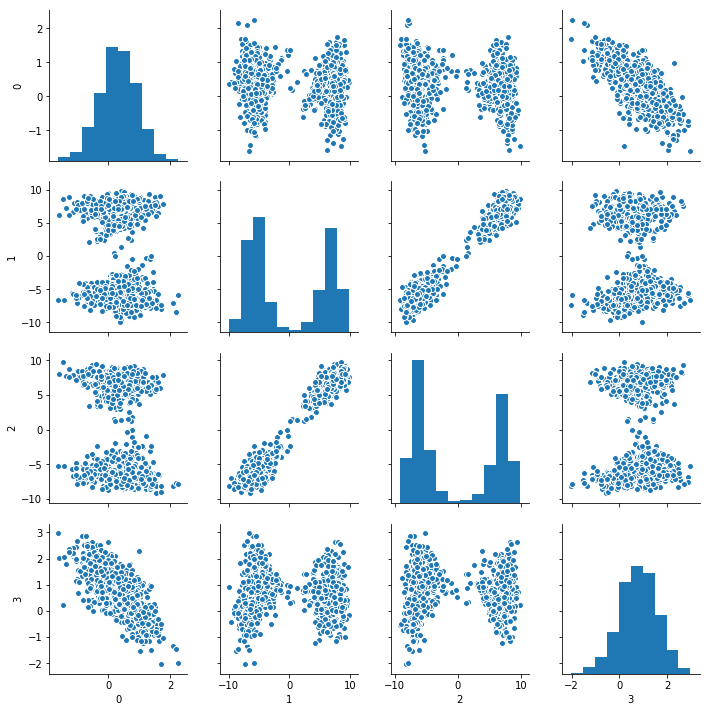

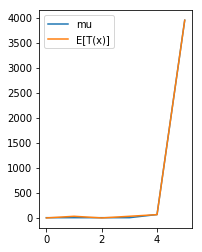

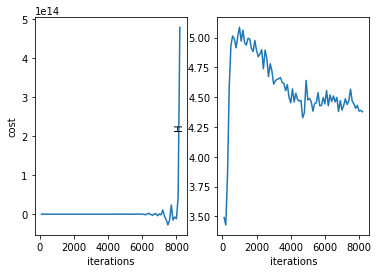

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8300 
H 4.45571089120659
cost -334444409949556.6


<Figure size 432x288 with 0 Axes>

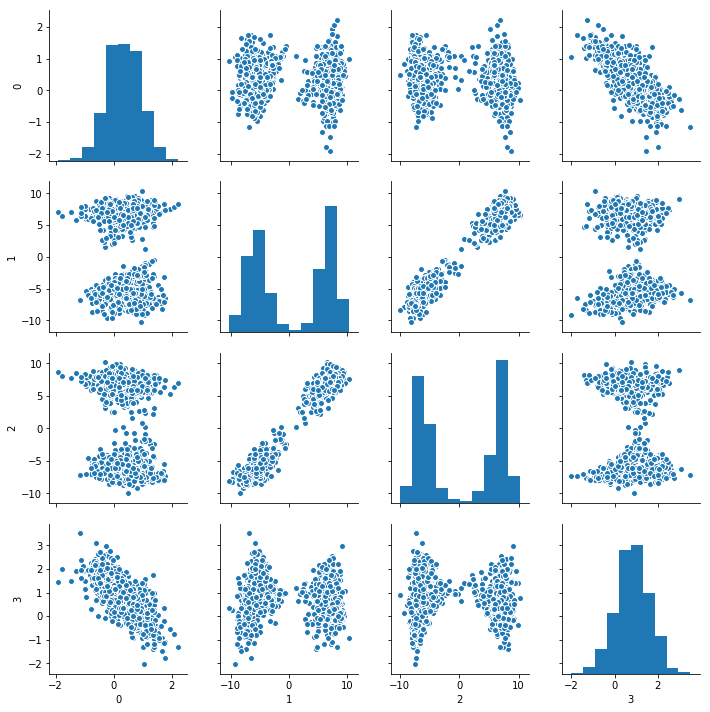

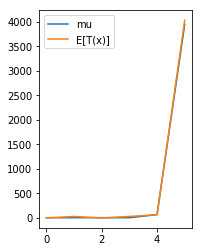

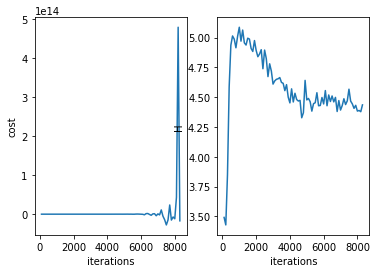

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8400 
H 4.415268811207161
cost -14057809778682.754


<Figure size 432x288 with 0 Axes>

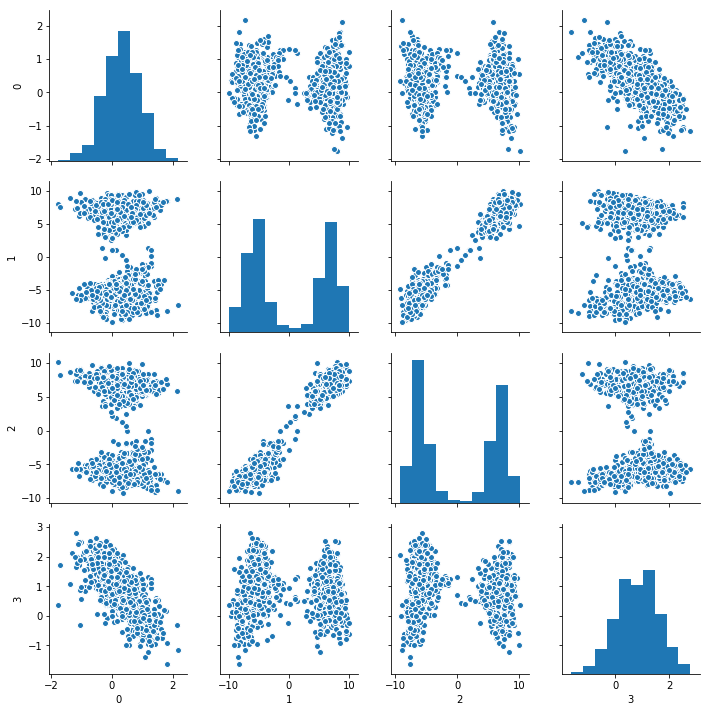

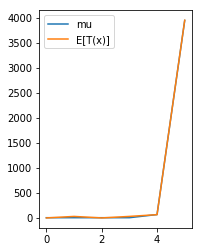

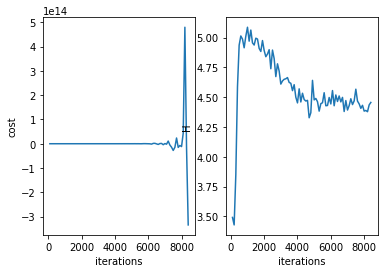

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8500 
H 4.4761976994672805
cost -386104403204431.9


<Figure size 432x288 with 0 Axes>

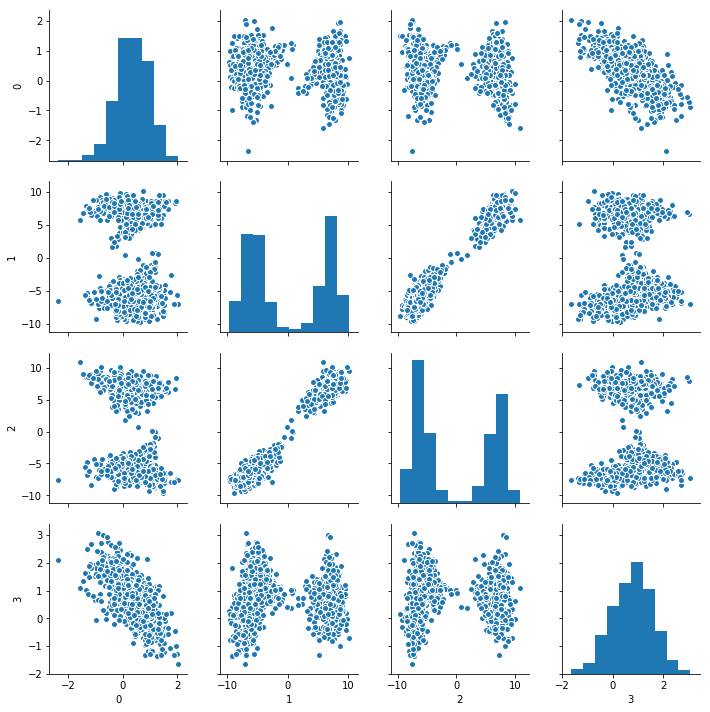

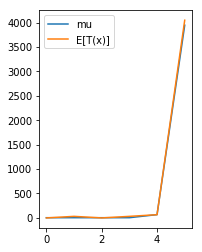

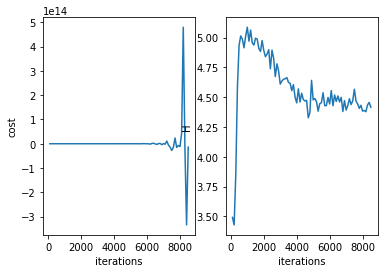

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8600 
H 4.460988067346781
cost 225703343369775.6


<Figure size 432x288 with 0 Axes>

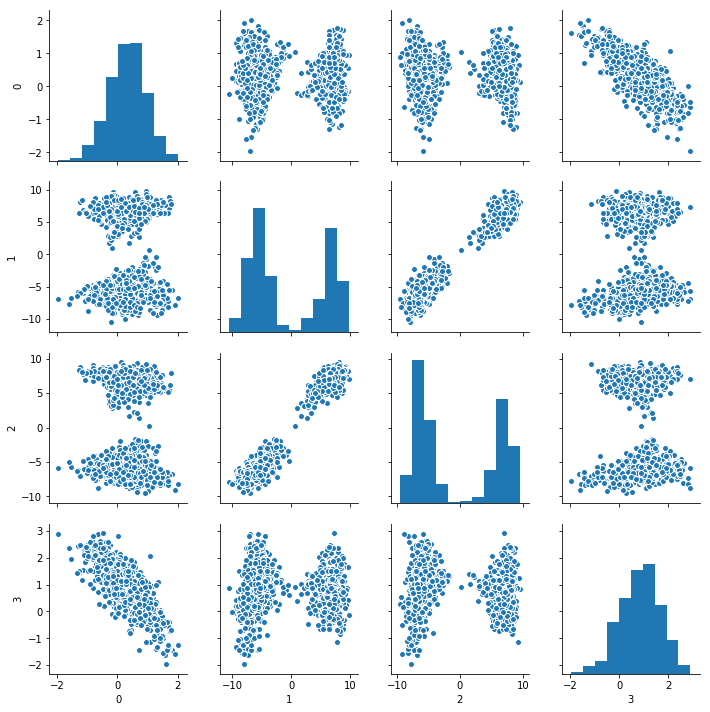

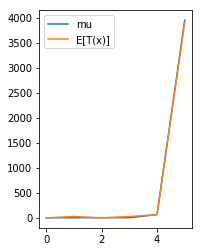

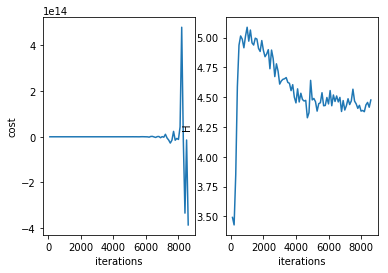

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8700 
H 4.427143426715569
cost 184871122327182.84


<Figure size 432x288 with 0 Axes>

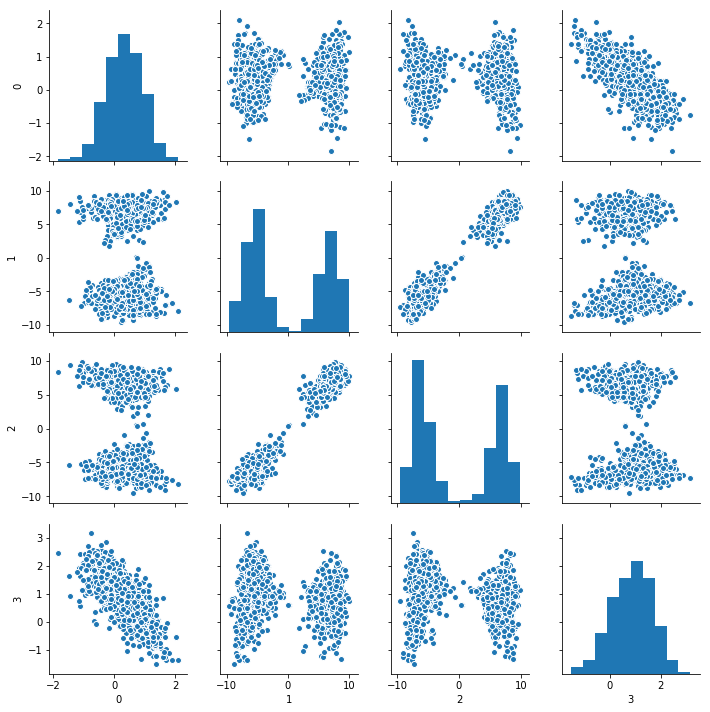

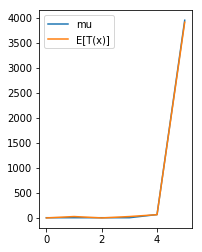

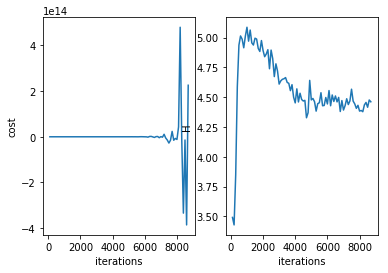

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8800 
H 4.46669200600618
cost -50903602188785.67


<Figure size 432x288 with 0 Axes>

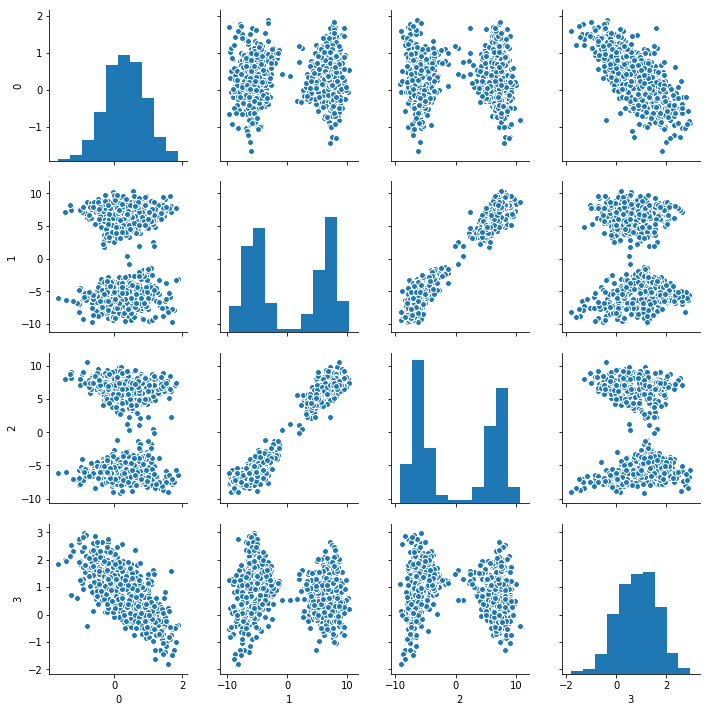

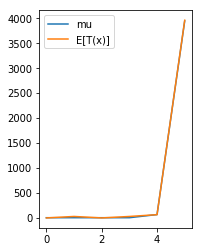

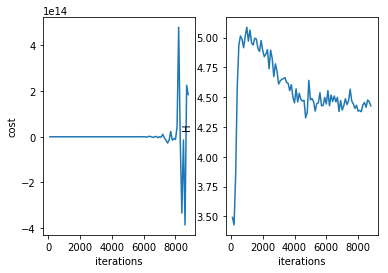

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 8900 
H 4.462556313293622
cost 124162535930793.16


<Figure size 432x288 with 0 Axes>

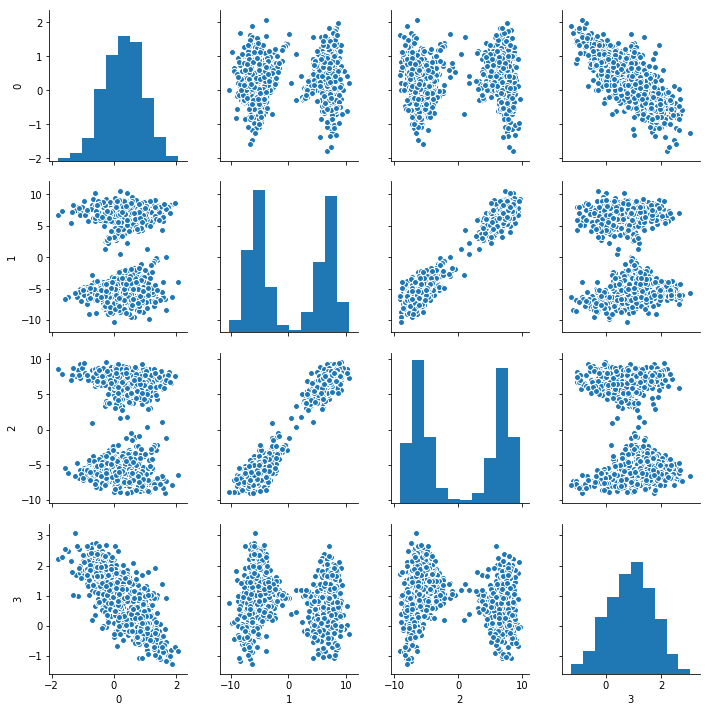

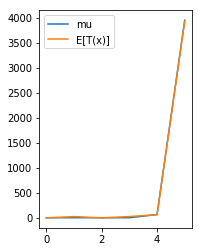

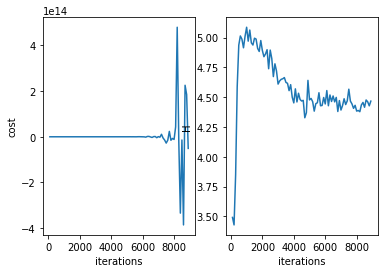

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9000 
H 4.480843531797441
cost -96501180427991.89


<Figure size 432x288 with 0 Axes>

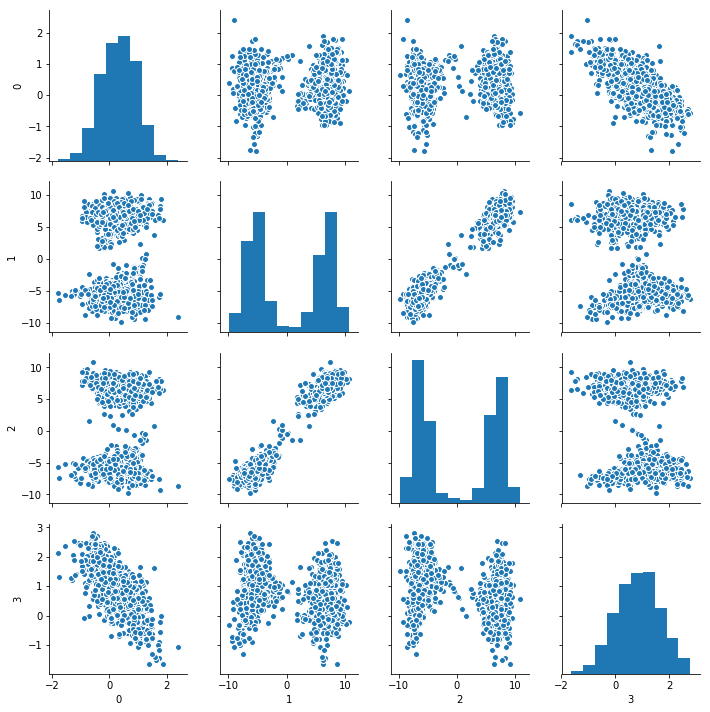

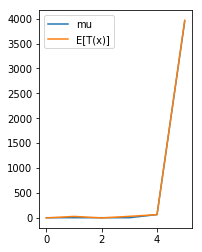

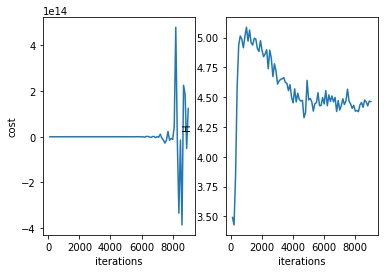

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/
AL iteration 10
resetting optimizer
aug lag it 9
lambda [-6.57626806e+10  7.37042922e+11 -1.60834454e+11  2.67380236e+12
 -6.86899365e+11 -4.37995020e+13]
c 100000000000.0
saving model at iter 0
******************************************
it = 9100 
H 4.437175546039935
cost 84163177551792.33


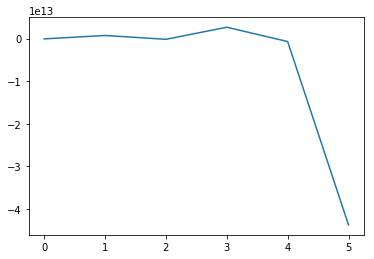

<Figure size 432x288 with 0 Axes>

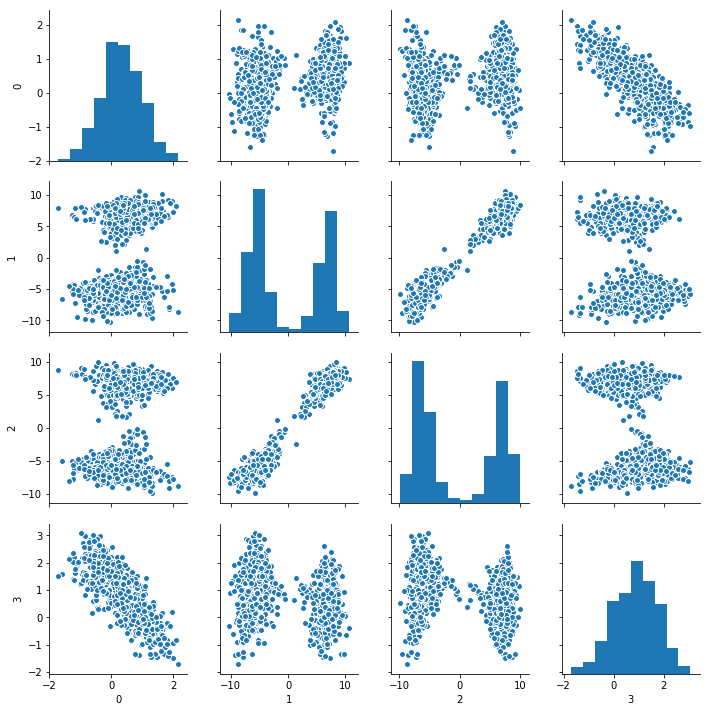

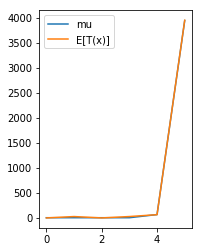

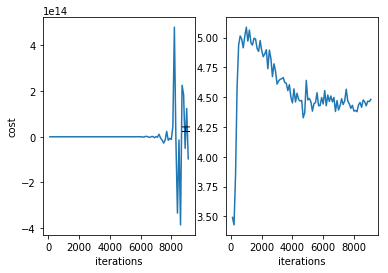

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9200 
H 4.479201880364655
cost -1362237833089426.2


<Figure size 432x288 with 0 Axes>

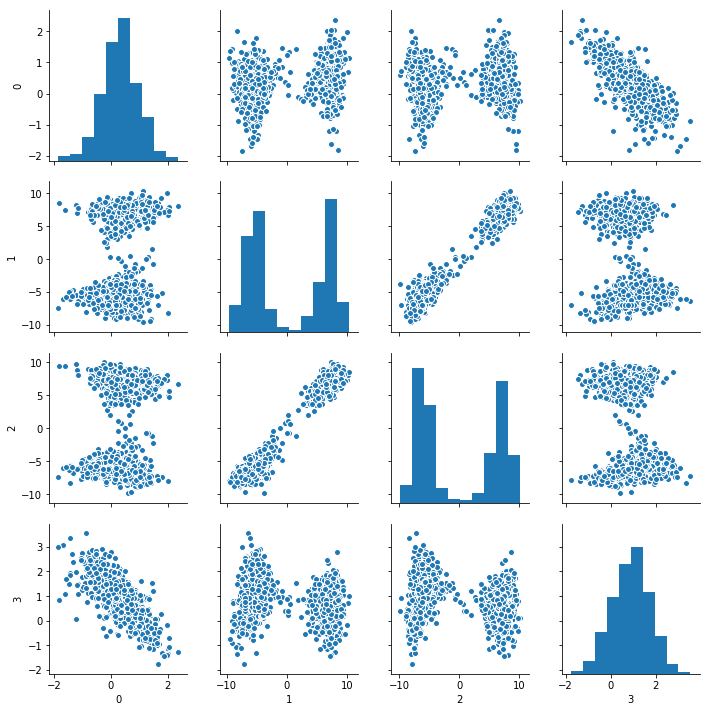

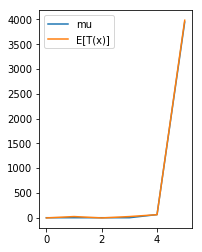

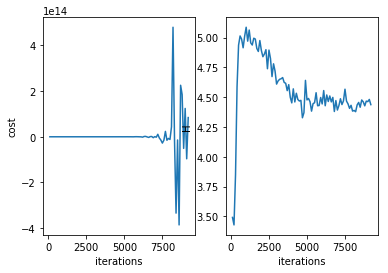

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9300 
H 4.443874236164713
cost -4759408340898053.0


<Figure size 432x288 with 0 Axes>

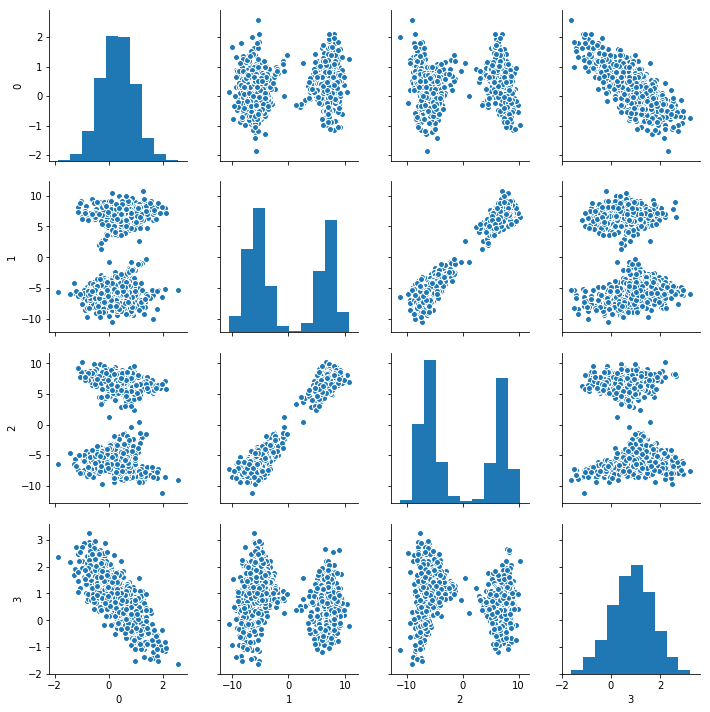

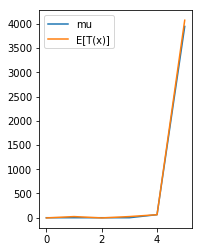

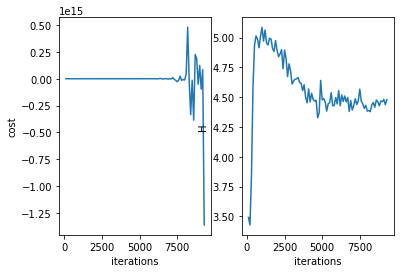

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9400 
H 4.47880650833552
cost -2391146237525405.5


<Figure size 432x288 with 0 Axes>

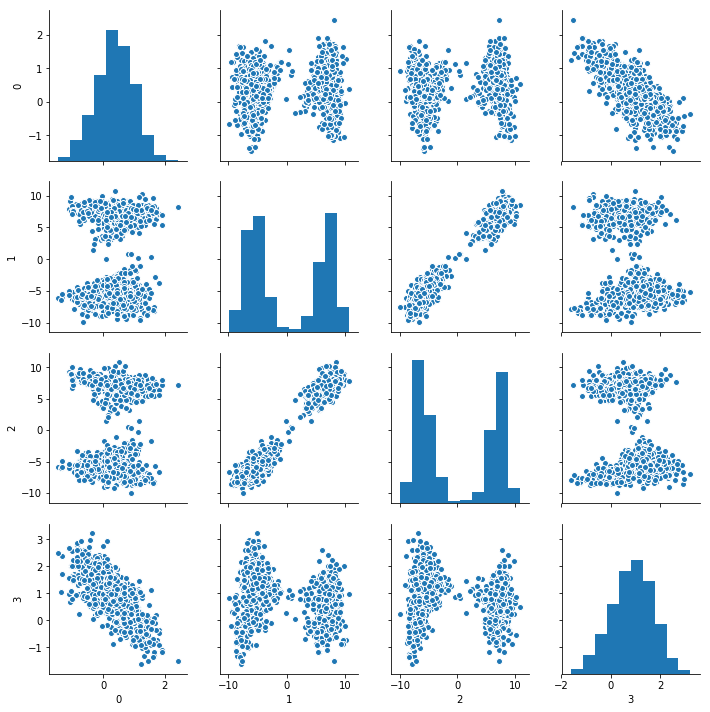

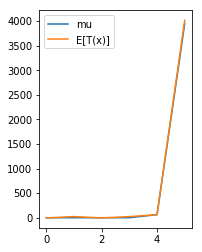

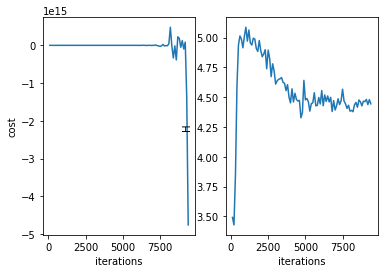

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9500 
H 4.51301746688063
cost -364452800464096.44


<Figure size 432x288 with 0 Axes>

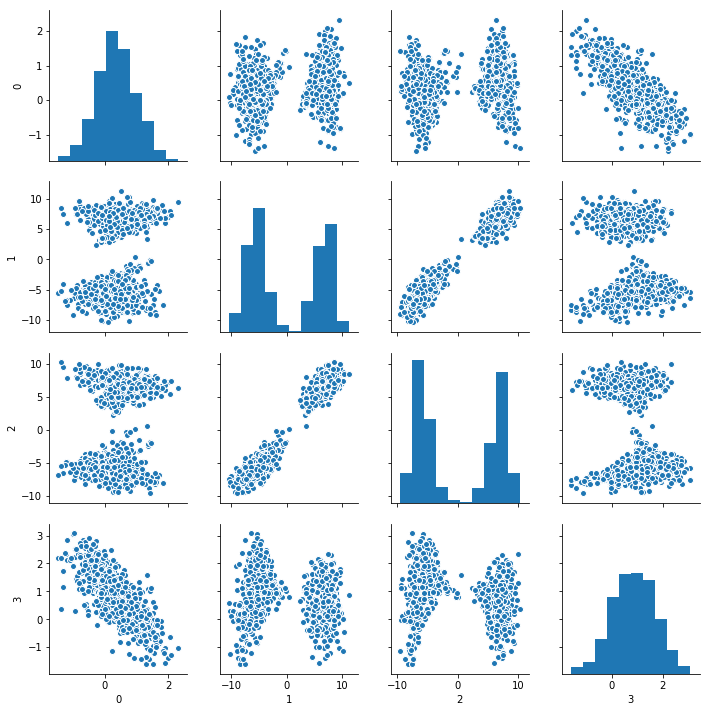

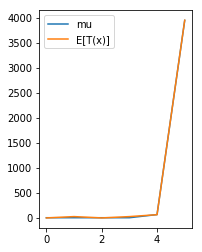

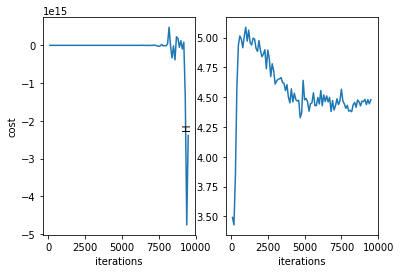

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9600 
H 4.405560978542437
cost 2334987349340880.0


<Figure size 432x288 with 0 Axes>

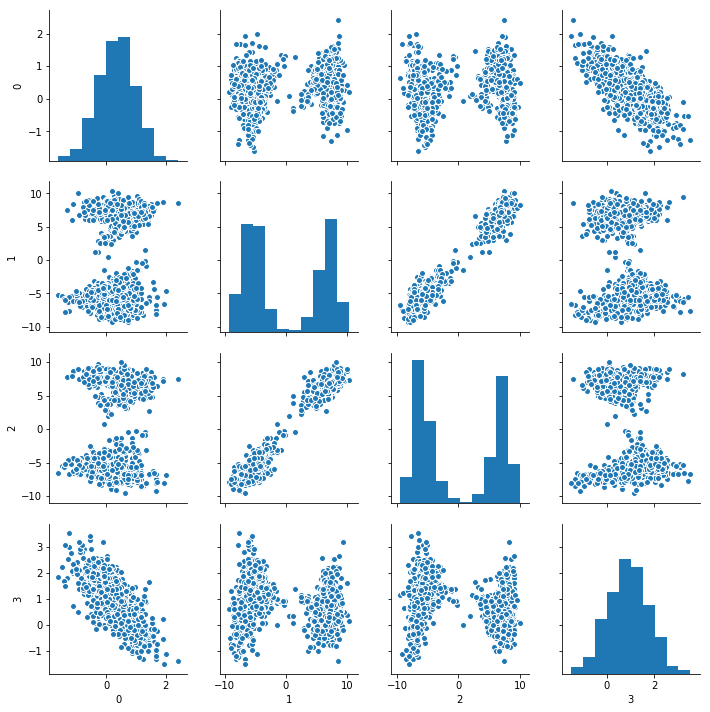

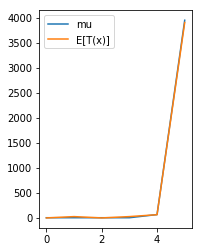

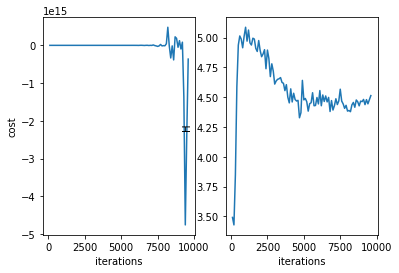

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9700 
H 4.550129270161155
cost -4531296484782308.0


<Figure size 432x288 with 0 Axes>

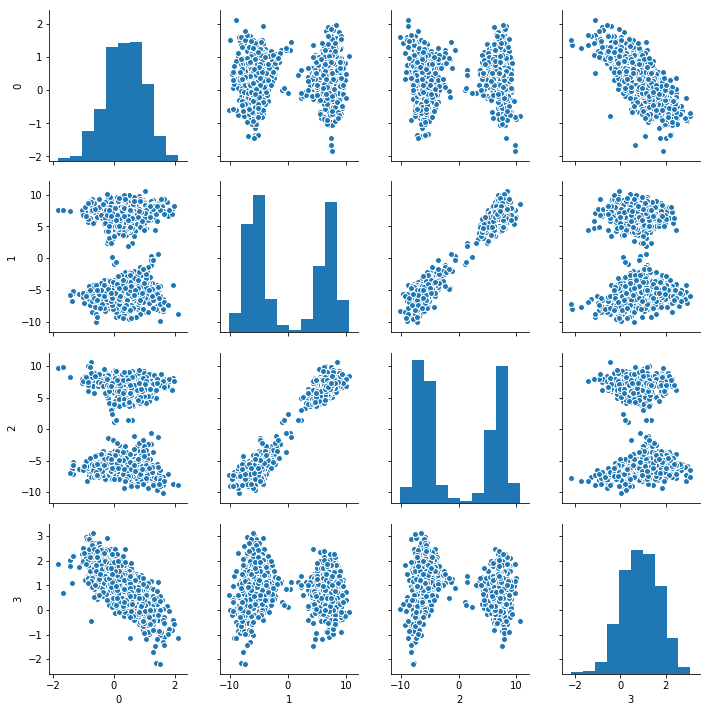

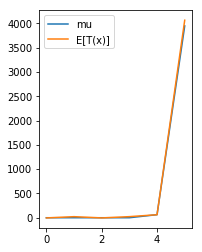

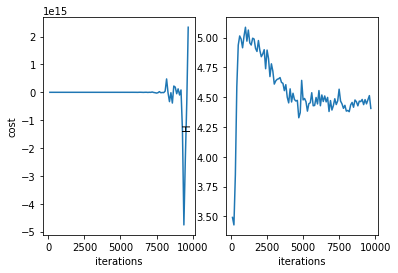

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9800 
H 4.515610924130869
cost 1085536083209867.6


<Figure size 432x288 with 0 Axes>

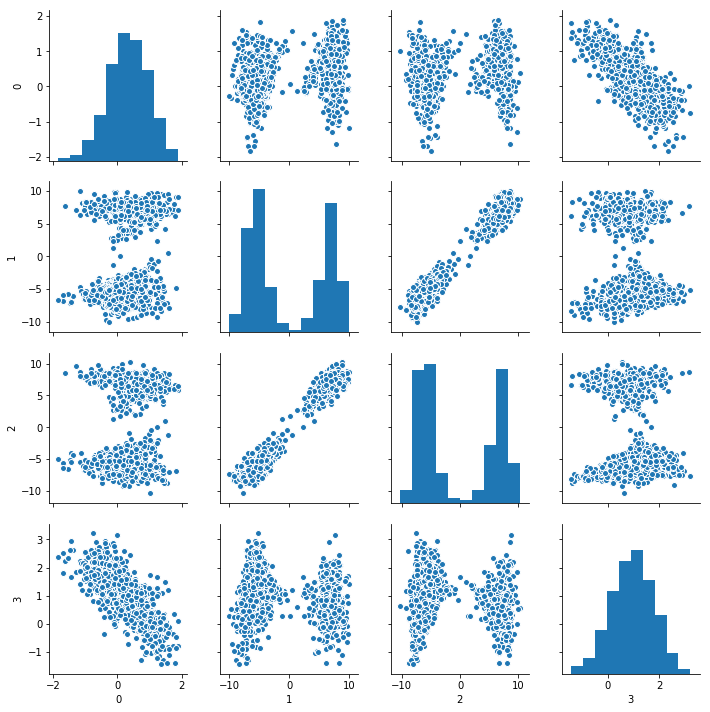

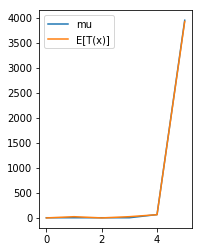

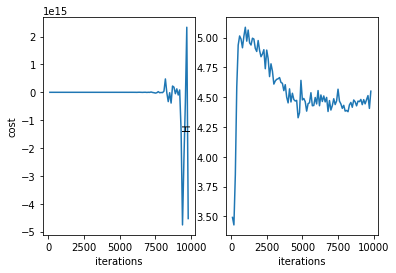

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 9900 
H 4.551990473828783
cost -3018701009635712.0


<Figure size 432x288 with 0 Axes>

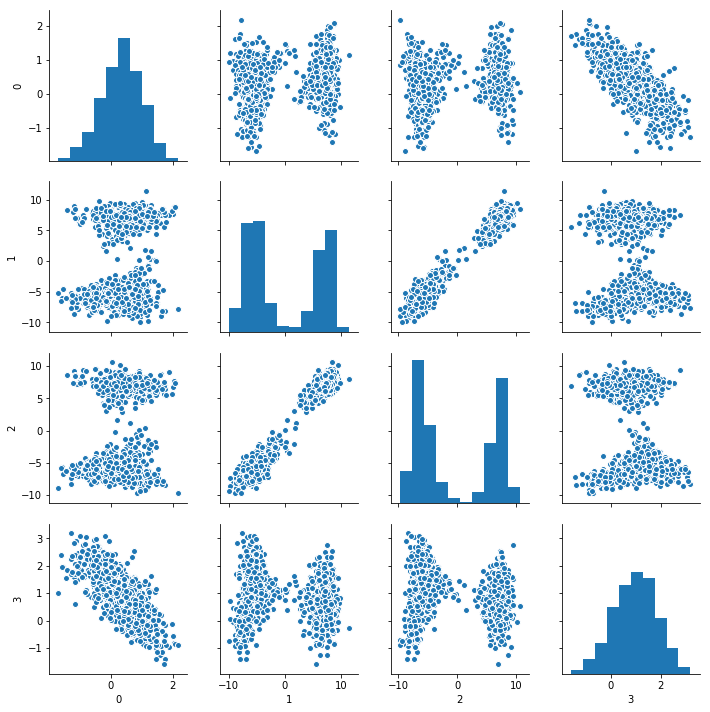

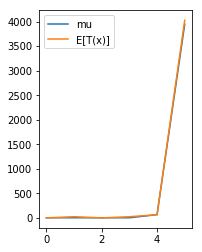

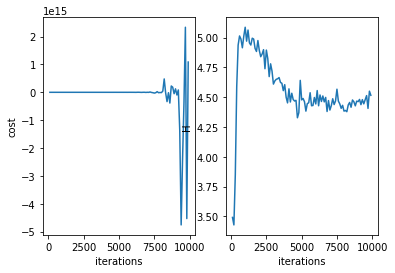

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
******************************************
it = 10000 
H 4.453876621701475
cost 1656768063080489.0


<Figure size 432x288 with 0 Axes>

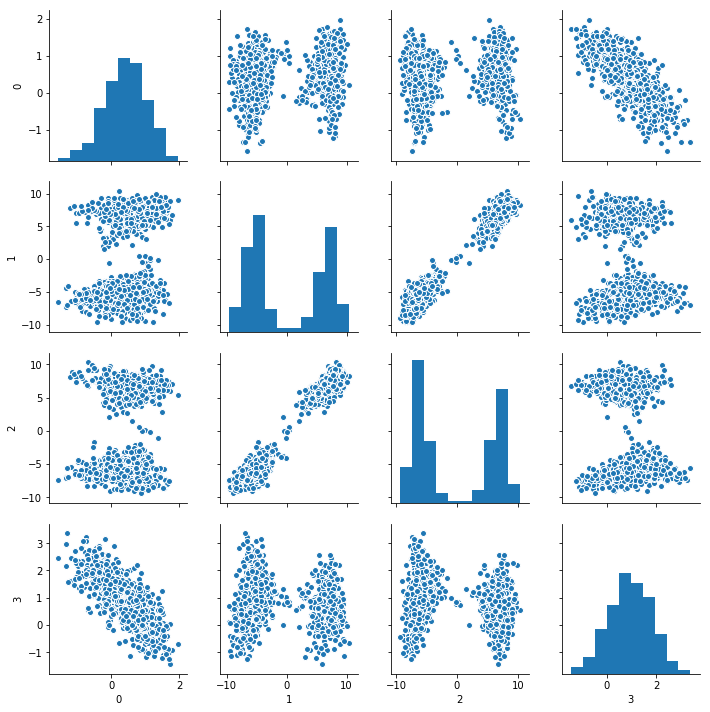

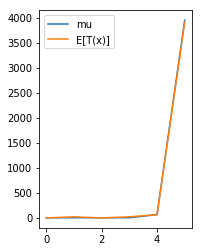

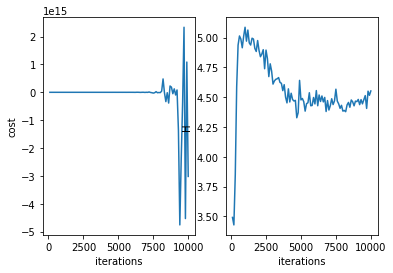

saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/  ...
******************************************
saving to results//tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=0/


In [46]:
random_seed = 0;

TIF_flow_type = 'PlanarFlowLayer';
nlayers = 10;
flow_dict = {'latent_dynamics':None, \
             'TIF_flow_type':TIF_flow_type, \
             'repeats':nlayers};

n = 1000;
k_max = 10;
c_init = 1e2;
lr_order = -3;
check_rate = 100;
max_iters = 1000;

np.random.seed(0);

cost, phi, T_x = train_dsn(system, behavior, n, flow_dict, \
                       k_max=k_max, c_init=c_init, lr_order=lr_order, check_rate=check_rate, \
                       max_iters=max_iters, random_seed=random_seed);



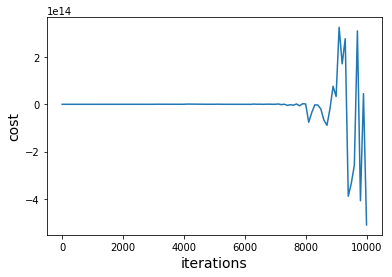

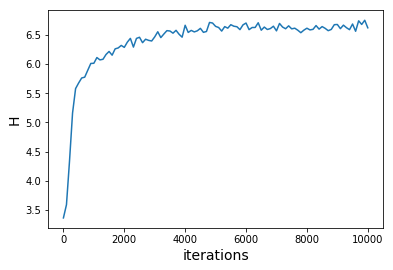

In [47]:
fontsize = 14;
savedir = '/Users/sbittner/Documents/dsn/notebooks/results/tb/linear_2D_D=4_T=1_flow=10P_lr_order=-3_c=2_rs=1/'
fname = savedir + 'results.npz';

npzfile = np.load(fname);
check_rate = npzfile['check_rate'];
costs = npzfile['costs'];
Hs = npzfile['Hs'];
T_xs = npzfile['T_xs'];
mu = npzfile['mu'];
behavior = npzfile['behavior'];
nits = costs.shape[0];
iterations = np.arange(0, check_rate*nits, check_rate);

plt.plot(iterations, costs);
plt.xlabel('iterations', fontsize=fontsize);
plt.ylabel('cost', fontsize=fontsize);
plt.show();

plt.plot(iterations, Hs);
plt.xlabel('iterations', fontsize=fontsize);
plt.ylabel('H', fontsize=fontsize);
plt.show();


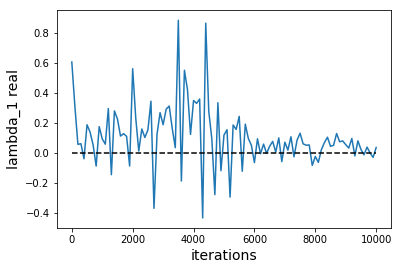

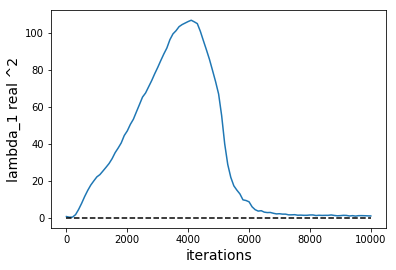

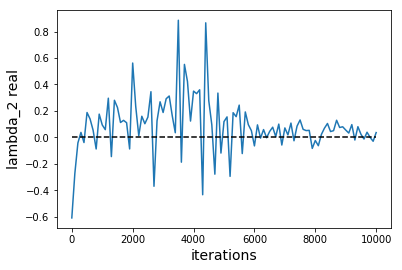

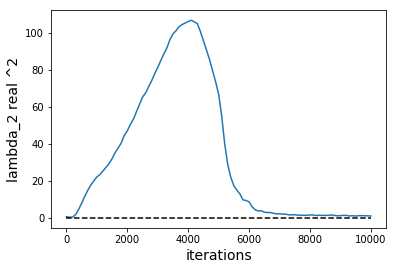

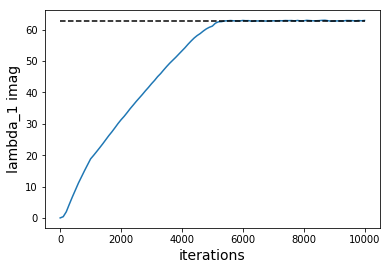

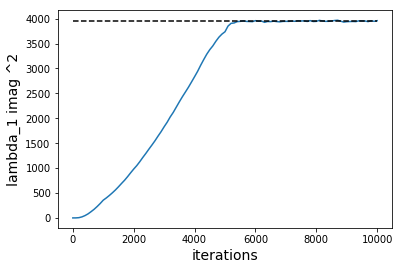

In [48]:
num_suff_stats = T_xs.shape[1];
constraint_names = ['lambda_1 real', 'lambda_1 real ^2', \
                    'lambda_2 real', 'lambda_2 real ^2', \
                    'lambda_1 imag', 'lambda_1 imag ^2'];
for i in range(num_suff_stats):
    plt.figure();
    plt.plot(iterations, T_xs[:,i]);
    plt.plot([iterations[0], iterations[-1]], [mu[i], mu[i]], 'k--');
    plt.xlabel('iterations', fontsize=fontsize);
    plt.ylabel(constraint_names[i], fontsize=fontsize);
    plt.show();
plt.show();

In [38]:
T_xs = npzfile['T_xs'];
cs = npzfile['cs'];
lambdas = npzfile['lambdas'];
phis = npzfile['phis'];
log_q_xs = npzfile['log_q_xs'];
tr_hess = npzfile['trace_hessian']

zero_inds = np.where(phis[:,0,0] == 0.0)[0];
if (len(zero_inds) > 0):
    last_ind = zero_inds[0]-1;
else:
    last_ind = phis.shape[0]-1;
print(last_ind);

9


(10, 1000, 4)
(10, 1000)
(10, 1000)


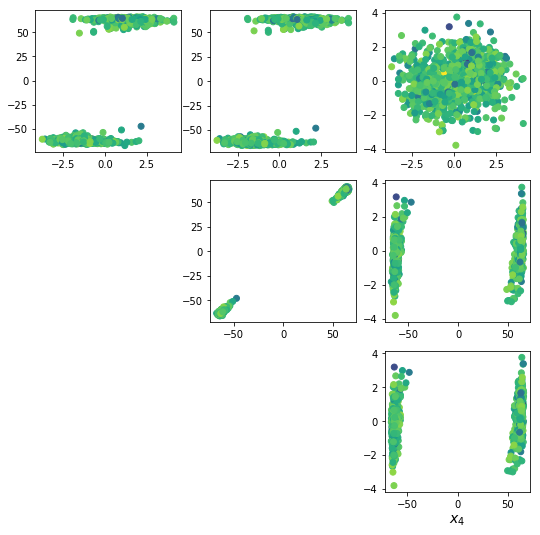

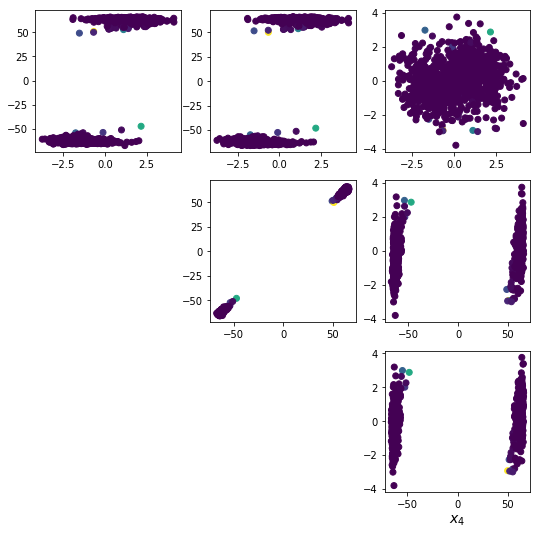

In [39]:
print(phis.shape);
print(tr_hess.shape);
print(log_q_xs.shape);
figsize = (12, 12);
plt.figure(figsize=figsize);
for i in range(system.D):
    for j in range(i+1, system.D):
        ind = system.D*i + j + 1;
        plt.subplot(system.D, system.D, ind);
        plt.scatter(phis[last_ind,:,i], phis[last_ind, :, j], c=log_q_xs[last_ind]);
    if (i==(system.D-1)):
        plt.xlabel(r'$x_%d$' % (j+1), fontsize=fontsize);
plt.show();


plt.figure(figsize=figsize);
for i in range(system.D):
    for j in range(i+1, system.D):
        ind = system.D*i + j + 1;
        plt.subplot(system.D, system.D, ind);
        plt.scatter(phis[last_ind,:,i], phis[last_ind, :, j], c=tr_hess[last_ind]);
    if (i==(system.D-1)):
        plt.xlabel(r'$x_%d$' % (j+1), fontsize=fontsize);
plt.show();